# Use case 1: How are people reacting to the new COVID-19 strain?
`You are working as a Data Scientist for the Ministry of Health and Family Welfare`

**The government wants to learn the public sentiment on the new strain of COVID-19**

- When a new strain is detected, people might suddenly panic, so they might start hoarding essential supplies.
- The government wants to prepare well and warn people about the new strain.

## How can we learn the public sentiment?
- Do surveys? - But that is too slow.
- Check what people are saying on Social Media.

## Using Twitter for public sentiment
We can utilize Twitter feed to carry out the sentimental analysis.

> **Since most tweets are textual, we'll need to process this textual data to learn whether the general sentiment is positive or negative. - Aka : Sentiment Analysis**

**Note:** Sentiment Analysis is the process of categorizing opinions expressed in a text, primarily to determine whether the author's attitude towards a particular topic is Positive or Negative.

## How will Sentiment Analysis help?
1.  We can gauge the spread of the virus and the severity of it.
2.  Govt. will be able educate people and avoid misinformation.






---
## 1.1 Understanding the Dataset
---

1.  Dataset source: kaggle covid tweets [link](https://www.kaggle.com/datatattle/covid-19-nlp-text-classification)
2.  Total 11,663 tweets with positive and negative labels

In [ ]:
import os
import re
import random
import string      # for string operations
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
import plotly.express as px
# SetUp NLTK
!pip install --user -U nltk
import nltk
nltk.download('punkt')


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [ ]:
!gdown 11LWo5nagSmC72hOJM9lm2l05sdQxt4rf

Downloading...
From: https://drive.google.com/uc?id=11LWo5nagSmC72hOJM9lm2l05sdQxt4rf
To: /content/corona_tweets.csv
100% 1.00M/1.00M [00:00<00:00, 140MB/s]


In [ ]:
dataframe = pd.read_csv("./corona_tweets.csv")
dataframe.head()

,UserName,ScreenName,Location,TweetAt,OriginalTweet,Sentiment
0,1,44953,NYC,02-03-2020,TRENDING: New Yorkers encounter empty supermar...,Extremely Negative
1,2,44954,"Seattle, WA",02-03-2020,When I couldn't find hand sanitizer at Fred Me...,Positive
2,3,44955,NaN,02-03-2020,Find out how you can protect yourself and love...,Extremely Positive
3,4,44956,Chicagoland,02-03-2020,#Panic buying hits #NewYork City as anxious sh...,Negative
4,5,44957,"Melbourne, Victoria",03-03-2020,#toiletpaper #dunnypaper #coronavirus #coronav...,Neutral


### Exploring the labels

In [ ]:
fig = px.pie(dataframe, names='Sentiment',hole=0.3, title='Sentiment Pie Chart')
fig.show()

Labels in the dataset:  ['Extremely Negative' 'Positive' 'Extremely Positive' 'Negative' 'Neutral']
Negative              1041
Positive               947
Neutral                619
Extremely Positive     599
Extremely Negative     592
Name: Sentiment, dtype: int64


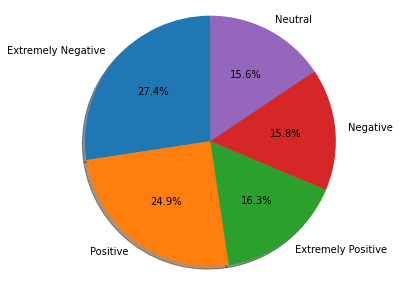

In [ ]:
# Check tweets distribution
def pie_chart(dataframe):
  # Converting pd object to list of string
  label_types  = dataframe.Sentiment.unique().astype(str)
  # Count tweets for each label
  label_counts = dataframe.Sentiment.value_counts()
  print('Labels in the dataset: ', label_types)
  print(label_counts)
  # labels for the two classes
  labels = label_types #'Positives', 'Negative'
  # Sizes for each slide
  sizes = [count for count in label_counts]
  # Declare a figure with a custom size
  fig = plt.figure(figsize=(5, 5))
  # Declare pie chart, where the slices will be ordered and plotted counter-clockwise:
  plt.pie(sizes, labels=labels, autopct='%1.1f%%',
          shadow=True, startangle=90)
  # Equal aspect ratio ensures that pie is drawn as a circle.
  plt.axis('equal')
  # Display the chart
  plt.show()

pie_chart(dataframe)

In [ ]:
dataframe[dataframe['Sentiment'] == 'Negative']['OriginalTweet'].shape

(1041,)

### Splitting the dataset into training and testing


In [ ]:
# Separating positive_tweets and negative_tweets
all_positive_tweets = list(dataframe[dataframe['Sentiment'] == 'Positive']['OriginalTweet'].astype(str)) # Making equal positive and negative tweet counts
all_negative_tweets = list(dataframe[dataframe['Sentiment'] == 'Negative']['OriginalTweet'].astype(str))[:947]

# Splitting training and testing set. 80/20 split
positive_train, positive_test = train_test_split(all_positive_tweets, test_size=0.2, random_state=42)
negative_train, negative_test = train_test_split(all_negative_tweets, test_size=0.2, random_state=42)

print("Size of training dataset: ",len(positive_train) + len(negative_train))
print("Size of testing dataset: ", len(positive_test)  + len(negative_test))

# print positive in green
print('\033[92m' + '\npositive in green: ')
print('\033[92m' + all_positive_tweets[random.randint(0,947)])
print('\033[91m' + '\nnegative in red: ')
# print negative in red
print('\033[91m' + all_negative_tweets[random.randint(0,947)])

Size of training dataset:  1514
Size of testing dataset:  380

positive in green: 
Folks that are ordering extra groceries Please consider your local food banks People with food insecurity don t have the ability to  order extra  or stock up They need our help 19

negative in red: 
Wrong attitude: Canadian Couple Made Over $70,000 Reselling Lysol Wipes on Amazon at Inflated Prices #SmartNews #Covid_19 #coronavirus  https://t.co/s3BUavIajB


## 1.2 How can a machine understand a tweet?


* Yes by recognizing the words that constitute a string of characters before processing a natural language.

* Meaning of the text could be interpreted by analyzing the words.


> **This is where tokenization is essential to proceed with NLP (text data), which is used to break down the text into tokens (words).**






### What is tokenization?


* Word tokenization: split large text samples into words.



In [ ]:
# Split on spaces
tweet = all_positive_tweets[12]
word = tweet.split() # space tokenizer
print('Using Split :',word)


Using Split : ['Consumers', 'have', 'increased', 'their', 'online', 'shopping', 'due', 'to', 'coronavirus.', 'https://t.co/5mYfz3RAD0', '#retail', '#ecommerce', '#study', '#coronavirus', 'https://t.co/Dz3H6zrWUT']


**Note:**  split() does not consider punctuation as a separate token

### What is a regular expression and what makes it so important?


* A regular expression is a notation to represent standards in strings.

* Series of characters that define an abstract search pattern.

* It serves to search and extract information in texts.

Regex is used in Google analytics in URL matching in supporting search and replaced in most popular editors like Sublime, Notepad++, Google Docs, and Microsoft Word.

```
Example :  Regular expression for an email address :
         ^([a-zA-Z0-9_\-\.]+)@([a-zA-Z0-9_\-\.]+)\.([a-zA-Z]{2,5})$
```
The above regular expression is used for checking if a given set of characters is an email address or not.


<details>
<summary>
    <font size="4" color=""><b>How to write regular expression?</b></font>
</summary>
<p>
<ol>
<li>
    
Repeaters : *, + and { } symbols act as repeaters and tell the computer that the preceding character is to be used for more than just one time.

* The asterisk symbol ( * ): to match the preceding character (or set of characters) for 0 or more times (up to infinite).

* The Plus symbol ( + ): to repeat the preceding character (or set of characters) for at least one or more times(up to infinite).

* The curly braces {…}: to repeat the preceding character (or set of characters) as many times as the value inside this bracket.

</li>

<li>

Character Classes: matches any one of a set of characters. It is used to match the most basic element of a language like a letter, a digit, space, a symbol, etc.

* /s : matches any whitespace characters such as space and tab
* /S : matches any non-whitespace characters
* /d : matches any digit character
* /D : matches any non-digit characters
* /w : matches any word character (basically alpha-numeric)
* /W : matches any non-word character
* /b : matches any word boundary (this would include spaces, dashes, commas, semi-colons, etc)

</li>

<li>
Wildcard – ( . ): The dot symbol can take place of any other symbol.

</li>

<li>
Optional character – ( ? ): tells the computer that the preceding character may or may not be present in the string to be matched.

</li>

<li>
The caret ( ^ ) : tells the computer that the match must start at the beginning of the string or line.

</li>

<li>
The dollar ( $ ) tells the computer that the match must occur at the end of the string or before \n at the end of the line or string.

</li>

</ol>
</p>
</details>

Read More: [Link1](https://buildregex.com/), [Link2](https://regexr.com/), [regex-quickstart](http://www.rexegg.com/regex-quickstart.html), [How to write regular expression?](https://www.geeksforgeeks.org/write-regular-expressions/)






In [ ]:
# Using 're' library to work with regular expression.

tokens = re.findall("[\w']+", tweet)
print('Using regexes :',tokens)

Using regexes : ['Consumers', 'have', 'increased', 'their', 'online', 'shopping', 'due', 'to', 'coronavirus', 'https', 't', 'co', '5mYfz3RAD0', 'retail', 'ecommerce', 'study', 'coronavirus', 'https', 't', 'co', 'Dz3H6zrWUT']


* The function **re.findall()** finds all the words that match the pattern passed and stores them in the list.

* The **“\w”** represents:  “any word character,” which usually means alphanumeric (letters, numbers) and underscore (_).

* **‘+’** means any number of times.

* **[\w’]+** signals that the function should find all the alphanumeric characters until any other character is encountered.

### Python already has modules for collecting, handling, and processing text data.


> **Using Natural Language Toolkit (NLTK) package.**



* NLTK contains a module called `tokenize`, which has the `word_tokenize()` method to split a sentence into tokens.

In [ ]:
from nltk.tokenize import word_tokenize

words = word_tokenize(tweet)
print('Using NLTK :',words)

Using NLTK : ['Consumers', 'have', 'increased', 'their', 'online', 'shopping', 'due', 'to', 'coronavirus', '.', 'https', ':', '//t.co/5mYfz3RAD0', '#', 'retail', '#', 'ecommerce', '#', 'study', '#', 'coronavirus', 'https', ':', '//t.co/Dz3H6zrWUT']


**Note:** `word_tokenize()` is considering punctuation as a token. Hence we need to remove the punctuations from the initial list.



### How to tokenize into a Sentence?



*   A sentence usually ends with a full stop `.`, so we can use `.` as a separator to break the string:



In [ ]:
# Splits at '.'
splits = tweet.split('. ')
print('Using Splits :',splits)
# Using Regular Expressions (RegEx)
sentence_splits = re.compile('[.!?] ').split(tweet)
print('Using regexes :',sentence_splits)

Using Splits : ['Consumers have increased their online shopping due to coronavirus', 'https://t.co/5mYfz3RAD0 #retail #ecommerce #study #coronavirus https://t.co/Dz3H6zrWUT']
Using regexes : ['Consumers have increased their online shopping due to coronavirus', 'https://t.co/5mYfz3RAD0 #retail #ecommerce #study #coronavirus https://t.co/Dz3H6zrWUT']


**Note:** a drawback of using Python’s `split()` method is that we can use only one separator at a time.





*   Using RegEx, we have an edge over the split() method as we can pass multiple separators simultaneously.
* We used the re.compile() function in the above code wherein we passed [.?!]. It means that sentences will split as soon as any of these characters are encountered.



<details>
<summary>
    <font size="5" color=""><b>Python split() VS nltk sent_tokenize</b></font>
</summary>
<p>

**Cosider an example:**

```
eg_sentence = "Dr. A. P. J. Abdul Kalam was the Former President of India and a world-renowned Space Scientist."

Using split :
['Dr', 'A', 'P', 'J', 'Abdul Kalam was the Former President of India and a world-renowned Space Scientist']

Using NLTK sent_tokenize:
['Dr. A. P. J. Abdul Kalam was the Former President of India and a world-renowned Space Scientist.']
```

<ol>
<li>  
Here, the python split() function made the mistake of tokenizing the name.
</li>

<li>  
To properly tokenize such function we require a sequence of RegEx functions.
</li>

<li>  
NLTK has pre-defined functions to handle such conditions.
</li>
</ol>
</p>
</details>





In [ ]:
# Using NLTK
from nltk.tokenize import sent_tokenize
sentence_splits = sent_tokenize(tweet)
print('Using NLTK :',sentence_splits)

Using NLTK : ['Consumers have increased their online shopping due to coronavirus.', 'https://t.co/5mYfz3RAD0 #retail #ecommerce #study #coronavirus https://t.co/Dz3H6zrWUT']


**Note:** A lot of unnecessary words like hashtags, hyperlinks are also tokenized.

## 1.3 Can we reduce dataset size?

<!-- Do we need hashtags and hyperlinks for analyzing the tweets? -->

<!-- ### What kind of textual data can we remove from the tweets? -->
### What are the unwanted textual data?

<details>
<summary>
    <font size="3" color=""><b>Answer</b></font>
</summary>
<p>
<ol>
    <li>Remove hashtags and hyperlinks before tokenization.</li>
    <li>Remove stopwords and punctuations.</li>
    
</ol>
</p>








In [ ]:
import nltk                                # Python library for NLP
from nltk.corpus import twitter_samples    # sample Twitter dataset from NLTK
from nltk.corpus import stopwords          # module for stop words that come with NLTK
from nltk.stem import PorterStemmer        # module for stemming
from nltk.stem import WordNetLemmatizer    # module for Lemmatization

from nltk.tokenize import TweetTokenizer
nltk.download('wordnet')
nltk.download('omw-1.4')

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...


True

In [ ]:
# Our selected sample. Complex enough to exemplify each step
tweet = all_positive_tweets[12]
tweet

'Consumers have increased their online shopping due to coronavirus. https://t.co/5mYfz3RAD0 #retail #ecommerce #study #coronavirus https://t.co/Dz3H6zrWUT'

In [ ]:
# Removing hyperlinks and hashtags

print('\033[92m' + tweet)
print('\033[94m')

# remove old style retweet text "RT"
tweet2 = re.sub(r'^RT[\s]+', '', tweet)

# remove hyperlinks
tweet2 = re.sub(r'https?://[^\s\n\r]+', '', tweet2)

# remove hashtags
# only removing the hash # sign from the word
tweet2 = re.sub(r'#', '', tweet2)
print(tweet2)

Consumers have increased their online shopping due to coronavirus. https://t.co/5mYfz3RAD0 #retail #ecommerce #study #coronavirus https://t.co/Dz3H6zrWUT

Consumers have increased their online shopping due to coronavirus.  retail ecommerce study coronavirus 


In [ ]:
# Tokenizing

print()
print('\033[92m' + tweet2)
print('\033[94m')

# instantiate tokenizer class
tokenizer = TweetTokenizer(preserve_case=False, strip_handles=True,
                               reduce_len=True)

# tokenize tweets
tweet_tokens = tokenizer.tokenize(tweet2)

print()
print('Tokenized string:')
print(tweet_tokens)


Consumers have increased their online shopping due to coronavirus.  retail ecommerce study coronavirus 


Tokenized string:
['consumers', 'have', 'increased', 'their', 'online', 'shopping', 'due', 'to', 'coronavirus', '.', 'retail', 'ecommerce', 'study', 'coronavirus']


In [ ]:
# Import the english stop words list from NLTK
nltk.download("stopwords")
stopwords_english = stopwords.words('english')

print('Stop words\n')
print(stopwords_english)

print('\nPunctuation\n')
print(string.punctuation)

Stop words

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:
print()
print('\033[92m')
print(tweet_tokens)
print('\033[94m')

tweets_clean = []

for word in tweet_tokens: # Go through every word in your tokens list
    if (word not in stopwords_english and  # remove stopwords
        word not in string.punctuation):  # remove punctuation
        tweets_clean.append(word)

print('removed stop words and punctuation:')
print(tweets_clean)



['consumers', 'have', 'increased', 'their', 'online', 'shopping', 'due', 'to', 'coronavirus', '.', 'retail', 'ecommerce', 'study', 'coronavirus']

removed stop words and punctuation:
['consumers', 'increased', 'online', 'shopping', 'due', 'coronavirus', 'retail', 'ecommerce', 'study', 'coronavirus']


### Are there different words that mean the same?

Stemming & Lemmatization are different word normalization techniques, that helps us convert the inflection words into the base forms.

For example -



> *have, having, had      --> have*

> *playing, plays, played --> play*

> *good, better, best     --> good*



<details>
<summary>
    <font size="4" color=""><b>Why is it important to convert inflection words to the base forms? </b></font>
</summary>
<p>
<ul>
    <li>There are scenarios, where different forms of a word conveys related meaning.</li>
    <li>Example "toy" and "toys" have identical meaning. In a search engine, the objective between a search for "toy" and a search for "toys" is probably the same.</li>
    <li>Different ways of writing the same word causes various problems in understanding queries.</li>
    <li>Converting inflection words to the base words is a common practice in NLP domain.</li>
</ul>
</p>
</details>


In [ ]:
print()
print('\033[92m')
print(tweets_clean)
print('\033[94m')

# Instantiate stemming class
stemmer = PorterStemmer()

# Create an empty list to store the stems
tweets_stem = []

for word in tweets_clean:
    stem_word = stemmer.stem(word)  # stemming word
    tweets_stem.append(stem_word)  # append to the list

print('stemmed words:')
print(tweets_stem)



['consumers', 'increased', 'online', 'shopping', 'due', 'coronavirus', 'retail', 'ecommerce', 'study', 'coronavirus']

stemmed words:
['consum', 'increas', 'onlin', 'shop', 'due', 'coronaviru', 'retail', 'ecommerc', 'studi', 'coronaviru']


### Revise
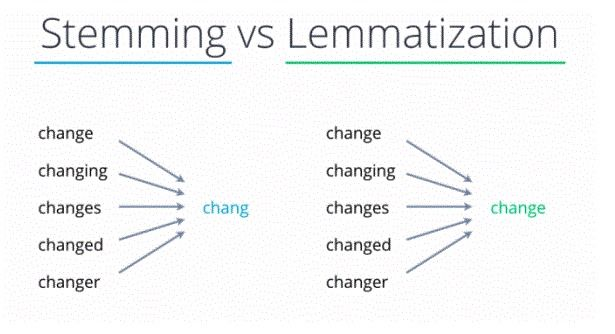
<details>
<summary>
    <font size="3" color=""><b>Lemmatization</b></font>
</summary>
<p>
<ul>
    <li>Lemmatization reduces the words properly such that the reduced word also belongs to the language.</li>
    <li>The output of lemmatization is the root lemma and not the root stem (as in stemming).</li>
    <li>Example:  'runs', 'running', 'ran' are all formed from the same word 'run' hence their lemma is 'run'. </li>
</ul>
</p>
</details>

<details>
<summary>
    <font size="3" color=""><b>Stemming VS Lemmatization</b></font>
</summary>
<p>
<ul>
    <li>Stemming does not generate actual words where as lemmatization does generate actual words.</li>
    <li>Stemming is a rule based technique and is applied step by step on words without any additional context, it is much faster as compared to lemmatization which needs the entire text or POS tag to generate the root lemma correctly.</li>
    <li>If you need speed then stemming can be preffered else lemmatization is better in most cases.</li>
</ul>
</p>
</details>



### Putting everything together




1.   Remove hyperlinks, hashtags etc.
2.   Tokenizing
3.   Remove stopwords and punctuation
4.   Stemming




In [ ]:
def process_tweet(tweet):
    lemmatizer = WordNetLemmatizer()
    stopwords_english = stopwords.words('english')
    # remove stock market tickers like $GE
    tweet = re.sub(r'\$\w*', '', tweet)
    # remove old style retweet text "RT"
    tweet = re.sub(r'^RT[\s]+', '', tweet)
    # remove hyperlinks
    tweet = re.sub(r'https?://[^\s\n\r]+', '', tweet)
    # remove hashtags
    # only removing the hash # sign from the word
    tweet = re.sub(r'#', '', tweet)
    # tokenize tweets
    tokenizer = TweetTokenizer(preserve_case=False, strip_handles=True,
                               reduce_len=True)
    tweet_tokens = tokenizer.tokenize(tweet)

    tweets_clean = []
    for word in tweet_tokens:
        if (word not in stopwords_english and  # remove stopwords
                word not in string.punctuation):  # remove punctuation
            # tweets_clean.append(word)
            lemma_word = lemmatizer.lemmatize(word)  # stemming word
            tweets_clean.append(lemma_word)

    return tweets_clean

In [ ]:
# choose the same tweet
tweet = all_positive_tweets[12]

print()
print('\033[92m')
print(tweet)
print('\033[94m')

# call the imported function
tweets_stem = process_tweet(tweet); # Preprocess a given tweet

print('preprocessed tweet:')
print(tweets_stem) # Print the result



Consumers have increased their online shopping due to coronavirus. https://t.co/5mYfz3RAD0 #retail #ecommerce #study #coronavirus https://t.co/Dz3H6zrWUT

preprocessed tweet:
['consumer', 'increased', 'online', 'shopping', 'due', 'coronavirus', 'retail', 'ecommerce', 'study', 'coronavirus']


## 1.4  How to use preprocessed tweet to train a model?

In order to do so, build a vocabulary that will be used to encode any text or tweet as an array of numbers.




## How do you represent text in NLP?
Sparse representation (Representing a text as a vector)

1.  Picture a list of tweets. Then your vocabulary, V, would be the list of unique words from your list of tweets.

2.  To get that list, you will have to go through all the words from the tweets and save every new word that appears in the search.

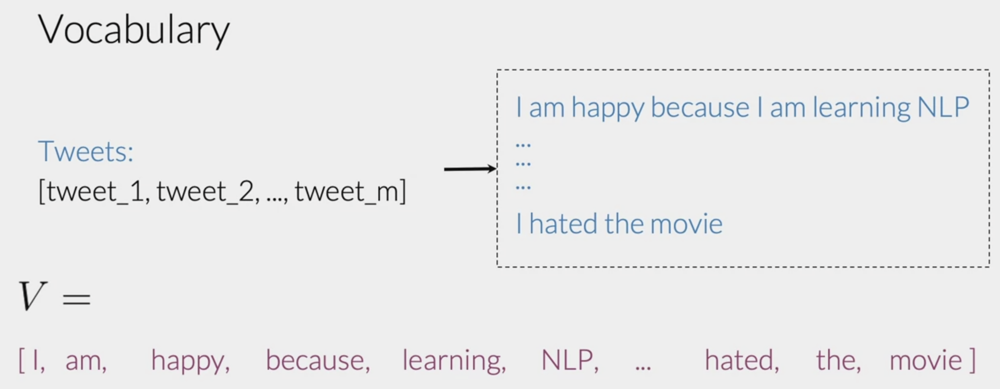

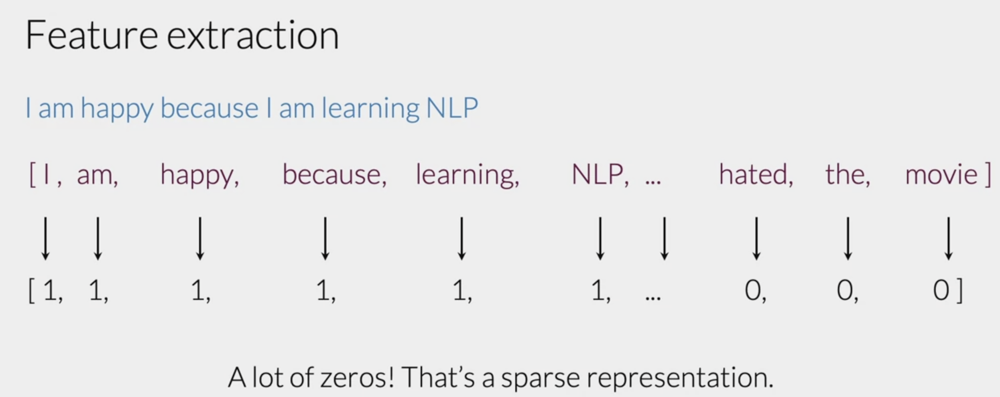

Drawbacks of sparse representation


1.   A lot of features are equal to 0.
2.   Logistic regression model would have to learn `n + 1` parameters, where `n = size of the vocabulary`
3.   For large vocabulary sizes, this would be problematic.






What problems will it cause?

<details>
<summary>
    <font size="3" color=""><b>Answers</b></font>
</summary>
<p>
<ol>
    <li>Excessive amount of time to train a model and more time to make predictions.</li>
    
</ol>
</p>


### Instructors Note (ask this questions) :
- Can we use BOW + PCA to overcome sparsity of input vectors ?
- If we are using BOW lets assume there will be 2000 data points and 10000 dimensional data. How can we make BOW + logistic regression effective ?


## 1.5 How can we reduce the dimension?


*  Previously, the word vector was of dimension `V`. Now, we will represent it with a vector of dimension `3`

*  To do so, create a dictionary to map the word, and the class it appeared in (positive or negative) to the number of times that word appeared in its corresponding class.

*  We call this dictionary `freqs`

*  ```feature vector of a tweet m = [ Bias, sum of positive frequency, sum of negative frequency]```

Frequency Dictionary:

Text represented as a vector of dimension 3.



### Build Frequency Dictionary:

In [ ]:
def build_freqs(tweets, ys):
    """
        tweets: a list of tweets
        ys: an m x 1 array with the sentiment label of each tweet
            (either 0 or 1)
        freqs: a dictionary mapping each (word, sentiment) pair (=key) to its frequency (=value)
    """
    # Convert np array to list since zip needs an iterable.
    # The squeeze is necessary or the list ends up with one element.
    # Also note that this is just a NOP if ys is already a list.
    yslist = np.squeeze(ys).tolist()

    # Start with an empty dictionary and populate it by looping over all tweets
    # and over all processed words in each tweet.
    freqs = {}
    for y, tweet in zip(yslist, tweets):
        for word in process_tweet(tweet):
            pair = (word, y)
            if pair in freqs:
                freqs[pair] += 1
            else:
                freqs[pair] = 1

    return freqs

In [ ]:
training_tweets = positive_train + negative_train
# make a numpy array representing labels of the tweets
labels = np.append(np.ones((len(positive_train))), np.zeros((len(negative_train))))

In [ ]:
# create frequency dictionary
freqs = build_freqs(training_tweets, labels)

# check data type
print(f'type(freqs) = {type(freqs)}')

# check length of the dictionary
print(f'len(freqs) = {len(freqs)}')

type(freqs) = <class 'dict'>
len(freqs) = 7985


### Extracting features from Frequency Dictionary.
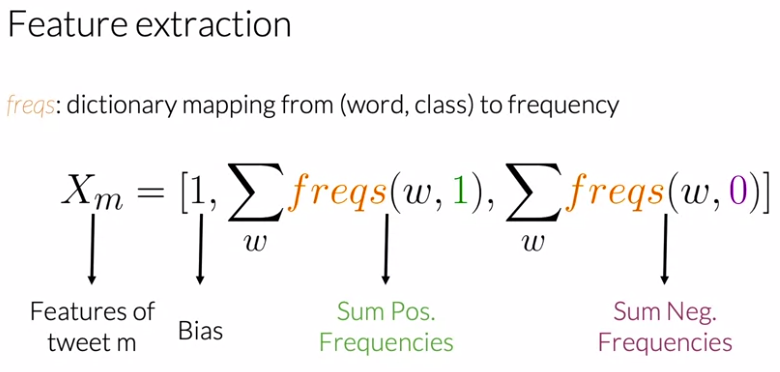

In [ ]:
# select some words to appear in the report.
keys = ['void', 'commun', 'spirit', 'stop', 'merri', 'nice', 'good', 'bad', 'sad', 'mad', 'best', 'pretti',
        ':)', ':(', 'song', 'idea', 'power', 'play']

# list representing our table of word counts.
# each element consist of a sublist with this pattern: [<word>, <positive_count>, <negative_count>]
data = []

# loop through our selected words
for word in keys:

    # initialize positive and negative counts
    pos = 0
    neg = 0

    # retrieve number of positive counts
    if (word, 1) in freqs:
        pos = freqs[(word, 1)]

    # retrieve number of negative counts
    if (word, 0) in freqs:
        neg = freqs[(word, 0)]

    # append the word counts to the table
    data.append([word, pos, neg])

data

[['void', 1, 0],
 ['commun', 0, 0],
 ['spirit', 1, 2],
 ['stop', 11, 23],
 ['merri', 0, 0],
 ['nice', 6, 6],
 ['good', 49, 28],
 ['bad', 1, 8],
 ['sad', 0, 5],
 ['mad', 1, 4],
 ['best', 7, 3],
 ['pretti', 0, 0],
 [':)', 1, 1],
 [':(', 3, 0],
 ['song', 2, 0],
 ['idea', 6, 8],
 ['power', 3, 0],
 ['play', 4, 1]]

In [ ]:
# df = pd.DataFrame(data, columns =['Word', 'pos_log', 'neg_log'])
# df['pos_log'] = np.log(df['pos_log']+1)
# df['neg_log'] = np.log(df['neg_log']+1)
# df

In [ ]:
# fig = px.scatter(df, x="pos_log", y="neg_log", hover_data=['Word'])
# fig.show()

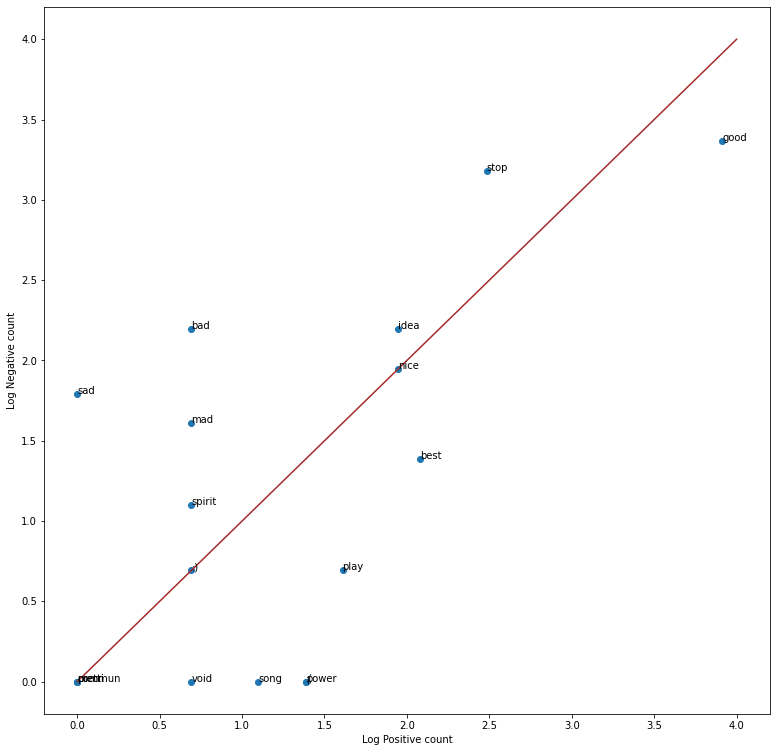

In [ ]:
fig, ax = plt.subplots(figsize = (13, 13))

# convert positive raw counts to logarithmic scale. we add 1 to avoid log(0)
x = np.log([x[1] + 1 for x in data])

# do the same for the negative counts
y = np.log([x[2] + 1 for x in data])

# Plot a dot for each pair of words
ax.scatter(x, y)

# assign axis labels
plt.xlabel("Log Positive count")
plt.ylabel("Log Negative count")

# Add the word as the label at the same position as you added the points just before
for i in range(0, len(data)):
    ax.annotate(data[i][0], (x[i], y[i]), fontsize=10)

ax.plot([0, 4], [0, 4], color = 'brown') # Plot the red line that divides the 2 areas.
plt.show()

### Log Positive Count VS Log Negative Count
- This is the scatter chart to show which occur more on the positive sentiment and which word occur more on the negative sentiment.<br>
- We have positive and negative counts of words and to scale it we have done log operation in the counts. The brown line is not a classifier. It is a 45 degree straight line.<br>
- The words lying below the line have more positive sentiment and the words lying above it has more negative sentiment.



### BOW VS Rule-based NLP methods
In Rule based NLP method lets assume we have made a dictionary of all positive and negative words and give some score to each word and using this dictionary we will classify a tweet whether it is a positive or negative tweet.

#### Can we generalize this idea using BOW + Logistic Regression ? (ask learners)

- So in the BOW we make sparse vector for each data point and in this sparse vector words from the corpus which are present in the data point have value 1 and rest 0
- So when we apply Logistic Regression then at the end of the training we can say the weights saved is like the manual score given to the each word(here we are not saying both are same as obviously dimensions are different)
- So rather than having fixed value score of each word, neural network will calculate the best weight dynamically according to the corpus and data points.

### Extracting features function.

In [ ]:
def extract_features(tweet, freqs):
    '''
        tweet: a list of words for one tweet
        freqs: a dictionary corresponding to the frequencies of each tuple (word, label)
        x: a feature vector of dimension (1,3)
    '''
    # process_tweet tokenizes, stems, and removes stopwords
    word_l = process_tweet(tweet)
    # 3 elements in the form of a 1 x 3 vector
    x = np.zeros((1, 3))

    #bias term is set to 1
    x[0,0] = 1

    # loop through each word in the list of words
    for word in word_l:

        # increment the word count for the positive label 1
        x[0,1] += freqs.get((word, 1.0),0)

        # increment the word count for the negative label 0
        x[0,2] += freqs.get((word, 0.0),0)

    assert(x.shape == (1, 3))
    return x

### Example 1: feature extraction for a tweet

In [ ]:
train_x = training_tweets
tmp1 = extract_features(train_x[0], freqs)
print(tmp1)

[[1.00e+00 2.26e+03 2.44e+03]]


### Example 2: feature extraction for a random string

In [ ]:
tmp2 = extract_features('This batch is the best batch', freqs)
print(tmp2)

[[ 1. 11.  3.]]


### Preparing training data

In [ ]:
# collect the features 'x' and stack them into a matrix 'X'
X = np.zeros((len(train_x), 3))
for i in range(len(train_x)):
    X[i, :]= extract_features(train_x[i], freqs)

# training labels corresponding to X
train_y = np.append(np.ones((len(positive_train), 1)), np.zeros((len(negative_train), 1)), axis=0)
Y = np.ravel(train_y,order='C')



## 1.6 Using the most basic model to classify




<details>
<summary>
    <font size="3" color=""><b>Answer</b></font>
</summary>
<p>
<ul>
    <li>Logistic Regression.</li>
</ul>
</p>

In [ ]:
from sklearn.linear_model import LogisticRegression
clf = LogisticRegression().fit(X, Y)

print("Training Accuracy: ",clf.score(X, Y))

Training Accuracy:  0.6743725231175693


Logistic Regression with L1 Regularization

In [ ]:
from sklearn.linear_model import LogisticRegression
clf = LogisticRegression(C = 0.1,solver= 'saga', penalty= 'l1', max_iter = 500).fit(X, Y)

print("Training Accuracy: ",clf.score(X, Y))

Training Accuracy:  0.6829590488771466


Official Documentation: [Here](https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LogisticRegression.html)

**Solver:** It is an algorithm to use in optimization problem.

- For small datasets, ‘liblinear’ is a good choice, whereas ‘sag’ and ‘saga’ are faster for large ones;

- For multiclass problems, only ‘newton-cg’, ‘sag’, ‘saga’ and ‘lbfgs’ handle multinomial loss;

- ‘liblinear’ is limited to one-versus-rest schemes.

- L1 penalty is only possible with 'saga' and 'liblinear' solver

- ‘sag’ and ‘saga’ fast convergence is only guaranteed on features with approximately the same scale.

**Penalty:** We can add 'l1', 'l2', 'elasticnet' regularization term to the problem.

**C:** It is an inverse of Regularization Strength.



### Check performance on test set

In [ ]:
# Testing
testing_tweets = positive_test + negative_test

test_X = np.zeros((len(testing_tweets), 3))
for i in range(len(testing_tweets)):
    test_X[i, :]= extract_features(testing_tweets[i], freqs)

# training labels corresponding to X
test_y = np.append(np.ones((len(positive_test), 1)), np.zeros((len(negative_test), 1)), axis=0)
test_Y = np.ravel(test_y,order='C')

print("Testing Accuracy: ",clf.score(test_X, test_Y))

Testing Accuracy:  0.5789473684210527


### Predict whether a tweet is positive or negative.

**Note:** classify 1, for a positive sentiment, and 0, for a negative sentiment.

In [ ]:
def predict_custom_tweet(tweet, freqs):
    x = extract_features(tweet,freqs)
    y_pred = clf.predict(x)
    return y_pred

# test your function
list_of_tweets = ['\033[92m'+'Thank God coronovirus is over',
                  '\033[91m'+'This is seriously ridiculous. Stop hoarding',
                  '\033[92m'+'Government efforts are great.',
                  '\033[93m'+'Nonsense', #anomaly in classification
                  '\033[91m'+'Panic-buying is pushing up prices.#coronavirus',
                  '\033[92m'+'THANK YOU to make hand sanitizer in distillery amid outbreak']

for tweet in list_of_tweets:
    print( '%s -> %f' % (tweet, predict_custom_tweet(tweet, freqs)))

Thank God coronovirus is over -> 1.000000
This is seriously ridiculous. Stop hoarding -> 0.000000
Government efforts are great. -> 1.000000
Nonsense -> 1.000000
Panic-buying is pushing up prices.#coronavirus -> 0.000000
THANK YOU to make hand sanitizer in distillery amid outbreak -> 1.000000


## Content


- **Introduction to Business case : Data Scientist at Medium.**


- **Exploratory Data Analysis**
  - Mean reading time vs article length
  - Authors vs article topics

- **Data Preprocessing**
  - Word Contractions

- **How do we represent text as numbers ?**
  - One-Hot Encoding

- **Optimization on One Hot Encoding**
    - Sparse vectors
    - Bag of Words
    - TF - IDF
        
    

- **Euclidean distance vs Cosine Similarity**  
       

- **How will we find similarity between documents**
  - BOW
  - TF-IDF
  
- **How do we visualize the features?**
  - T-SNE

- **Extra Material**
  - TF-IDF: Smoothened IDF
  - TF-IDF: Max IDF

    





# Use case 2: Finding similar Medium articles
`You are working as a Data Scientist at Medium`

* [Medium](https://medium.com/@Arun_Gautham_Soundarrajan/nlp-basics-text-representation-and-similarity-649c05c8d6a3) is an online publishing platform which hosts a hybrid collection of blog posts from both amateur and professional people and publications.
* In 2020, about 47,000 articles were published daily on the plaform and it had about 200M visitors every month.

**Problem Statement:**
- You want to give readers a better reading experience at Medium. To do that, you want to `recommend articles to the user on the basis of current article` that the user is reading.

- **More concretely, given a Medium article find a set of similar articles.**  



#### How would a human find similar articles in a corpus ?
1. Look at the title - find similar titles.
2. Find articles by the same author.
3. Go through the text, understand it and group the aricles within broader topics.

## Let's have a look at the data

#### What data are we going to use ?

1. Each article in Medium has a title, article text and author associated with it. To begin with, this data should be sufficient to understand the articles and to find similar articles.

2. The user might like articles which belong the same topic -

* **For example:** if a user is reading an article on Neural Networks, he/she might be interested in a similar article which talks about Convolutional Neural Netwroks (both of these aticles belong to a broader domain of Deep Learning).

#### How do we get this data ?

* Well, we can scrape it from Medium (scrapping is covered later in the track).
* We've done that already.
* We have a collection of medium articles with it's title, subtitle, author, reading time, text and the link of that article.

In [ ]:
# libraries to display dataframe and images
from IPython.display import display
from PIL import Image
# matplotlib for vizualization
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
# inbuild library to work with textual data
import string
# Setting up the NLTK to pre-processing textual data
import nltk
from nltk.corpus import stopwords, wordnet
from nltk.stem import PorterStemmer, LancasterStemmer, SnowballStemmer, WordNetLemmatizer
from nltk.tokenize import word_tokenize, sent_tokenize
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('averaged_perceptron_tagger')
nltk.download('tagsets')
nltk.download('universal_tagset')
nltk.download('treebank')

sns.set_theme(style="darkgrid")
pd.set_option("display.max_columns", 100)
%matplotlib inline

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data] Downloading package tagsets to /root/nltk_data...
[nltk_data]   Unzipping help/tagsets.zip.
[nltk_data] Downloading package universal_tagset to /root/nltk_data...
[nltk_data]   Unzipping taggers/universal_tagset.zip.
[nltk_data] Downloading package treebank to /root/nltk_data...
[nltk_data]   Unzipping corpora/treebank.zip.


---
## 1.1 Understanding the Dataset
---

1.  Dataset source: [towardsdatascience.com](https://towardsdatascience.com/)
2.  Total 208 articles with title, article text, author name, reading_time etc.

Link for dataset -  [medium_articles_v3](https://drive.google.com/file/d/1MyOEKk_z78P8JL0mTYSerRiPLVflkVK6/view?usp=sharing)




In [ ]:
!gdown 1MyOEKk_z78P8JL0mTYSerRiPLVflkVK6

Downloading...
From: https://drive.google.com/uc?id=1MyOEKk_z78P8JL0mTYSerRiPLVflkVK6
To: /content/medium_articles_v3.csv
100% 3.13M/3.13M [00:00<00:00, 102MB/s]


## Using [spaCy](https://spacy.io/)

* spaCy is a free open-source library for Natural Language Processing in Python. `It features NER, POS tagging, dependency parsing, word vectors and more`.

In [ ]:
import numpy as np
import pandas as pd
import spacy
from spacy import displacy

# reading the csv data file
articles = pd.read_csv("/content/medium_articles_v3.csv")
display(articles.head(10))
print("Shape of dataframe : {}".format(articles.shape))

,link,title,sub_title,author,reading_time,text,id
0,https://towardsdatascience.com/ensemble-method...,"Ensemble methods: bagging, boosting and stacking",Understanding the key concepts of ensemble lea...,Joseph Rocca,20,This post was co-written with Baptiste Rocca.\...,1
1,https://towardsdatascience.com/understanding-a...,Understanding AUC - ROC Curve,"In Machine Learning, performance measurement i...",Sarang Narkhede,5,"In Machine Learning, performance measurement i...",2
2,https://towardsdatascience.com/how-to-work-wit...,How to work with object detection datasets in ...,"A comprehensive guide to defining, loading, ex...",Eric Hofesmann,10,Microsoft's Common Objects in Context dataset ...,3
3,https://towardsdatascience.com/11-dimensionali...,11 Dimensionality reduction techniques you sho...,Reduce the size of your dataset while keeping ...,Rukshan Pramoditha,16,"In both Statistics and Machine Learning, the n...",4
4,https://towardsdatascience.com/the-time-series...,The Time Series Transformer,Attention Is All You Need they said. Is it a m...,Theodoros Ntakouris,6,Attention Is All You Need they said. Is it a m...,5
5,https://netflixtechblog.com/learning-a-persona...,Learning a Personalized Homepage,how to best tailor each member's homepage to m...,Netflix Technology Blog,15,by Chris Alvino and Justin Basilico\nAs we've ...,6
6,https://towardsdatascience.com/6-data-science-...,6 Data Science Certificates To Level Up Your C...,Pump up your portfolio and get closer to your ...,Sara A. Metwalli,6,Because of the appeal of the field of data sci...,7
7,https://towardsdatascience.com/transformers-ex...,Transformers Explained Visually (Part 2): How ...,A Gentle Guide to the Transformer under the ho...,Ketan Doshi,11,This is the second article in my series on Tra...,8
8,https://medium.com/coders-camp/60-python-proje...,60 Python Projects with Source Code,60 Python Projects with Source code solved and...,Aman Kharwal,2,Python has been in the top 10 popular programm...,9
9,https://towardsdatascience.com/geometric-found...,Geometric foundations of Deep Learning,Geometric Deep Learning is an attempt to unify...,Michael Bronstein,13,This blog post was co-authored with Joan Bruna...,10


Shape of dataframe : (208, 7)


**Printing one article**

* The `pprint` module provides a capability to “pretty-print” arbitrary Python data structures in a form which can be used as input to the interpreter.

In [ ]:
from pprint import pprint

pprint(articles.iloc[1].to_dict(), compact=True)

{'author': 'Sarang Narkhede',
 'id': 2,
 'link': 'https://towardsdatascience.com/understanding-auc-roc-curve-68b2303cc9c5?source=tag_archive---------1-----------------------',
 'reading_time': 5,
 'sub_title': 'In Machine Learning, performance measurement is an essential '
              'task. So when it comes to a classification problem, we can '
              'count on an AUC - ROC Curve. When we need to check or visualize '
              'the performance...',
 'text': 'In Machine Learning, performance measurement is an essential task. '
         'So when it comes to a classification problem, we can count on an AUC '
         '- ROC Curve. When we need to check or visualize the performance of '
         'the multi-class classification problem, we use the AUC (Area Under '
         'The Curve) ROC (Receiver Operating Characteristics) curve. It is one '
         'of the most important evaluation metrics for checking any '
         "classification model's performance. It is also written

Looking at the statistical summary of the dataframe.

- This includes count, mean, median (or 50th percentile) standard variation, min-max, and percentile values of columns.

In [ ]:
articles.describe(include='all')

,link,title,sub_title,author,reading_time,text,id
count,208,208,208,208,208.000000,208,208.000000
unique,208,208,204,179,NaN,208,NaN
top,https://towardsdatascience.com/ensemble-method...,"Ensemble methods: bagging, boosting and stacking",Update: This article is part of a series. Chec...,Adam Geitgey,NaN,This post was co-written with Baptiste Rocca.\...,NaN
freq,1,1,4,5,NaN,1,NaN
mean,NaN,NaN,NaN,NaN,12.375000,NaN,107.091346
std,NaN,NaN,NaN,NaN,13.880224,NaN,62.575453
min,NaN,NaN,NaN,NaN,2.000000,NaN,1.000000
25%,NaN,NaN,NaN,NaN,6.000000,NaN,52.750000
50%,NaN,NaN,NaN,NaN,9.000000,NaN,107.500000
75%,NaN,NaN,NaN,NaN,13.000000,NaN,162.250000


- `reading_time` is the only integer variable.
- Let's quickly look at the ditsribution of reading times in our corpus.

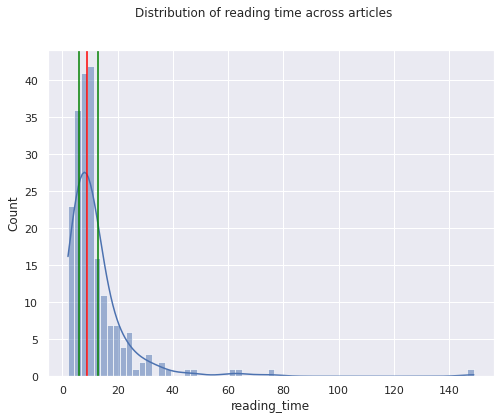

In [ ]:
# ditsribution of reading times in our corpus
fig, axes = plt.subplots(figsize = (8, 6))
# creating histograms
sns.histplot(articles["reading_time"], kde=True, ax = axes)
# Computing percentile of the reading_time data.
first_q = np.percentile(articles["reading_time"], 25)
# Computing median (50th percentile) of the reading_time data.
second_q = np.percentile(articles["reading_time"], 50)
third_q = np.percentile(articles["reading_time"], 75)
# green lines for 25th and 75th percentile
plt.axvline(first_q, color = "green")
# red line for median reading_time
plt.axvline(second_q, color = "red")
plt.axvline(third_q, color = "green")
# plot title
plt.suptitle("Distribution of reading time across articles")
plt.show()

* The graph is clearly right skewed.
* Hence most of ariticles in our corpus have a less reading time, with some articles having reading in hours.
* The median reading time is 9 minutes.

### **How does the reading time relates with article length ?**

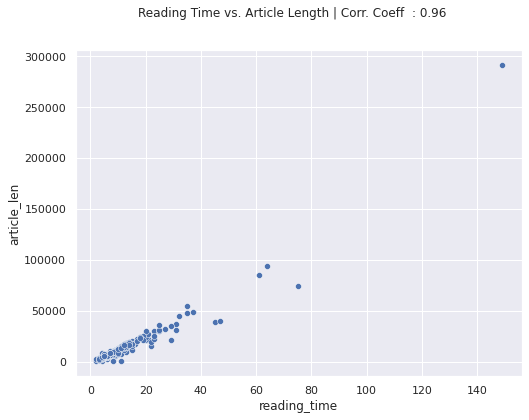

In [ ]:
from scipy.stats import pearsonr

articles["article_len"] = articles["text"].apply(lambda x : len(x))
# creating scatterplot
fig, axes = plt.subplots(figsize = (8, 6))
sns.scatterplot(x = articles["reading_time"], y = articles["article_len"])
# Pearson correlation coefficient measures the linear relationship between two set of values.
corr_coeff, _ = pearsonr(articles["reading_time"], articles["article_len"])
# plot title
plt.suptitle("Reading Time vs. Article Length | Corr. Coeff  : {}".format(round(corr_coeff, 2)))
plt.show()

- As expected, the reading time and article length are correlated.

#### **Do writers usually write articles on similar topics ?**

Let's have a look at the authors now. Authors usually have a preference to write on the same topic.

In [ ]:
for author, count in dict(articles["author"].value_counts()).items():
    if(count < 2):
        continue
    print("Articles by {} :".format(author))
    for title in articles[articles["author"] == author]["title"].values:
        print(title)
    print("-"*120)

Articles by Adam Geitgey :
Machine Learning is Fun Part 5: Language Translation with Deep Learning and the Magic of Sequences
Machine Learning is Fun! Part 4: Modern Face Recognition with Deep Learning
Machine Learning is Fun! Part 3: Deep Learning and Convolutional Neural Networks
Machine Learning is Fun! Part 2
Machine Learning is Fun Part 6: How to do Speech Recognition with Deep Learning
------------------------------------------------------------------------------------------------------------------------
Articles by Joseph Rocca :
Ensemble methods: bagging, boosting and stacking
Understanding Variational Autoencoders (VAEs)
Understanding Generative Adversarial Networks (GANs)
------------------------------------------------------------------------------------------------------------------------
Articles by Natassha Selvaraj :
I tripled my income with data science. Here's how.
How to Land a Data Analytics Job in 6 Months
Top 10 Data Science Projects for Beginners
-----------------

- In the data that we have, it does seem that authors tend to write multiple articles on the same topic.

- But also, there are multiple authors writing on the same topic,

- **For example:**
> 1. Adam Geitgey & Susan Li, both seems to write on Machine Learning.
> 2. Natassha Selvaraj, Sara A. Metwalli & Terence Shin, all seems to write on buidling career as a Data Scientist.

---
##Solving common preprocessing Problems in NLP.
---

### Expanding Word Contractions

* Contractions are the shortened word of english words or phrases.
> Example -
> $$can't \rightarrow can\hspace{0.1cm} not$$
> $$you're \rightarrow you\hspace{0.1cm} are$$
> $$you'll've \rightarrow you\hspace{0.1cm} will\hspace{0.1cm} have$$

* Why is this a problem?
> Because of the following reasons -
> 1. They add in a special apostrophe character (computers cannot understand its meaning) to the text.
> 2. They are a combination of two words, hence can cause problems in tokenization.

* How to deal with it ?
> 1. Create a custom mapping of expansions.
> 2. Using contractions library.

In [ ]:
import re
# creating custom mapping
custom_mapping = {
    "n't" : " not",
    "'re" : " are",
    "'ve" : " have",
    "'ll" : " will",
    "'m" : " am"
}
# sample data
sample_text = """
I've decided to go to the party after all. I'll reach by 05:00 PM.
He's not coming with us.
It's his birthday and he has other plans.
They've thought about going to the movies.
I won't be going to movies.
"""
expanded_text = sample_text
for x in custom_mapping.keys():
    expanded_text = re.sub(x, custom_mapping[x], expanded_text)

print(expanded_text)


I have decided to go to the party after all. I will reach by 05:00 PM.
He's not coming with us.
It's his birthday and he has other plans.
They have thought about going to the movies.
I wo not be going to movies.



* **The problem with above approach**

> 1. The number of contractions can be large to list all.
> 2. There can be some not so simple cases which breaks the rule, like "won't".

> Lets try out second approach.

**Using contractions library:**
[Contractions Github](https://github.com/kootenpv/contractions)

In [ ]:
!pip install contractions

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 110 kB 4.9 MB/s 
     |████████████████████████████████| 287 kB 42.5 MB/s 


In [ ]:
import contractions

expanded_text = contractions.fix(sample_text)
print(expanded_text)


I have decided to go to the party after all. I will reach by 05:00 PM.
He is not coming with us.
It is his birthday and he has other plans.
They have thought about going to the movies.
I will not be going to movies.



#### Observe how efficient this library is.

---
## How do we represent text as numbers ?
---

* Machine learning algorithms need input data as numbers.
* What we have here is textual data.
* So we need to find a way to convert these texts into numbers (or vectors).
* Imagine each document that we have, is represented as a vector of numbers, of size $N$.




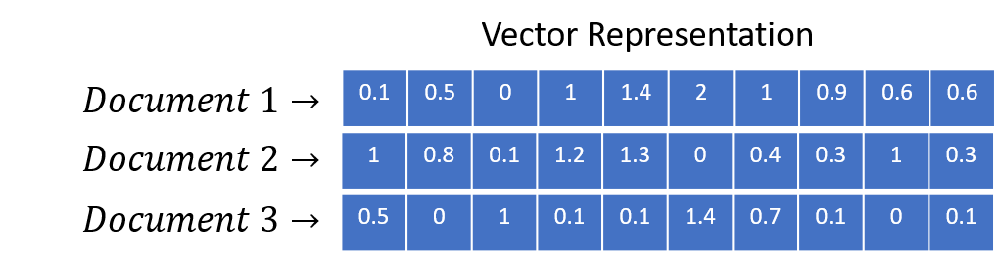

- Now once we have vectorized, each document we can use them as features for any machine learning model of our choice.

- There are multiple ways using which we can get a vector representation of text. Let's have a look at a couple of them.

## What could be the simplest techniques of converting a document into a vector?

### One-Hot encoding:

* Assigns 0 to all elements in a vector except for one, which has a value of 1. `This value represents a category of an element`.
```
For example:
If sentence = “Lecture on text representation"
```

### Step 1 - Create a vocabulary from the above corpus

> Vocabulary is simply a set of all unique words in the documents. For the above example, the vocabulary would be
* Lecture
* on
* text
* representation

### Step 2 - Each word in the sentence would be represented as below:

**Word** | Lecture | on | text | representation |
:--- | :---: | :---: | :---: | :---: |
**Lecture** | 1 | 0 | 0 | 0 |
**on** | 0 | 1 | 0 | 0 |
**text** | 0 | 0 | 1 | 0 |
**representation** | 0 | 0 | 0 | 1 |


```
Lecture → [1 0 0 0], on → [0 1 0 0], text → [0 0 1 0], representation → [0 0 0 1]
```
### Step 3 - The entire sentence is then represented as:
```
sentence = [ [1,0,0,0],[0,1,0,0],[0,0,1,0],[0,0,0,1] ]
```

* Intuition behind it is that each bit represents a possible category.
* And if a particular variable cannot fall into multiple categories, then a single bit is enough to represent it.

In [ ]:
from sklearn.preprocessing import OneHotEncoder
import itertools
# two example documents
docs = ["cat","dog","bat","ate","lion","dog","bat"]
# split documents to tokens
tokens_docs = [doc.split(" ") for doc in docs]
# convert list of of token-lists to one flat list of tokens
# and then create a dictionary that maps word to id of word,
all_tokens = itertools.chain.from_iterable(tokens_docs)
word_to_id = {token: idx for idx, token in enumerate(set(all_tokens))}
# convert token lists to token-id lists
token_ids = [[word_to_id[token] for token in tokens_doc] for tokens_doc in tokens_docs]
# convert list of token-id lists to one-hot representation
vec = OneHotEncoder(categories="auto")
X = vec.fit_transform(token_ids)
print(X.toarray())

[[0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0.]]


<details>
<summary>
    <font size="4" color=""><b>Drawbacks:</b></font>
</summary>
<p>
<ol>
    <li><b>Cannot measure the importance of a word</b> in a sentence. Only understands the mere presence/absence of a word in a sentence.</li>
    <li><b>High dimensional sparse matrix representation</b> can be memory & computationally expensive.</li>
    <li><b>Explosion in feature space</b> if the number of categories is very high.</li>
    <li>The vector representation of words is orthogonal and <b>cannot determine or measure the relationship between different words.</b></li>
    
</ol>
</p>

---
## Let's optimize the OHE representation
---

## Optimizing One Hot Encoding using Sparse vectors

* Only storing indicies of each word, to save space

In [ ]:
from sklearn.preprocessing import OneHotEncoder
import itertools
# two example documents
docs = ["cat","dog","bat","ate","lion","dog","bat"]
# split documents to tokens
tokens_docs = [doc.split(" ") for doc in docs]
# convert list of of token-lists to one flat list of tokens
# and then create a dictionary that maps word to id of word,
all_tokens = itertools.chain.from_iterable(tokens_docs)
word_to_id = {token: idx for idx, token in enumerate(set(all_tokens))}
# convert token lists to token-id lists
token_ids = [[word_to_id[token] for token in tokens_doc] for tokens_doc in tokens_docs]
token_ids


[[4], [2], [3], [0], [1], [2], [3]]

## How can we further optimize on One Hot Encoding ?
## Can we use the frequency of each word in the document ?

* **Bag Of Words**: Puts `words in a “bag” & computes the frequency of occurrence of each word`.


```
Let's start with an example. Let us assume that our corpus contains following 3 texts -
1. It was the best of times
2. It was the worst of times
3. It was the age of wisdom and the age of foolishness
```

### How do we do it?
### Step 1 - Create a vocabulary from the above corpus

Vocabulary is simply a set of all unique words in the documents. For the above example, the vocabulary would be -
* it
* was
* the
* best
* of
* times
* worst
* age
* wisdom
* and
* foolishness

### Step 2 - Construct One Hot Encoded representation of the words

For every sentence in a text, create a OHE representation of it using the vocabulary from Step 1.

For the 1st sentence -

**Word** | it | was | the | best | of | times |
:--- | :---: | :---: | :---: | :---: | :---: | :---: |
**it** | 1 | 0 | 0 | 0 | 0 | 0 |
**was** | 0 | 1 | 0 | 0 | 0 | 0 |
**the** | 0 | 0 | 1 | 0 | 0 | 0 |
**best** | 0 | 0 | 0 | 1 | 0 | 0 |
**of** | 0 | 0 | 0 | 0 | 1 | 0 |
**times** | 0 | 0 | 0 | 0 | 0 | 1 |  
**worst** | 0 | 0 | 0 | 0 | 0 | 0 |
**age** | 0 | 0 | 0 | 0 | 0 | 0 |
**wisdom** | 0 | 0 | 0 | 0 | 0 | 0 |
**and** | 0 | 0 | 0 | 0 | 0 | 0 |
**foolishness** | 0 | 0 | 0 | 0 | 0 | 0 |

Similarly, for the 2nd sentence -

**Word** | it | was | the | worst | of | times |
:--- | :---: | :---: | :---: | :---: | :---: | :---: |
**it** | 1 | 0 | 0 | 0 | 0 | 0 |
**was** | 0 | 1 | 0 | 0 | 0 | 0 |
**the** | 0 | 0 | 1 | 0 | 0 | 0 |
**best** | 0 | 0 | 0 | 0 | 0 | 0 |
**of** | 0 | 0 | 0 | 0 | 1 | 0 |
**times** | 0 | 0 | 0 | 0 | 0 | 1 |  
**worst** | 0 | 0 | 0 | 1 | 0 | 0 |
**age** | 0 | 0 | 0 | 0 | 0 | 0 |
**wisdom** | 0 | 0 | 0 | 0 | 0 | 0 |
**and** | 0 | 0 | 0 | 0 | 0 | 0 |
**foolishness** | 0 | 0 | 0 | 0 | 0 | 0 |

### Step 3 - Combine the OHE word representations for every document

Once we have the OHE of all words in a document, the only thing left is to combine them, to get a get a single vector representation for the document. The are two common ways to do so -
1. Using a binary OR operator between the OHE vectors. The final document vector that we get in this case simply tells the absence or presence of certain words in the document.
2. Using a vector sum opeartor. The final document vector that we get in this case tells the frequency of each word in the document.

Lets apply both the combination techniques in the 3rd sentence -

**Word** | it | was | the | age | of | wisdom | and | the | age | of | foolishness |    | Combining using OR | Combining using SUM
:--- | :---: | :---: | :---: | :---: | :---: | :---: | :---: | :---: | :---: | :---: | :---: | :---: | :---: | :---: |
**it** | 1 | 0 | 0 | 0 | 0 | 0 | 0 | 0 | 0 | 0 | 0 | | **1** | **1** |
**was** | 0 | 1 | 0 | 0 | 0 | 0 | 0 | 0 | 0 | 0 | 0 | | **1** | **1** |  
**the** | 0 | 0 | 1 | 0 | 0 | 0 | 0 | 1 | 0 | 0 | 0 | | **1** | **2** |  
**best** | 0 | 0 | 0 | 0 | 0 | 0 | 0 | 0 | 0 | 0 | 0 | | **0** | **0** |  
**of** | 0 | 0 | 0 | 0 | 1 | 0 | 0 | 0 | 0 | 1 | 0 | | **1** | **2** |
**times** | 0 | 0 | 0 | 0 | 0 | 0 | 0 | 0 | 0 | 0 | 0 | | **0** | **0** |   
**worst** | 0 | 0 | 0 | 0 | 0 | 0 | 0 | 0 | 0 | 0 | 0 | | **0** | **0** |  
**age** | 0 | 0 | 0 | 1 | 0 | 0 | 0 | 0 | 1 | 0 | 0 | | **1** | **2** |  
**wisdom** | 0 | 0 | 0 | 0 | 0 | 1 | 0 | 0 | 0 | 0 | 0 | | **1** | **1** |  
**and** | 0 | 0 | 0 | 0 | 0 | 0 | 1 | 0 | 0 | 0 | 0 | | **1** | **1** |
**foolishness** | 0 | 0 | 0 | 0 | 0 | 0 | 0 | 0 | 0 | 0 | 1 | | **1** | **1** |

**Note: The combination using the sum operator is more commonly used, as it conveys more information about the text - like which words are used more frequently (this is obviously done after removing stopwords).**

The representation of all the 3 texts above are -

**Sentence** | it | was | the | best | of | times | worst | age | wisdom | and | foolishness
:--- | :---: | :---: | :---: | :---: | :---: | :---: | :---: | :---: | :---: | :---: | :---:
**It was the best of times** | 1 | 1 | 1 | 1 | 1 | 1 | 0 | 0 | 0 | 0 | 0
**It was the worst of times** | 1 | 1 | 1 | 0 | 1 | 1 | 1 | 0 | 0 | 0 | 0
**It was the age of wisdom and the age of foolishness** | 1 | 1 | 2 | 0 | 2 | 0 | 0 | 2 | 1 | 1 | 1

* Here, we see that each of 3 documents are represented as a vector of size 11 (vocabulary size).

* This vectorization technique is easy to implement as well. Plus it also has a implementation in the scikit-learn package.

### The above representation is called Bag-of-Words (BOW)


**BOW is one of the simplest techniques use for textual feature extraction. Here, yet again we break the document into its smallest component - words, and build it from there.**

* It does not take into account the word order or lexical information for text representation.

* The intuition is that documents having similar words are similar irrespective of the word positioning.



In [ ]:
# Custom implementation of BoW

# sample data
corpus = [
    "it was the best of times",
    "it was the worst of times",
    "it was the age of wisdom and the age of foolishness"
]

def get_bow_representation(corpus, frequency = True):
    vocabulary = set([x for x in " ".join(corpus).lower().split(" ")])

    bow_rep = []
    for sentence in corpus:
        sentence_rep = dict([(v,0) for v in vocabulary])
        for word in word_tokenize(sentence.lower()):
            if frequency:
                sentence_rep[word] += 1
            else:
                sentence_rep[word] = 1
        bow_rep.append(sentence_rep)
    return bow_rep

bow_representation = get_bow_representation(corpus, True)
df = pd.DataFrame(bow_representation)
df.index = corpus
display(df)

,worst,and,age,best,it,was,of,times,wisdom,foolishness,the
it was the best of times,0,0,0,1,1,1,1,1,0,0,1
it was the worst of times,1,0,0,0,1,1,1,1,0,0,1
it was the age of wisdom and the age of foolishness,0,1,2,0,1,1,2,0,1,1,2


## Using [Sklearn CountVectorizer](https://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.CountVectorizer.html)

* It `converts` the corpus of multiple sentences (say product reviews) into a `matrix of reviews & words` & fills it with the frequency of each word in a sentence.

In [ ]:
# Using CountVectorizer from scikit-learn
from sklearn.feature_extraction.text import CountVectorizer

cv = CountVectorizer()
# Learn the vocabulary dictionary and return document-term matrix
bow_rep = cv.fit_transform(corpus).todense()  # todense() returns a matrix
# create dataframe
df = pd.DataFrame(bow_rep)
# Get output feature names for dataframe columns.
df.columns = cv.get_feature_names()
df.index = corpus
display(df)

/usr/local/lib/python3.8/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,age,and,best,foolishness,it,of,the,times,was,wisdom,worst
it was the best of times,0,0,1,0,1,1,1,1,1,0,0
it was the worst of times,0,0,0,0,1,1,1,1,1,0,1
it was the age of wisdom and the age of foolishness,2,1,0,1,1,2,2,0,1,1,0


* CountVectorizer has a lot of inbuilt text processing features.

* One of them is removing stop words directly from the corpus.

In [ ]:
# using CountVectorizer for removing stop-words directly from the corpus.
cv = CountVectorizer(stop_words="english")
bow_rep = cv.fit_transform(corpus).todense()
df = pd.DataFrame(bow_rep)
df.columns = cv.get_feature_names()
df.index = corpus
display(df)

/usr/local/lib/python3.8/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,age,best,foolishness,times,wisdom,worst
it was the best of times,0,1,0,1,0,0
it was the worst of times,0,0,0,1,0,1
it was the age of wisdom and the age of foolishness,2,0,1,0,1,0


### Problems:
1. The BOW representation considers each word to be equally important (in the final document vector, each word in the text has an equal contribution of 1 at one of the positions).

2. It can not distinguish between the rare important words and the common words.

- **For example:**
> If you're looking at a set of articles about deep learning, then the phrase "neural network" might be present in a lot of articles and hence does not convey a lot of information (considering the corpus).

But the phrase "Reinforcement Learning" might be present in a few, and hence does convey unique information about those specific articles.

<details>
<summary>
    <font size="4" color=""><b>Can you think of any drawbacks of BOW representation?</b></font>
</summary>
<p>
<ol>
    <li>This method ignores the location information of the word. It is not possible to grasp the meaning of a word from this representation.</li>
    <li>The intuition that high-frequency words are more important or give more information about the sentence fails when it comes to stop-words like “is, the, an, I” & when the corpus is context-specific.</li>
    <li>For example, in a corpus about covid-19, the word coronavirus may not add a lot of value.</li>
    
</ol>
</p>
</details>








### **So, is there a way we can create word vectors with rare and important words getting more weightage ?**

**Advanced BOW**

* To suppress the very high-frequency words & ignore the low-frequency words, there is a need to normalize the “weights” of the words accordingly.

## [What is TF-IDF?](https://towardsdatascience.com/tf-idf-for-document-ranking-from-scratch-in-python-on-real-world-dataset-796d339a4089)
TF-IDF is another very popular technique to get the feature representation for a text in a corpus. Similar to the BOW model, here as well the size of final document vector is equal to the number of tokens considered.

As the name suggests, TF-IDF is mainly composed of two components - TF (Term Frequency) and IDF (Inverse Document Frequency).

<!-- <img src="images/tfidf.PNG" width="800" height="800"> -->

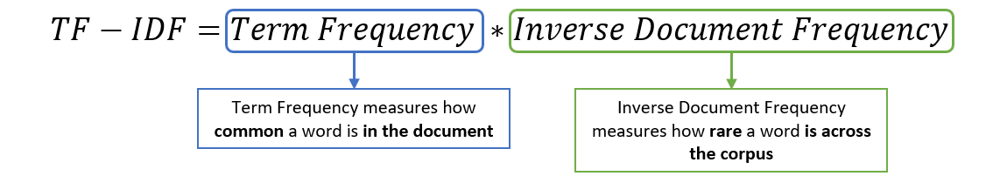

#### What is Term Frequency (TF) in TF-IDF?

- Term Frequency is the measure of how common a word (or token) is in the document.
- More `common words` (or tokens) `of a document` would have a `higher term frequency`.This is calculated for every word in a document.

- There are various ways to determine the term frequency. One of the most common formulation of TF is -
$$TF(t,d) = \frac{f_{t,d}}{\sum_{t' \in d} f_{t',d}} $$

Here,
* $TF(t,d)$ is the term Frequency of term $t$ in document $d$
* $f_{t,d}$ is the frequency of term $t$ in document $d$

The above formulation is simply the ratio of the frequency of a term in the document to the total number of terms in the document. TF of the term increases as the frequency of the term increases.

Some other formulations for Term Frequency are -
1. Using the raw count itself, $TF(t,d) = f_{t,d}$
2. Using boolean frequency, $TF(t,d) = 1$ if $t$ occurs in $d$ else $0$
3. Logarithmically scaled frquencies, $TF(t,d) = log(1 + f_{t,d})$
4. Augmented frequency to prevent bias towards longer documents, $$TF(t,d) = 0.5 + 0.5 * \frac{f_{t,d}}{max(f_{t', d} : t' \in d)} $$

Using the same example from before, lets computer the TF for each word in the corpus -
1. It was the best of times
2. It was the worst of times
3. It was the age of wisdom and the age of foolishness

In [ ]:
# sample data
corpus = [
    "it was the best of times",
    "it was the worst of times",
    "it was the age of wisdom and the age of foolishness"
]

def get_term_frequency(corpus):
    vocabulary = set([x for x in " ".join(corpus).lower().split(" ")])

    term_freq = []
    for sentence in corpus:
        sentence_tf = dict([(v,0) for v in vocabulary])
        for word in word_tokenize(sentence.lower()):
            sentence_tf[word] += 1
        for v in vocabulary:
            sentence_tf[v] /= len(word_tokenize(sentence))
        term_freq.append(sentence_tf)
    return term_freq

term_freq = get_term_frequency(corpus)
df = pd.DataFrame(term_freq)
df.index = corpus
display(df)

,worst,and,age,best,it,was,of,times,wisdom,foolishness,the
it was the best of times,0.000000,0.000000,0.000000,0.166667,0.166667,0.166667,0.166667,0.166667,0.000000,0.000000,0.166667
it was the worst of times,0.166667,0.000000,0.000000,0.000000,0.166667,0.166667,0.166667,0.166667,0.000000,0.000000,0.166667
it was the age of wisdom and the age of foolishness,0.000000,0.090909,0.181818,0.000000,0.090909,0.090909,0.181818,0.000000,0.090909,0.090909,0.181818


#### Inverse Document Frequency (IDF)

- Inverse Document Frequency measures `how rare a word (or token) is across corpus`.
- A `rarer word` (or token) would have a `larger IDF`. There are multiple ways to determine IDF as well.

- One of the most common formulation is -
$$IDF(t,C) = log(\frac{|d|}{|{d \in C : t \in d}|})$$

Here,
* $IDF(t,d,C)$ is the Inverse Document Frequency of term $t$ in corpus $C$. As we can see from the formulation, IDF is calculated for each word at corpus level and not for individual documents.
* $|d|$ is the absolute number of documents in the corpus.
* $|{d \in C : t \in d}|$ is the number of documents in corpus $C$ which contains the term $t$

The above formulation is simply the log scaled inverse fraction of documents which contains the term $t$ in the corpus $D$.

Log is used as it dampens the effect of huge number of documents in the corpus.

Some other formulations of Inverse Document Frequency are -
1. Smoothened IDF, $$IDF(t,C) = log(\frac{|d|}{1 + |{d \in C : t \in d}|}) + 1$$
2. Max IDF, $$IDF(t,C) = log(\frac{max_{t' \in d}(|{d \in C : t' \in d}|)}{|{d \in C : t \in d}|})$$

In [ ]:
def get_inverse_document_frequency(corpus):
    vocabulary = set([x for x in " ".join(corpus).lower().split(" ")])
    n = len(corpus)

    inverse_document_frequency = {}
    for v in vocabulary:
        num_docs = 0
        for sentence in corpus:
            if v in word_tokenize(sentence.lower()):
                num_docs += 1
        inverse_document_frequency[v] = np.log(n/num_docs)
    return inverse_document_frequency

inverse_document_frequency = get_inverse_document_frequency(corpus)
inverse_document_frequency

{'worst': 1.0986122886681098,
 'and': 1.0986122886681098,
 'age': 1.0986122886681098,
 'best': 1.0986122886681098,
 'it': 0.0,
 'was': 0.0,
 'of': 0.0,
 'times': 0.4054651081081644,
 'wisdom': 1.0986122886681098,
 'foolishness': 1.0986122886681098,
 'the': 0.0}

In [ ]:
def get_tf_idf(corpus):
    tf = get_term_frequency(corpus)
    idf = get_inverse_document_frequency(corpus)

    tf_idf = []
    for tf_dict in tf:
        tf_idf_sentence = {}
        for t, term_freq in tf_dict.items():
            tf_idf_sentence[t] = term_freq * idf[t]
        tf_idf.append(tf_idf_sentence)

    return tf_idf

tf_idf = get_tf_idf(corpus)
df = pd.DataFrame(tf_idf)
df.index = corpus
display(df)

,worst,and,age,best,it,was,of,times,wisdom,foolishness,the
it was the best of times,0.000000,0.000000,0.000000,0.183102,0.0,0.0,0.0,0.067578,0.000000,0.000000,0.0
it was the worst of times,0.183102,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.067578,0.000000,0.000000,0.0
it was the age of wisdom and the age of foolishness,0.000000,0.099874,0.199748,0.000000,0.0,0.0,0.0,0.000000,0.099874,0.099874,0.0


In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
# using inbuilt TfidfVectorizer() function to calculate TF-IDF
tf_idf_vectorizer = TfidfVectorizer()
tf_idf_rep = tf_idf_vectorizer.fit_transform(corpus).todense()
df = pd.DataFrame(tf_idf_rep)
df.columns = tf_idf_vectorizer.get_feature_names()
df.index = corpus
display(df)

/usr/local/lib/python3.8/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,age,and,best,foolishness,it,of,the,times,was,wisdom,worst
it was the best of times,0.000000,0.000000,0.579897,0.000000,0.342496,0.342496,0.342496,0.441027,0.342496,0.000000,0.000000
it was the worst of times,0.000000,0.000000,0.000000,0.000000,0.342496,0.342496,0.342496,0.441027,0.342496,0.000000,0.579897
it was the age of wisdom and the age of foolishness,0.617558,0.308779,0.000000,0.308779,0.182370,0.364740,0.364740,0.000000,0.182370,0.308779,0.000000


* The results from custom implementation and from scikit-learn of TFIDF are `different` as TFIDF of scikit-learn uses `smoothening for IDF, normalization and other improvements`.

* Similar to CountVectorizer, TfidfVectorizer also has many `inbuilt text processing functionalities`, like `removing stopwords`, setting `ngarm range` etc.  

---
## TF-IDF vs BOW
---
#### Let's understand them better with a common example

In [ ]:
# sample data
corpus = [
    "it was the best of times",
    "it was the worst of times",
    "it was the age of wisdom and the age of foolishness"
]

# BOW
bow_representation = get_bow_representation(corpus, True)

# Tf-IDF
tf_idf_representation = get_tf_idf(corpus)


# Group their labels
grouped_representation = []
for i in range(3):
    bow_sentence = bow_representation[i]
    tf_idf_sentence = tf_idf_representation[i]
    grouped_sentence = {}
    for word in bow_sentence.keys():
        # Rounding decimals to 3 significant digits
        grouped_sentence[word] = (round(bow_sentence[word], 3), round(tf_idf_sentence[word], 3))

    grouped_representation.append(grouped_sentence)

df = pd.DataFrame(grouped_representation)
df.index = corpus
display(df)

,worst,and,age,best,it,was,of,times,wisdom,foolishness,the
it was the best of times,"(0, 0.0)","(0, 0.0)","(0, 0.0)","(1, 0.183)","(1, 0.0)","(1, 0.0)","(1, 0.0)","(1, 0.068)","(0, 0.0)","(0, 0.0)","(1, 0.0)"
it was the worst of times,"(1, 0.183)","(0, 0.0)","(0, 0.0)","(0, 0.0)","(1, 0.0)","(1, 0.0)","(1, 0.0)","(1, 0.068)","(0, 0.0)","(0, 0.0)","(1, 0.0)"
it was the age of wisdom and the age of foolishness,"(0, 0.0)","(1, 0.1)","(2, 0.2)","(0, 0.0)","(1, 0.0)","(1, 0.0)","(2, 0.0)","(0, 0.0)","(1, 0.1)","(1, 0.1)","(2, 0.0)"


## We see that...

#### TF-IDF

* It computes the feature importances of a word in a document of a corpus
* It can detect and nullify the effect of stopwords on feature vector of a sentence

#### Bag Of Words
* It computes the frequencies (or) presence of a word in a document of a corpus
* It assigns equal priority to every word. It cannot detect stopwords


### Ngram parameter ( we will study ngram later on)
* `ngram` and how it can be used. For example, the word "`neural networks`" tend to come in pair. So we should tokenize such words together as a single token "`neural_networks`".

* `TfidfVectorizer` has inbuild parameters to achieve this:

In [ ]:
# Bigram using TfidfVectorizer
tf_idf_vectorizer = TfidfVectorizer(ngram_range=(1,2))
tf_idf_rep = tf_idf_vectorizer.fit_transform(corpus).todense()
df = pd.DataFrame(tf_idf_rep)
df.columns = tf_idf_vectorizer.get_feature_names()
df.index = corpus
display(df)

/usr/local/lib/python3.8/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,age,age of,and,and the,best,best of,foolishness,it,it was,of,of foolishness,of times,of wisdom,the,the age,the best,the worst,times,was,was the,wisdom,wisdom and,worst,worst of
it was the best of times,0.000000,0.000000,0.000000,0.000000,0.400008,0.400008,0.000000,0.236251,0.236251,0.236251,0.000000,0.304216,0.000000,0.236251,0.000000,0.400008,0.000000,0.304216,0.236251,0.236251,0.000000,0.000000,0.000000,0.000000
it was the worst of times,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.236251,0.236251,0.236251,0.000000,0.304216,0.000000,0.236251,0.000000,0.000000,0.400008,0.304216,0.236251,0.236251,0.000000,0.000000,0.400008,0.400008
it was the age of wisdom and the age of foolishness,0.415353,0.415353,0.207677,0.207677,0.000000,0.000000,0.207677,0.122657,0.122657,0.245314,0.207677,0.000000,0.207677,0.245314,0.415353,0.000000,0.000000,0.000000,0.122657,0.122657,0.207677,0.207677,0.000000,0.000000




<details>
<summary>
    <font size="4" color=""><b>Important parameters:</b></font>
</summary>
<p>
<ul>
    <li><b>text preprocessing parameters</b>: lowercase, strip_accent, stop_words, etc</li>
    <li><b>norm</b>: to apply l1 & l2 norm</li>
    <li><b>ngram_range</b>: range of n-values for different n-grams to be extracted</li>
    <li><b>sublinear_tf</b>: Apply sublinear tf scaling, i.e. replace tf with 1 + log(tf)</li>
</ul>
</p>
</details>

<details>
<summary>
    <font size="4" color=""><b>Summary of TF-IDF:</b></font>
</summary>
<p>
<ol>
    <li>Builds over CountVectorizer to <b> penalize highly frequent words & low-frequency terms in a corpus.</b></li>
    <li>IDF aims to <b>reduce noise</b> in our matrix.</li>
    <li>TF-IDF can be used to filter out uncommon & irrelevant words easily helping model train & converge faster.</li>
</ol>
</p>
</details>

<details>
<summary>
    <font size="4" color=""><b>Drawbacks of TF-IDF representation:</b></font>
</summary>
<p>
<ol>
    <li><b>Positional information</b> of the word is still <b>not captured</b> in this representation.</li>
    <li>TF-IDF is highly <b>corpus-dependent</b>.</li>
    <li>A matrix representation generated out of cricket data cannot be used for football or volleyball. Therefore, there is a <b>need to have high-quality training data</b>.</li>
    
</ol>
</p>


Some of the drawbacks of both BOW and TFIDF method are -
1. For a large corpus, the vocabulary can be huge, hence computation and storage of both BOW and TFIDF can be difficult.
2. Both BOW and TFIDF only considers the presence or absence of words. None of them considers the meaning.

> For example, consider the words 'good', 'nice' and 'bad' in vocabulary. All three of them would be equally different from each other according to the BOW representation, however we know that 'good' and 'nice' are similar in meaning and are both different from the word 'bad'.


<details>
<summary>
    <font size="4" color=""><b>Problems with above representations:</b></font>
</summary>
<p>
<ul>
    <li>It <b>does not leverage co-occurrence statistics between words</b>. It assumes all words are independent of each other</li>
    <li>This leads to highly sparse vectors with few non zero values</li>
    <li>They <b>do not capture the context or semantics</b> of the word.</li>
    <li> It does not consider spooky & scary as similar but as two independent terms with no commonality between them.</li>
    <li>The representation is directly proportional to vocabulary size. <b>High vocabulary size can lead to memory constraints</b>.</li>
</ul>
</p>
</details>

## Back to our task at hand...
---
### Euclidean Distance vs Cosine Similarity
---

#### How do we calculate the distance between the words (or how do we measure the difference between the two words) ?

- Each of the word above is representend as a vector of numbers.
- So, if we could find `distance between the representations`, it would technically `give the distance between the corresponsing words` (using the current vectorization technique).

So the next question is

> **How do we calculate the distance between two vectors ?**

- We can imagine each of vectors above as a point in $N$ (here 3) dimensional space.

- There are 2 popular distance metrics that we usually use to calculate the distance between any 2 points in space -

### 1. Euclidean Distance

This is the well known method to calculate the distance bewteen any 2 points in space. It is like `mesauring distance using ruler`.

$$euclidean \hspace{0.1cm} distance = \sqrt{\sum_{i}^{N}(X_i - Y_i)^2 }$$

Here,
* $X$ and $Y$ are the 2 vectors.
* Size of each vector is $N$


### 2. Cosine Distance

- Before we look at cosine distance, let us look at cosine similarity, because that is what we usually see being used at most places.
- Cosine similarity measures the similarity between two vectors, and is `mathematically represented as the cosine of angle between the 2 vectors`.
- As the definition suggests, cosine similarity only depends on the angle between the vectors and not the magnitude between the vectors.

$$cosine \hspace{0.1cm} similarity = cos(\theta) =  \frac{\sum_{i}^{N}X_i.Y_i}{\sqrt{\sum_{i}^{N}(X_i)^2 } \sqrt{\sum_{i}^{N}(Y_i)^2 }}$$

Here,
* $X$ and $Y$ are the 2 vectors.
* $\theta$ is the angle between $X$ and $Y$.

As per above formulation, $cosine \hspace{0.1cm} similarity$ can range from $-1$ to $1$. Two vectors which lie on the same line ($\theta = 0$) have a cosine similarity of $1$ and two vectors which lie in opposite direction to each other ($\theta = 180$) have a cosine similarity of -1.

###Cosine distance is calculated as  -

$$cosine \hspace{0.1cm} distance = 1 - cosine \hspace{0.1cm} similarity$$

- **Cosine distance can range from 0 to 2.**

[euclidean-distance-vs-cosine-similarity](https://www.baeldung.com/cs/euclidean-distance-vs-cosine-similarity)

`Vectors with a small Euclidean distance from one another are located in the same region of a vector space. Vectors with a high cosine similarity are located in the same general direction from the origin`.

### Cosine vs. Euclidean - which one to use ?

- Cosine Similarity is typically used in the cases when the magnitude of the vector does not matter.

* **For example:**

> In the cases of textual representation using something like BOW, a word like "cricket" might be present 50 times in one document which has 1000 words, and 5 times in another document with 100 words. It we calculate the distance using euclidean metric, we might not find the two documents very similar. But this is because of the difference in the length between the 2 documents. Cosine similarity accounts for this very well as this does not look at the magnitude but the angle between the documents (represented by vectors). And here, even though the difference in magnitude is high, the angle will be small.


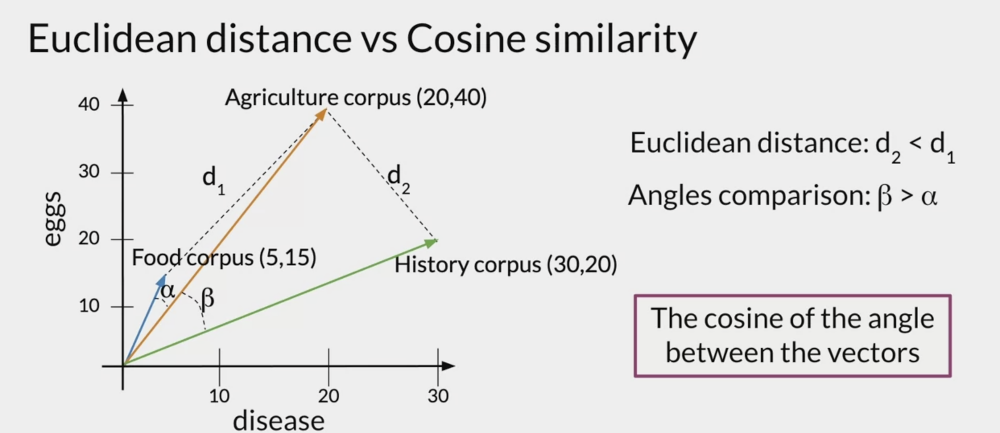




###Coming back to the original problem -
* Given the 3 words (king, man and water), all represented using BOW vectors, lets try and find the distance between them using cosine distance metric.

In [ ]:
# 3 words represented by BOW vectors
king = [1, 0, 0]
man = [0, 1, 0]
water = [0, 0, 1]
# calculate cosine distance
def cosine_distance(x, y):
    return 1 - np.dot(x, y) / (np.sqrt(np.dot(x, x)) * np.sqrt(np.dot(y, y)))

print("Cosine Distance")
print("Between {} and {} : {}".format("king", "man", cosine_distance(king, man)))
print("Between {} and {} : {}".format("king", "water", cosine_distance(king, water)))
print("Between {} and {} : {}".format("water", "man", cosine_distance(man, water)))

Cosine Distance
Between king and man : 1.0
Between king and water : 1.0
Between water and man : 1.0


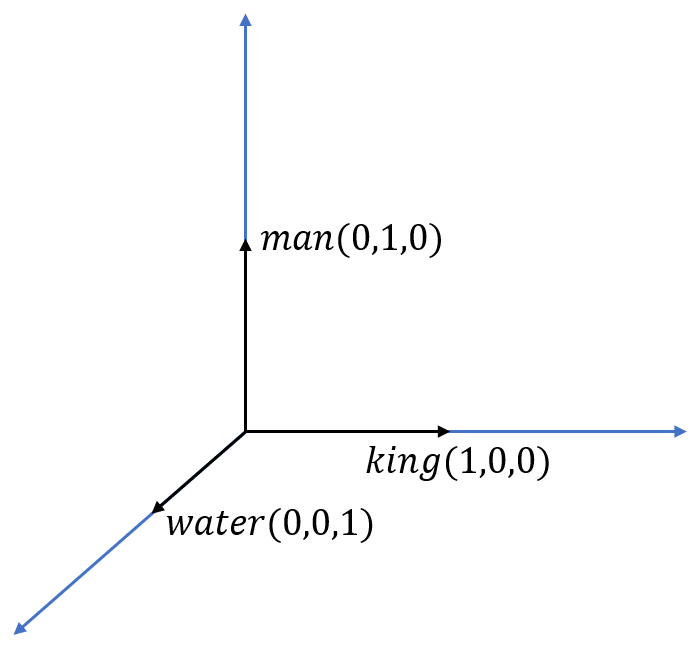

<!-- <img src="images/bow_ex_graph.PNG" width="400" height="400"> -->

- The above image shows that the 3 vectors lie perpendicular to each other.
- Hence cosine similarity b/w any 2 of them is 0 (hence is distance between any 2 of them is 1)

### - From our knowledge of engligh language we do know that a "king" and "man" are more similar to each other as compared to "king" and "water" (or "water" and "man").







* **Example 1:**
> Suppose you have two questions:
> 1. "Where are you heading?"
> 2. "Where are you from?".

* **Note: that these sentences have identical words, except for the last ones. However, they both have a different meaning.**

> **Example 2:**
> Suppose you have two questions:
> 1. "What is your age?"
> 2. "How old are you?".

* **Note: words are completely different but both sentences mean the same.**

* **So this shows that BOW based vectorization technique do not capture the meaning of the words.**


### Preprocessing:

We would first need to process the data that we have using the techniques we discussed earlier in the lecture -

1. Split the article into sentences.
2. For each sentence in the corpus -
    1. Convert the sentence to lowercase
    2. Expand contractions
    3. Lemmatization
    4. Remove stopwords
    5. Remove punctuations

In [ ]:
def process_sentence(sentence, nlp_object):
    # Convert to lowercase
    sentence = sentence.lower()

    # Exapnding contractions
    sentence = contractions.fix(sentence)

    # Lemmatization and removing stopwords
    doc = nlp_object(sentence)
    sentence = " ".join([token.lemma_ for token in doc if not token.is_stop])

    # Remove punctuation
    for p in string.punctuation:
        sentence = sentence.replace(p, " ")
    sentence = re.sub(r"\s+", " ", sentence) # Replace all whitespace characters with space

    return sentence

In [ ]:
from tqdm.notebook import tqdm
# tqdm to see real time progress
tqdm.pandas()

nlp = spacy.load('en_core_web_sm') # English pipeline optimized for CPU

def process_article(article_text, nlp_object):
    processed_article_sentences = []
    # using nltk sentence tokenizer
    for sentence in sent_tokenize(article_text):
        # preprocessing each sentence using our process_sentence function
        processed_article_sentences.append(process_sentence(sentence, nlp_object))
    # joining preprocessed sentence as a complete paragrams of the article
    return " ".join(processed_article_sentences)

articles["processed_text"] = articles["text"].progress_apply(lambda x : process_article(x, nlp))


  0%|          | 0/208 [00:00<?, ?it/s]

At this point we have processed and tokenized the article text. Now finally let us try to find out the similarity between the articles.

---
## How will we find similarity between documents ?
---
**Document Similarity**

Well, we would first need to make a vector representation of the documents. We have already seen a couple of ways to do that -
1. BOW
2. TF-IDF

And the similarity metric would again be cosine similarity.

### Similarity using BOW

In [ ]:
# BOW representation of the dataset Using CountVectorizer from scikit-learn
count_vectorizer = CountVectorizer(min_df=5)
# min_df: ignore terms that have a document frequency strictly lower than the given threshold.

# Learn the vocabulary dictionary and return document-term matrix
bow_features = count_vectorizer.fit_transform(articles["processed_text"]).todense() # todense() returns a matrix
# create dataframe
bow_features_df = pd.DataFrame(bow_features)
bow_features_df.columns = count_vectorizer.get_feature_names() # Get output feature names for dataframe columns.
bow_features_df["TITLE"] = articles["title"]
bow_features_df["ID"] = articles["id"]
display(bow_features_df)

/usr/local/lib/python3.8/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


,00,000,01,05,06,07,10,100,1000,101,10k,10x,11,12,120,125,128,13,14,15,150,16,17,18,19,1980,1989,1990,1k,1st,20,200,2000,2001,2005,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,21,...,wire,wise,wish,withdraw,woman,wonder,wonderful,wood,word,work,worker,workflow,working,workout,world,worried,worry,worsen,worth,wow,wrap,write,writer,writing,wrong,www,xgboost,xi,yeah,year,yearly,yell,yellow,yes,yesterday,yield,yo,york,you,young,youtube,zero,zhou,zip,zombie,zone,zoom,zuckerberg,TITLE,ID
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,2,2,0,0,0,0,0,0,0,0,0,0,0,4,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,"Ensemble methods: bagging, boosting and stacking",1
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Understanding AUC - ROC Curve,2
2,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,4,0,0,0,0,0,0,0,0,0,0,0,2,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,How to work with object detection datasets in ...,3
3,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,4,0,0,0,0,3,0,1,0,0,0,0,4,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,11 Dimensionality reduction techniques you sho...,4
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,...,0,0,1,0,0,0,0,0,1,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,The Time Series Transformer,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,1,0,0,0,4,0,0,0,0,0,0,0,1,0,0,0,1,0,0,3,0,0,0,0,4,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,Type 2 Diabetes Reversal The Quick Start Guide,210
204,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,3,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,2,0,0,How a 22 Day Water Fast Changed My Life,211
205,0,0,0,0,0,0,1,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,Breaking Your Fast,212
206,0,0,0,0,0,0,5,0,0,0,0,0,0,0,0,0,0,0,0,3,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,10,0,0,0,0,1,0,0,0,0,0,0,3,0,0,0,1,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,11 Unusual Tips for How to Wake Up Early,213


---
## How will we visualize this high dimensional data?
---

### [T-SNE](https://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html)
- T-distributed Stochastic Neighbor Embedding is a method of visualizing high dimensional data
- It converts similarities to joint probabilities and minimizes the Kullback-Leibler divergence between the joint probabilities of the low-dimensional embedding and the high-dimensional data

In [ ]:
from sklearn.manifold import TSNE
# using t-sne to observe any trends, and clusters.
tsne = TSNE(n_components=2) # n_components: estimated number of components
tsne_bow_features = tsne.fit_transform(bow_features_df[count_vectorizer.get_feature_names_out()].values)
tsne_bow_features_df = pd.DataFrame(tsne_bow_features)
tsne_bow_features_df.columns = ["C1", "C2"]
tsne_bow_features_df["TITLE"] = bow_features_df["TITLE"]
tsne_bow_features_df["ID"] = bow_features_df["ID"]

display(tsne_bow_features_df)

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


,C1,C2,TITLE,ID
0,-3.766976,3.832330,"Ensemble methods: bagging, boosting and stacking",1
1,-1.512818,-0.284274,Understanding AUC - ROC Curve,2
2,-2.527956,3.053830,How to work with object detection datasets in ...,3
3,-3.019499,2.399323,11 Dimensionality reduction techniques you sho...,4
4,-3.008904,1.024227,The Time Series Transformer,5
...,...,...,...,...
203,3.720150,-0.592128,Type 2 Diabetes Reversal The Quick Start Guide,210
204,4.460946,-2.413854,How a 22 Day Water Fast Changed My Life,211
205,4.534660,-2.270833,Breaking Your Fast,212
206,2.534135,-2.776935,11 Unusual Tips for How to Wake Up Early,213


In [ ]:
import plotly.express as px
# scatter plot of t-sne for the BOW representation

title = "T-distributed Stochastic Neighbor Embedding for BOW document representation"

fig = px.scatter(tsne_bow_features_df, x="C1", y="C2", hover_data=['TITLE'], title=title)
fig.show()

### What do we notice in the above graph ?

- We see most of documents to the right half describe articles related to Deep learning.
- Articles plotted to the left describe Coronavirus, Economics and other miscellaneous articles

Now, let us see if we can find similar documents using BOW reresentation.

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity

def get_similar_documents(all_article_rep_df, article_id, features):
    # extracting features of a article
    this_article_rep = all_article_rep_df[all_article_rep_df["ID"] == article_id][features]
    other_article_rep = all_article_rep_df[all_article_rep_df["ID"] != article_id][features]
    # calculating cosine similarity
    similarity_matrix = cosine_similarity(this_article_rep, other_article_rep)
    similar_articles = list(zip(similarity_matrix[0].tolist(), all_article_rep_df["TITLE"].tolist()))
    # sorting
    similar_articles = sorted(similar_articles, key = lambda x : x[0], reverse = True)
    print("Reference Article : {}".format(all_article_rep_df[all_article_rep_df["ID"] == article_id]["TITLE"].values[0]))

    print("**** Similar Articles ****")
    # top 5 similar articles
    for score, title in similar_articles[:5]:
        print(title)
    print()

# Let us check top 5 similar articles for some of the articles in our corpus
get_similar_documents(bow_features_df, 90, count_vectorizer.get_feature_names_out())
get_similar_documents(bow_features_df, 80, count_vectorizer.get_feature_names_out())
get_similar_documents(bow_features_df, 150, count_vectorizer.get_feature_names_out())
get_similar_documents(bow_features_df, 205, count_vectorizer.get_feature_names_out())

Reference Article : 17 types of similarity and dissimilarity measures used in data science.
**** Similar Articles ****
9 Distance Measures in Data Science
17 Clustering Algorithms Used In Data Science and Mining
Machine Learning Basics with the K-Nearest Neighbors Algorithm
OVER 100 Data Scientist Interview Questions and Answers!
Fundamental Techniques of Feature Engineering for Machine Learning

Reference Article : TensorFlow Tutorial Part 1
**** Similar Articles ****
How to go from a Python newbie to a Google Certified TensorFlow Developer under two months
Enchanted Random Forest
PCA using Python (scikit-learn)
The 7 Best Data Science and Machine Learning Podcasts
Building RNN, LSTM, and GRU for time series using PyTorch

Reference Article : The One Word That Explains Why Economics Professors Are Not Billionaires
**** Similar Articles ****
Why People Still Don't Get Cryptocurrency
You May Have A Poor Person's Mindset And Not Know It
You Will Never Be Rich If You Keep Doing These 10 t

**Result:**
- The suggested articles do seem to be similar to those in reference.
- BOW looks for presence and absence of words in different documents, so documents which have similar words would also have similar BOW representation, and hence would be more similar.

### Similarity using TF-IDF

In [ ]:
# TF-IDF representation of the dataset Using TfidfVectorizer from scikit-learn
tfidf_vectorizer = TfidfVectorizer(min_df=5)
# min_df: ignore terms that have a document frequency strictly lower than the given threshold.
tfidf_features = tfidf_vectorizer.fit_transform(articles["processed_text"]).todense()  # todense() returns a matrix
# create dataframe
tfidf_features_df = pd.DataFrame(tfidf_features)
tfidf_features_df.columns = tfidf_vectorizer.get_feature_names()  # Get output feature names for dataframe columns.
tfidf_features_df["TITLE"] = articles["title"]
tfidf_features_df["ID"] = articles["id"]
display(tfidf_features_df)

/usr/local/lib/python3.8/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.



,00,000,01,05,06,07,10,100,1000,101,10k,10x,11,12,120,125,128,13,14,15,150,16,17,18,19,1980,1989,1990,1k,1st,20,200,2000,2001,2005,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,21,...,wire,wise,wish,withdraw,woman,wonder,wonderful,wood,word,work,worker,workflow,working,workout,world,worried,worry,worsen,worth,wow,wrap,write,writer,writing,wrong,www,xgboost,xi,yeah,year,yearly,yell,yellow,yes,yesterday,yield,yo,york,you,young,youtube,zero,zhou,zip,zombie,zone,zoom,zuckerberg,TITLE,ID
0,0.000000,0.0,0.0,0.0,0.00000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,...,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.007980,0.005187,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.013338,0.0,0.0,0.000000,0.000000,0.009177,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,"Ensemble methods: bagging, boosting and stacking",1
1,0.000000,0.0,0.0,0.0,0.00000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,...,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.013973,0.0,0.0,0.000000,0.025727,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,Understanding AUC - ROC Curve,2
2,0.000000,0.0,0.0,0.0,0.01922,0.0,0.008293,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.014672,0.0,...,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.023045,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.014814,0.0,0.0,0.010827,0.013638,0.000000,0.0,0.0,0.006663,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,How to work with object detection datasets in ...,3
3,0.000000,0.0,0.0,0.0,0.00000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.006747,0.000000,0.0,0.0,0.0,0.0,0.008682,0.006805,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,...,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.013454,0.0,0.0,0.0,0.0,0.013790,0.0,0.008247,0.000000,0.0,0.0,0.0,0.017298,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.006579,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.006371,0.0,0.0,0.000000,0.000000,0.0,0.0,11 Dimensionality reduction techniques you sho...,4
4,0.000000,0.0,0.0,0.0,0.00000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.033916,0.000000,0.039066,0.0,0.000000,0.0,...,0.0,0.0,0.033916,0.0,0.000000,0.000000,0.0,0.0,0.021280,0.027664,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,The Time Series Transformer,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2

In [ ]:
tsne = TSNE(n_components=2)
tsne_tfidf_features = tsne.fit_transform(tfidf_features_df[tfidf_vectorizer.get_feature_names_out()].values)
tsne_tfidf_features_df = pd.DataFrame(tsne_tfidf_features)
tsne_tfidf_features_df.columns = ["C1", "C2"]
tsne_tfidf_features_df["TITLE"] = tfidf_features_df["TITLE"]
display(tsne_tfidf_features_df)

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



,C1,C2,TITLE
0,6.254388,10.419925,"Ensemble methods: bagging, boosting and stacking"
1,4.634700,18.682501,Understanding AUC - ROC Curve
2,-0.896234,13.886839,How to work with object detection datasets in ...
3,3.089645,14.519775,11 Dimensionality reduction techniques you sho...
4,11.353494,0.254676,The Time Series Transformer
...,...,...,...
203,3.638199,-19.150652,Type 2 Diabetes Reversal The Quick Start Guide
204,0.551373,-18.073492,How a 22 Day Water Fast Changed My Life
205,1.270169,-18.803946,Breaking Your Fast
206,-1.988436,-12.611320,11 Unusual Tips for How to Wake Up Early


In [ ]:
title = "T-distributed Stochastic Neighbor Embedding for TFIDF document representation"
fig = px.scatter(tsne_tfidf_features_df, x="C1", y="C2", hover_data=['TITLE'], title=title)
fig.show()

- In the above scatter plot, we see points usually allong three different directions.
- Hovering over the points, it seems the three directions contains articles broadly on the following topics -
> 1. Data Science/Machine Learning
> 2. Health
> 3. Finance

In [ ]:
# Let us check top 5 similar articles for some of the articles in our corpus
get_similar_documents(tfidf_features_df, 90, tfidf_vectorizer.get_feature_names_out())
get_similar_documents(tfidf_features_df, 80, tfidf_vectorizer.get_feature_names_out())
get_similar_documents(tfidf_features_df, 150, tfidf_vectorizer.get_feature_names_out())
get_similar_documents(tfidf_features_df, 205, tfidf_vectorizer.get_feature_names_out())

Reference Article : 17 types of similarity and dissimilarity measures used in data science.
**** Similar Articles ****
9 Distance Measures in Data Science
17 Clustering Algorithms Used In Data Science and Mining
Machine Learning Basics with the K-Nearest Neighbors Algorithm
OVER 100 Data Scientist Interview Questions and Answers!
Fundamental Techniques of Feature Engineering for Machine Learning

Reference Article : TensorFlow Tutorial Part 1
**** Similar Articles ****
How to go from a Python newbie to a Google Certified TensorFlow Developer under two months
Enchanted Random Forest
Building RNN, LSTM, and GRU for time series using PyTorch
Yes you should understand backprop
PCA using Python (scikit-learn)

Reference Article : The One Word That Explains Why Economics Professors Are Not Billionaires
**** Similar Articles ****
You Will Never Be Rich If You Keep Doing These 10 things
Why People Still Don't Get Cryptocurrency
You May Have A Poor Person's Mindset And Not Know It
How I transfo

TFIDF also seems to work well. Notice one improvement in the articles sugested for "The One Word That Explains Why Economics Professors Are Not Billionaires"
- All 5 articles suggested using TFIDF seems more relevant as conpared to articles suggested by BOW.

- Also notice the improvement in recommendations suggested for "TensorFlow Tutorial Part 1"

## Concluding Remarks

#### How do we evaluate performance in unsupervised learning problems ?
Validations from - surveys, user feedbacks etc.


#### How the topics we talked about forms the building blocks of NLP ?
The topics we discussed in this lecture forms the basic building blocks in Natural Language Processing.
- Here we saw that the Medium articles in our corpus mainly belonged to Data Science, Health and Finance.
- In other words there are three (or maybe more) broad topics, that our corpus talks about - this can be seggregated or identified using Topic Modeling.
- The vectorization techniques that we talked about are used extensively in text classification problems as well.
- Further there are more advanced vectorization techniques - which use language models and other deep learning methods - and these are the ones that are State of The Art in most of NLP problems.



---
## Extra material
---

### TF-IDF using smoothened IDF

In [ ]:
def get_smoothened_inverse_document_frequency(corpus):
    vocabulary = set([x for x in " ".join(corpus).lower().split(" ")])
    n = len(corpus)

    inverse_document_frequency = {}
    for v in vocabulary:
        num_docs = 0
        for sentence in corpus:
            if v in word_tokenize(sentence.lower()):
                num_docs += 1
        inverse_document_frequency[v] = 1 + np.log(n/(1+num_docs))
    return inverse_document_frequency

### TF-IDF using Max-IDF

In [ ]:
def get_max_inverse_document_frequency(corpus):
    vocabulary = set([x for x in " ".join(corpus).lower().split(" ")])
    n = len(corpus)

    inverse_document_frequency = {}

    # Maximum number of documents with a common term
    max_vocab_num_docs = 0
    for v in vocabulary:
        num_docs = 0
        for sentence in corpus:
            if v in word_tokenize(sentence.lower()):
                num_docs += 1

        max_vocab_num_docs = max(max_vocab_num_docs, num_docs)

        # Calculate denominator of Max-IDF
        inverse_document_frequency[v] = -np.log(num_docs)

    # Calculate numerator of Max-IDF
    for key in inverse_document_frequency.keys():
        inverse_document_frequency[key] += np.log(max_vocab_num_docs)

    return inverse_document_frequency

In [ ]:
def get_tf_idf(corpus, idf_type="normal"):
    tf = get_term_frequency(corpus)
    if(idf_type == "normal"):
        idf = get_inverse_document_frequency(corpus)
    elif(idf_type == "smoothened"):
        idf = get_smoothened_inverse_document_frequency(corpus)
    else: # Assuming IDF type is max-idf
        idf = get_max_inverse_document_frequency(corpus)

    tf_idf = []
    for tf_dict in tf:
        tf_idf_sentence = {}
        for t, term_freq in tf_dict.items():
            tf_idf_sentence[t] = term_freq * idf[t]
        tf_idf.append(tf_idf_sentence)

    return tf_idf

for idf_type in ["normal", "smoothened", "max"]:
    tf_idf = get_tf_idf(corpus, idf_type)
    df = pd.DataFrame(tf_idf)
    df.index = corpus
    display(df)

,worst,and,age,best,it,was,of,times,wisdom,foolishness,the
it was the best of times,0.000000,0.000000,0.000000,0.183102,0.0,0.0,0.0,0.067578,0.000000,0.000000,0.0
it was the worst of times,0.183102,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.067578,0.000000,0.000000,0.0
it was the age of wisdom and the age of foolishness,0.000000,0.099874,0.199748,0.000000,0.0,0.0,0.0,0.000000,0.099874,0.099874,0.0


,worst,and,age,best,it,was,of,times,wisdom,foolishness,the
it was the best of times,0.000000,0.00000,0.000000,0.234244,0.118720,0.118720,0.118720,0.166667,0.00000,0.00000,0.118720
it was the worst of times,0.234244,0.00000,0.000000,0.000000,0.118720,0.118720,0.118720,0.166667,0.00000,0.00000,0.118720
it was the age of wisdom and the age of foolishness,0.000000,0.12777,0.255539,0.000000,0.064756,0.064756,0.129512,0.000000,0.12777,0.12777,0.129512


,worst,and,age,best,it,was,of,times,wisdom,foolishness,the
it was the best of times,0.000000,0.000000,0.000000,0.183102,0.0,0.0,0.0,0.067578,0.000000,0.000000,0.0
it was the worst of times,0.183102,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.067578,0.000000,0.000000,0.0
it was the age of wisdom and the age of foolishness,0.000000,0.099874,0.199748,0.000000,0.0,0.0,0.0,0.000000,0.099874,0.099874,0.0


# Use case 3 : Bulding Search Engine

## With over 50,000 publications and research papers on the corona-virus family till date, it has become difficult to search across and get useful insights for medical practitioners.

As a $ Data Scientist $ at Google, you are tasked with solving this problem with the help of Machine Learning.

[Efficient Estimation of Word Representations in
Vector Space](https://arxiv.org/pdf/1301.3781.pdf)

[GloVe: Global Vectors for Word Representation](https://nlp.stanford.edu/pubs/glove.pdf)

#### How can we solve for this problem?
 - Can we match keywords from user queries that are present in abstract?
 - If we do keyword matching, will we be able to understand the user's intent? For e.g: 'origin' and 'discovery'
 - Should we consider the context of the words, then?

## Let us build a search engine using Word Embeddings

#### Datset
- COVID-19 Open Research Dataset, consisting of all publications/research papers related to Covid-19.
- Dataset contains Title, Abstract, DoI among other identifiers.
- To download - https://www.kaggle.com/allen-institute-for-ai/CORD-19-research-challenge


## Let us explore the dataset

#### Importing Necessary Libraries

In [ ]:
!pip install -q langdetect
!gdown 18M7lJHV6Y4pJTsFzDw8_mf2_cQMuFcxE

     |████████████████████████████████| 981 kB 15.6 MB/s 
Downloading...
From: https://drive.google.com/uc?id=1VkNpuudQnlj7g5uUCNPJ4MKxFdDdh7bZ
To: /content/metadata.csv
100% 1.65G/1.65G [00:15<00:00, 107MB/s]


In [ ]:
import spacy
import string
import warnings

import numpy as np
import pandas as pd

from pprint import pprint
from IPython.utils import io
from tqdm.notebook import tqdm
from gensim.models import Word2Vec
from langdetect import DetectorFactory, detect
from IPython.core.display import HTML, display
from IPython.display import Image
from spacy.lang.en.stop_words import STOP_WORDS

warnings.filterwarnings('ignore')
tqdm.pandas()

#### Loading the dataset

In [ ]:
DATA = pd.read_csv("metadata.csv").sample(100000) # taking only 100000 research papers
DATA.reset_index(inplace=True, drop=True)
print(DATA.columns)
DATA.head(2)

Index(['cord_uid', 'sha', 'source_x', 'title', 'doi', 'pmcid', 'pubmed_id',
       'license', 'abstract', 'publish_time', 'authors', 'journal', 'mag_id',
       'who_covidence_id', 'arxiv_id', 'pdf_json_files', 'pmc_json_files',
       'url', 's2_id'],
      dtype='object')


,cord_uid,sha,source_x,title,doi,pmcid,pubmed_id,license,abstract,publish_time,authors,journal,mag_id,who_covidence_id,arxiv_id,pdf_json_files,pmc_json_files,url,s2_id
0,gnh51fzr,fe177de29f14dd45747a3d17c2468300245b0fb4,PMC,‘I Get High With a Little Help From My Friends...,10.3389/fpsyg.2021.719596,PMC8504457,34646208,cc-by,Psychoactive drugs have been central to many h...,2021-09-24,"Newson, Martha; Khurana, Ragini; Cazorla, Frey...",Front Psychol,NaN,NaN,NaN,document_parses/pdf_json/fe177de29f14dd45747a3...,document_parses/pmc_json/PMC8504457.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC8...,NaN
1,wbh06gzb,ab312eb3286e189488707ea7ac8551401a178940,PMC,Arenavirus Stable Signal Peptide Is the Keysto...,10.1128/mbio.02063-14,PMC4217180,25352624,cc-by-nc-sa,The rodent arenavirus glycoprotein complex enc...,2014-10-28,"Bederka, Lydia H.; Bonhomme, Cyrille J.; Ling,...",mBio,NaN,NaN,NaN,document_parses/pdf_json/ab312eb3286e189488707...,document_parses/pmc_json/PMC4217180.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4...,NaN


### Among all the features available, we can drill down to using 'Abstract' to create the search engine. Why?
- Abstract gives a complete, yet concise, understanding of the publication's research and findings.

#### Do we have missing data?

In [ ]:
DATA.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   cord_uid          100000 non-null  object 
 1   sha               35242 non-null   object 
 2   source_x          100000 non-null  object 
 3   title             99946 non-null   object 
 4   doi               62094 non-null   object 
 5   pmcid             36827 non-null   object 
 6   pubmed_id         47157 non-null   object 
 7   license           100000 non-null  object 
 8   abstract          77551 non-null   object 
 9   publish_time      99844 non-null   object 
 10  authors           97680 non-null   object 
 11  journal           91699 non-null   object 
 12  mag_id            0 non-null       float64
 13  who_covidence_id  45679 non-null   object 
 14  arxiv_id          1420 non-null    object 
 15  pdf_json_files    35242 non-null   object 
 16  pmc_json_files    297

#### Let us focus on only features that we'd need to build the semantic search engine

In [ ]:
df_covid = pd.DataFrame(columns=['paper_id', 'title','abstract', 'doi'])
df_covid['paper_id'] = DATA.sha
df_covid['title'] = DATA.title
df_covid['abstract'] = DATA.abstract
df_covid['doi'] = DATA.doi

df_covid.head()

,paper_id,title,abstract,doi
0,fe177de29f14dd45747a3d17c2468300245b0fb4,‘I Get High With a Little Help From My Friends...,Psychoactive drugs have been central to many h...,10.3389/fpsyg.2021.719596
1,ab312eb3286e189488707ea7ac8551401a178940,Arenavirus Stable Signal Peptide Is the Keysto...,The rodent arenavirus glycoprotein complex enc...,10.1128/mbio.02063-14
2,NaN,Two-Port Fetoscopic Repair of Myelomeningocele...,OBJECTIVE The aim of this study was to assess ...,10.1159/000485655
3,NaN,Learning Curves in COVID-19: Student Strategie...,"In New Zealand, similar to the rest of the wor...",NaN
4,NaN,Glass Fragment Injury to the Craniocervical Ju...,BACKGROUND: Nonmissile penetrating injuries to...,NaN


#### We will look into the data and check if we have any null values.

In [ ]:
df_covid.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 4 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   paper_id  35242 non-null  object
 1   title     99946 non-null  object
 2   abstract  77551 non-null  object
 3   doi       62094 non-null  object
dtypes: object(4)
memory usage: 3.1+ MB


#### Dropping duplicates

In [ ]:
df_covid.drop_duplicates(['abstract'], inplace=True)
df_covid.dropna(inplace=True)
df_covid.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 29458 entries, 0 to 99997
Data columns (total 4 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   paper_id  29458 non-null  object
 1   title     29458 non-null  object
 2   abstract  29458 non-null  object
 3   doi       29458 non-null  object
dtypes: object(4)
memory usage: 1.1+ MB


#### We will focus on only publications in English and drop anything that is non-English.

In [ ]:
# set seed
DetectorFactory.seed = 0

# hold label - language
languages = []

# loop through each text
for ii in tqdm(range(0,len(df_covid))):
    text = df_covid.iloc[ii]['abstract'].split(" ")

    lang = "en"
    try:
        if len(text) > 50:
            lang = detect(" ".join(text[:50]))
        elif len(text) > 0:
            lang = detect(" ".join(text[:len(text)]))
    except Exception as e:
        all_words = set(text)
        try:
            lang = detect(" ".join(all_words))

        except Exception as e:
            lang = "unknown"
            pass

    # Appending to language label
    languages.append(lang)

  0%|          | 0/29458 [00:00<?, ?it/s]

#### Let's look at the numbers of articles for each language.

In [ ]:
languages_dict = {}
for lang in set(languages):
    languages_dict[lang] = languages.count(lang)

print("Total: {}\n".format(len(languages)))
print(languages_dict)

Total: 29458

{'fr': 51, 'pt': 4, 'en': 29261, 'ca': 1, 'nl': 11, 'unknown': 2, 'de': 62, 'ro': 3, 'hu': 1, 'it': 3, 'es': 59}


#### Since most of the publications are in English, we can safely drop the rest

In [ ]:
df_covid['language'] = languages
df_covid = df_covid[df_covid['language'] == 'en']
df_covid.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 29261 entries, 0 to 99997
Data columns (total 5 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   paper_id  29261 non-null  object
 1   title     29261 non-null  object
 2   abstract  29261 non-null  object
 3   doi       29261 non-null  object
 4   language  29261 non-null  object
dtypes: object(5)
memory usage: 1.3+ MB


#### We also do not need the language feature column.

In [ ]:
df_covid = df_covid.drop(['language'], axis = 1)
df_covid.head()

,paper_id,title,abstract,doi
0,fe177de29f14dd45747a3d17c2468300245b0fb4,‘I Get High With a Little Help From My Friends...,Psychoactive drugs have been central to many h...,10.3389/fpsyg.2021.719596
1,ab312eb3286e189488707ea7ac8551401a178940,Arenavirus Stable Signal Peptide Is the Keysto...,The rodent arenavirus glycoprotein complex enc...,10.1128/mbio.02063-14
8,f9e71114eecf03cedc124d3f670b22fdf3a476b4,A rapid and quantitative assay for measuring n...,Coxsackievirus B3 (CVB3) infection has been fo...,10.1016/j.jviromet.2016.02.010
15,dc1559d0835d272fcc0c12043b27813c89251295,Burden and etiology of moderate and severe dia...,BACKGROUND: Diarrhea remains the leading cause...,10.1186/s13099-021-00428-2
17,8de77b96a986a8f94fd68b022640ba0a53b4ac50,Educating primary healthcare providers about k...,Chronic kidney disease is a major public healt...,10.1038/s41581-021-00527-y


#### Use text pre-processing techniques to get rid of punctuations and stop words

In [ ]:
punctuations = string.punctuation
stopwords = list(STOP_WORDS)

#### Creating custom list of stop-words based on our corpus

In [ ]:
custom_stop_words = [
    'doi', 'preprint', 'copyright', 'peer', 'reviewed', 'org', 'https', 'et', 'al', 'author', 'figure',
    'rights', 'reserved', 'permission', 'used', 'using', 'biorxiv', 'medrxiv', 'license', 'fig', 'fig.',
    'al.', 'Elsevier', 'PMC', 'CZI', 'www'
]

for w in custom_stop_words:
    if w not in stopwords:
        stopwords.append(w)

#### Cleaning abstracts

In [ ]:
def pre_processor(sentence):
    mytokens = sentence.split(' ')
    mytokens = [word.lower() for word in mytokens if word not in stopwords and word not in punctuations]
    mytokens = " ".join([i for i in mytokens])
    return mytokens

df_covid["processed_abstract"] = df_covid["abstract"].progress_apply(pre_processor)
df_covid.head()

  0%|          | 0/29261 [00:00<?, ?it/s]

,paper_id,title,abstract,doi,processed_abstract
0,fe177de29f14dd45747a3d17c2468300245b0fb4,‘I Get High With a Little Help From My Friends...,Psychoactive drugs have been central to many h...,10.3389/fpsyg.2021.719596,psychoactive drugs central human group rituals...
1,ab312eb3286e189488707ea7ac8551401a178940,Arenavirus Stable Signal Peptide Is the Keysto...,The rodent arenavirus glycoprotein complex enc...,10.1128/mbio.02063-14,the rodent arenavirus glycoprotein complex enc...
8,f9e71114eecf03cedc124d3f670b22fdf3a476b4,A rapid and quantitative assay for measuring n...,Coxsackievirus B3 (CVB3) infection has been fo...,10.1016/j.jviromet.2016.02.010,coxsackievirus b3 (cvb3) infection found accou...
15,dc1559d0835d272fcc0c12043b27813c89251295,Burden and etiology of moderate and severe dia...,BACKGROUND: Diarrhea remains the leading cause...,10.1186/s13099-021-00428-2,background: diarrhea remains leading cause chi...
17,8de77b96a986a8f94fd68b022640ba0a53b4ac50,Educating primary healthcare providers about k...,Chronic kidney disease is a major public healt...,10.1038/s41581-021-00527-y,chronic kidney disease major public health pro...


#### To train the Word2Vec model, we'll have to convert the sentences into list of words

In [ ]:
abstracts = df_covid['processed_abstract'].values

## Let us use Spacy for faster tokenization
nlp = spacy.load('en_core_web_sm', disable=["tagger", "ner"])
nlp.add_pipe('sentencizer')

def tokenize_sentences(sentence):
    sentence_corpus = []
    doc = nlp(sentence)
    sentences = [sent.text.strip() for sent in doc.sents]
    for sent in sentences:
        processed_sent_list = sent.split(" ")
        sentence_corpus.append(processed_sent_list)
    return sentence_corpus

df_covid['tokenized_abstract'] = df_covid['processed_abstract'].progress_apply(lambda x: tokenize_sentences(x))

corpus_data = df_covid['tokenized_abstract'].to_list()
word2vec_corpus = [item for items in corpus_data for item in items]

  0%|          | 0/29261 [00:00<?, ?it/s]

## Let us create our own Word2Vec model by training on our corpus

We will be using the **Skip-Gram** architecture along with **Negative Sampling** as the objective function.

#### Using Gensim's API to train Word2Vec

#### Parameters:
- **input** : Corpus data
- **min_count** : Ignores all words with total frequency lower than this.
- **size** : Dimensionality of the output word vectors.
- **workers** : Use these many worker threads to train the model (=faster training with multicore machines).
- **sg** : Training algorithm: 1 for skip-gram; otherwise CBOW.
- **negative** : If > 0, negative sampling will be used, the int for negative specifies how many "noise words".

In [ ]:
model = Word2Vec(word2vec_corpus, min_count=3, size= 100, workers=4, window =5, sg = 1, negative=5)

### Now that we have word embedding for our corpus, we can measure the cosine distance between the centroid of each abstract and the query to find the similarity

#### Let us calculate the centroid for each abstract using the vectors of all the words incorporating the abstract.

In [ ]:
a = [0.0]*100
df_covid["centroid"] = [a]*df_covid.shape[0]

for index, row in df_covid.iterrows():
    abstract = row['processed_abstract']
    total_sim = 0
    words = abstract.split(" ")
    centroid = np.array([0.0]*100)
    for word in words:
        try:
            b = model[word]
        except:
            continue
        centroid = np.add(centroid, b)

    df_covid.at[index,'centroid'] = centroid.tolist()

#### Let us create our base function, which when given a query will retrieve and rank documents based on similarity.

In [ ]:
def rank_docs(model, query, df_covid, num) :

    cosine_list = []

    a = []
    query = query.split(" ")
    for q in query:
        try:
            a.append(model[q])
        except:
            continue

    for index, row in df_covid.iterrows():
        centroid = row['centroid']
        total_sim = 0
        for a_i in a:
            cos_sim = np.dot(a_i, centroid)/(np.linalg.norm(a_i)*np.linalg.norm(centroid))
            total_sim += cos_sim
        cosine_list.append((row['title'], row['doi'], total_sim))


    cosine_list.sort(key=lambda x:x[2], reverse=True) ## in Descending order

    papers_list = []
    for item in cosine_list[:num]:
        papers_list.append((item[0], item[1], item[2]))
    return papers_list

#### Method to use the base function and retrieve top matching documents

In [ ]:
def query(query, top_matches=10):
    model_to_use = model
    df_covid_to_use = df_covid
    return rank_docs(model_to_use, query, df_covid_to_use, top_matches)

In [ ]:
query('origin of corona virus')

[('Role of Nonstructural Proteins in the Pathogenesis of SARS‐CoV‐2',
  '10.1002/jmv.25858',
  2.381886614774109),
 ('Re-emergence of a genetic outlier strain of equine arteritis virus: Impact on phylogeny',
  '10.1016/j.virusres.2014.12.009',
  2.3744738115509545),
 ('Emerging and Neglected Viruses of Zoonotic Importance in Croatia',
  '10.3390/pathogens10010073',
  2.370784610584278),
 ('The global emergence of severe acute respiratory syndrome coronavirus 2 in human',
  '10.1007/s13337-020-00613-y',
  2.369730359573394),
 ('An Introduction to SARS Coronavirus 2; Comparative Analysis with MERS and SARS Coronaviruses: A Brief Review',
  '10.18502/ijph.v49is1.3667',
  2.364636515916258),
 ('Virology features of a family cluster of SARS-CoV-2 infections in Shanghai, China',
  '10.1016/j.bsheal.2021.05.003',
  2.3634767705386515),
 ('Canine Distemper Spillover in Domestic Dogs from Urban Wildlife',
  '10.1016/j.cvsm.2011.08.005',
  2.3596838753219522),
 ('Next-Generation Sequencing for P

# Use case 4 : Autofill

---
## Understand the dataset
---

In [ ]:
import os
import email
import pandas as pd
import numpy as np
from tqdm import tqdm
import gc
from os import path
import re
import csv
import tensorflow as tf
from datetime import datetime
import pickle
import matplotlib.pyplot as plt
from wordcloud import WordCloud,STOPWORDS
from collections import Counter
from nltk.tokenize import sent_tokenize
from nltk.translate.bleu_score import sentence_bleu
from sklearn.utils import shuffle
import nltk
import random
from nltk import bigrams, trigrams
from collections import Counter, defaultdict
from multiprocessing import  Pool
from nltk.corpus import reuters


In [ ]:
!wget -O emails.csv --no-check-certificate "https://drive.google.com/u/0/uc?id=17fzk_EPkPuHeXuCEwkTvsYZ4TdzLFqGy&export=download&confirm=t"

--2023-10-12 10:46:47--  https://drive.google.com/u/0/uc?id=17fzk_EPkPuHeXuCEwkTvsYZ4TdzLFqGy&export=download&confirm=t
Resolving drive.google.com (drive.google.com)... 142.251.170.139, 142.251.170.100, 142.251.170.102, ...
Connecting to drive.google.com (drive.google.com)|142.251.170.139|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://drive.google.com/uc?id=17fzk_EPkPuHeXuCEwkTvsYZ4TdzLFqGy&export=download&confirm=t [following]
--2023-10-12 10:46:48--  https://drive.google.com/uc?id=17fzk_EPkPuHeXuCEwkTvsYZ4TdzLFqGy&export=download&confirm=t
Reusing existing connection to drive.google.com:443.
HTTP request sent, awaiting response... 303 See Other
Location: https://doc-08-1g-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/tq3lousom0u4no02jgee2ii15u4pg2u0/1697107575000/16342861108597332581/*/17fzk_EPkPuHeXuCEwkTvsYZ4TdzLFqGy?e=download&uuid=ef04c08b-9cc0-4b57-9d27-873dc4711413 [following]
--2023-10-12 10:46:48--  https://d

In [ ]:
df = pd.read_csv("/content/emails.csv")
df = df.sample(frac=0.35, random_state=42)
df.reset_index(inplace = True, drop = True)

In [ ]:
df.head()

,file,message
0,shackleton-s/sent/1912.,Message-ID: <21013688.1075844564560.JavaMail.e...
1,farmer-d/logistics/1066.,Message-ID: <22688499.1075854130303.JavaMail.e...
2,parks-j/deleted_items/202.,Message-ID: <27817771.1075841359502.JavaMail.e...
3,stokley-c/chris_stokley/iso/client_rep/41.,Message-ID: <10695160.1075858510449.JavaMail.e...
4,germany-c/all_documents/1174.,Message-ID: <27819143.1075853689038.JavaMail.e...


In [ ]:
df.shape

(181090, 2)

- We can see that there are total 2,32,830 emails in data

## Lets have a look at an example of this dataset

In [ ]:
df['message'][0]

'Message-ID: <21013688.1075844564560.JavaMail.evans@thyme>\nDate: Tue, 29 Aug 2000 01:26:00 -0700 (PDT)\nFrom: sara.shackleton@enron.com\nTo: william.bradford@enron.com\nSubject: Re: Credit Derivatives\nMime-Version: 1.0\nContent-Type: text/plain; charset=us-ascii\nContent-Transfer-Encoding: 7bit\nX-From: Sara Shackleton\nX-To: William S Bradford\nX-cc: \nX-bcc: \nX-Folder: \\Sara_Shackleton_Dec2000_June2001_1\\Notes Folders\\Sent\nX-Origin: SHACKLETON-S\nX-FileName: sshackle.nsf\n\nBill:  Thanks for the info.   I also spoke with Jeff about how \nEnronCredit.com Ltd. was going to work since Dennis O\'Connell (London lawyer) \nis responsible for that group.  Maybe you will be able to clarify which of \nJeff\'s "positions" will be hedges and which will be backed to EnronCredit.  \nMaybe Rod will be handling most of Jeff\'s credit.  I\'d appreciate an update.  \nSara\n\n\n\n\tWilliam S Bradford\n\t08/29/2000 07:24 AM\n\t\t\n\t\t To: Sara Shackleton/HOU/ECT@ECT\n\t\t cc: Mark Taylor/HOU/EC

## Extracting the content of these messages

In [ ]:
def body(messages):
    column = []
    for message in messages:
        e = email.message_from_string(message)
        column.append(e.get_payload())
    return column

df['content'] = body(df['message'])

In [ ]:
df.head()

,file,message,content
0,shackleton-s/sent/1912.,Message-ID: <21013688.1075844564560.JavaMail.e...,Bill: Thanks for the info. I also spoke wit...
1,farmer-d/logistics/1066.,Message-ID: <22688499.1075854130303.JavaMail.e...,"Aimee,\nPlease check meter #1591 Lamay gas lif..."
2,parks-j/deleted_items/202.,Message-ID: <27817771.1075841359502.JavaMail.e...,GCCA Crawfish and rip-off raffle & over-priced...
3,stokley-c/chris_stokley/iso/client_rep/41.,Message-ID: <10695160.1075858510449.JavaMail.e...,"<<Keoni.zip>> Chris, per your request here ar..."
4,germany-c/all_documents/1174.,Message-ID: <27819143.1075853689038.JavaMail.e...,I'm trying to change the Receipt Meter on deal...


## Processing this content:
- Let' remove all non-alphabetic characters
- Convert all content to lower case
- And remove extra spaces at the beginning and the end

In [ ]:
df.content = df.content.str.replace("\n","")
df.content = df.content.apply(lambda x: re.sub('[^A-Za-z0-9]+', ' ', x))
df.content = df.content.str.lower()
df.content = df.content.str.strip()

In [ ]:
df.head()

,file,message,content
0,shackleton-s/sent/1912.,Message-ID: <21013688.1075844564560.JavaMail.e...,bill thanks for the info i also spoke with jef...
1,farmer-d/logistics/1066.,Message-ID: <22688499.1075854130303.JavaMail.e...,aimee please check meter 1591 lamay gas lift i...
2,parks-j/deleted_items/202.,Message-ID: <27817771.1075841359502.JavaMail.e...,gcca crawfish and rip off raffle over priced p...
3,stokley-c/chris_stokley/iso/client_rep/41.,Message-ID: <10695160.1075858510449.JavaMail.e...,keoni zip chris per your request here are the ...
4,germany-c/all_documents/1174.,Message-ID: <27819143.1075853689038.JavaMail.e...,i m trying to change the receipt meter on deal...


## Tokenization
> Let's break the content into an array of tokens

In [ ]:
df['body_list'] = df.content.apply(lambda x: x.split())

In [ ]:
df.head()

,file,message,content,body_list
0,shackleton-s/sent/1912.,Message-ID: <21013688.1075844564560.JavaMail.e...,bill thanks for the info i also spoke with jef...,"[bill, thanks, for, the, info, i, also, spoke,..."
1,farmer-d/logistics/1066.,Message-ID: <22688499.1075854130303.JavaMail.e...,aimee please check meter 1591 lamay gas lift i...,"[aimee, please, check, meter, 1591, lamay, gas..."
2,parks-j/deleted_items/202.,Message-ID: <27817771.1075841359502.JavaMail.e...,gcca crawfish and rip off raffle over priced p...,"[gcca, crawfish, and, rip, off, raffle, over, ..."
3,stokley-c/chris_stokley/iso/client_rep/41.,Message-ID: <10695160.1075858510449.JavaMail.e...,keoni zip chris per your request here are the ...,"[keoni, zip, chris, per, your, request, here, ..."
4,germany-c/all_documents/1174.,Message-ID: <27819143.1075853689038.JavaMail.e...,i m trying to change the receipt meter on deal...,"[i, m, trying, to, change, the, receipt, meter..."


## EDA
**Let's have a look at the distribution of length of emails**

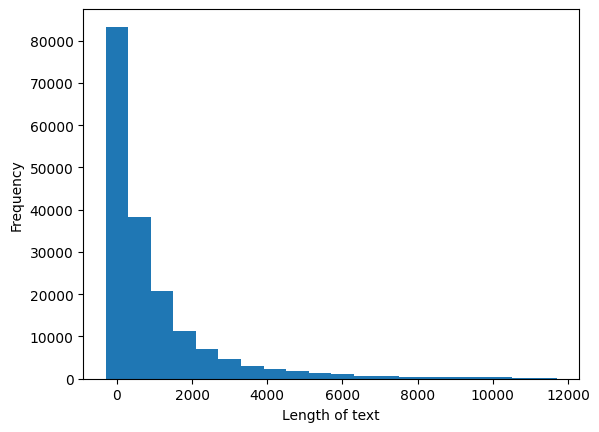

In [ ]:
if __name__ == "__main__":
  # EDA for text length
  x = list(df['content'].apply(lambda x:len(x)))
  plt.hist(x,range=[1,12000],bins = 20,align ='left')
  plt.rcParams["figure.figsize"] = (10,4)
  plt.xlabel("Length of text")
  plt.ylabel("Frequency")

In [ ]:
if __name__ == "__main__":
  for i in range(0,110,10):
    print("{}th- percentile of len(text) is {}".format(i,np.percentile(x, i)))
    print("="*40)
  x =None
  del(x)
  gc.collect()

0th- percentile of len(text) is 0.0
10th- percentile of len(text) is 100.0
20th- percentile of len(text) is 199.0
30th- percentile of len(text) is 325.0
40th- percentile of len(text) is 483.0
50th- percentile of len(text) is 687.0
60th- percentile of len(text) is 956.0
70th- percentile of len(text) is 1314.0
80th- percentile of len(text) is 1909.0
90th- percentile of len(text) is 3282.0
100th- percentile of len(text) is 1594315.0


**Observations**
- From above plot it is clear that length of text ranges from 0 to 1594315
- Distribution for the length of text is looks like power-law distribution
- Which has frequency for sort sentences higher than long sentences
- As we can see above from percentile values 90 percent of text has max length 3277 chars

## More EDA
**Visualize Email content using word cloud**

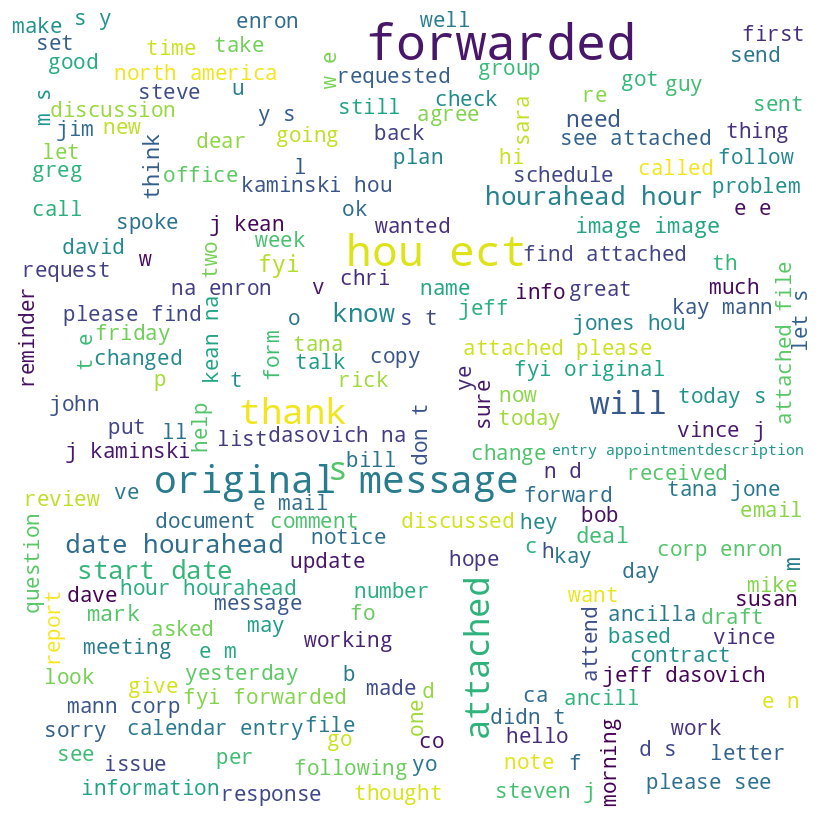

In [ ]:
if __name__ == "__main__":
  # Word cloud for content , X-TO, X-From
  wordcloud = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = STOPWORDS ,
                max_font_size = 50,
                min_font_size = 10).generate(df['content'].to_string())
  # plot the WordCloud image
  plt.figure(figsize = (8, 8), facecolor = None)
  plt.imshow(wordcloud)
  plt.axis("off")
  plt.tight_layout(pad = 0)

  plt.show()

**Find out most frequent words**
*   What idea can most frequent word give?
*   Analysis if any unwanted word is occuring many times



In [ ]:
# most frequent words
def word_count(str):
    '''
    Function that get string and counts each word in the string
    '''
    counts = dict()
    words = str.split()

    for word in words:
        if word in counts:
            counts[word] += 1
        elif(len(word)>2):
            counts[word] = 1
    return counts

In [ ]:
if __name__ == "__main__":
  # moost 100 frequent words in content
  most_frequent_words = Counter(word_count(str(df['content'].to_string()))).most_common(100)
  print('\n'.join(map(str, most_frequent_words)))
  most_frequent_words = None
  del(most_frequent_words)
  gc.collect()


('the', 55709)
('...', 32002)
('you', 27140)
('for', 18368)
('forwarded', 17007)
('this', 16368)
('and', 13695)
('from', 12579)
('have', 12192)
('please', 12119)
('attached', 10966)
('are', 10647)
('that', 9848)
('ect', 9708)
('hou', 9685)
('enron', 8996)
('message', 8887)
('your', 8548)
('original', 7973)
('with', 7878)
('will', 7203)
('thanks', 6452)
('here', 5932)
('fyi', 4770)
('just', 4749)
('has', 4705)
('can', 4506)
('sent', 4350)
('not', 4275)
('all', 4189)
('our', 4036)
('see', 3987)
('know', 3934)
('was', 3934)
('image', 3850)
('date', 3783)
('t...', 3664)
('2...', 3574)
('vince', 3536)
('what', 3455)
('start', 3402)
('mark', 3399)
('hourahead', 3393)
('would', 3364)
('jeff', 3309)
('hour', 3275)
('been', 3158)
('get', 3049)
('good', 2986)
('dear', 2952)
('com', 2921)
('about', 2905)
('out', 2852)
('call', 2842)
('corp', 2830)
('like', 2759)
('today', 2690)
('following', 2660)
('new', 2572)
('a...', 2521)
('let', 2520)
('meeting', 2509)
('need', 2497)
('find', 2483)
('there',

## Train - Test split

In [ ]:
shuffle_df = df.sample(frac=1, random_state=42)

# Define a size for your train set
train_size = int(0.7 * len(df))

# Split your dataset
train_set = shuffle_df[:train_size]
train_set.reset_index(inplace=True, drop=True)

test_set = shuffle_df[train_size:].copy()
test_set.reset_index(inplace=True, drop=True)

## Next Word prediction

In [ ]:
import pandas as pd
df = train_set.copy()
df.head()

,file,message,content,body_list
0,tholt-j/discussion_threads/174.,Message-ID: <1554784.1075857488732.JavaMail.ev...,forwarded by jane m tholt hou ect on 11 27 200...,"[forwarded, by, jane, m, tholt, hou, ect, on, ..."
1,kean-s/all_documents/409.,Message-ID: <530637.1075846150302.JavaMail.eva...,kelly raised this concern too the system is se...,"[kelly, raised, this, concern, too, the, syste..."
2,shapiro-r/japan/7.,Message-ID: <14842993.1075844258403.JavaMail.e...,some thoughts 1 we argue against the pjm insta...,"[some, thoughts, 1, we, argue, against, the, p..."
3,lay-k/all_documents/160.,Message-ID: <27787651.1075840204674.JavaMail.e...,mr christman thank you for your invitation for...,"[mr, christman, thank, you, for, your, invitat..."
4,mann-k/all_documents/3727.,Message-ID: <26662615.1075845667335.JavaMail.e...,we are pleased to announce organizational chan...,"[we, are, pleased, to, announce, organizationa..."


In [ ]:
corpus = df['body_list'].to_list()

### Creating a bi-gram model

In [ ]:
def build_bigram_model(corpus):
  # Create a placeholder for model
  bigram_model1 = defaultdict(lambda: defaultdict(lambda: 0))

  # Count frequency of co-occurance
  for sentence in corpus:
      for w1, w2 in bigrams(sentence, pad_right=True, pad_left=True):
          bigram_model1[(w1)][w2] += 1

  # Let's transform the counts to probabilities
  for w1 in bigram_model1:
      print(w1)
      break
      total_count = float(sum(bigram_model1[w1].values()))
      for w2 in bigram_model1[w1]:
          bigram_model1[w1][w2] /= total_count

  return bigram_model1

In [ ]:
bigram = build_bigram_model(corpus)

None


In [ ]:
def get_next_word(model, input_string):
    if len(input_string.split()) > 1:
        input_string_ = input_string.split()
        output = dict(model[tuple(input_string_)])
        return "{} {}".format(input_string,
            list({k: v for k, v in sorted(output.items(), key=lambda item: item[1], reverse=True)})[0])
    else:
        input_string = (input_string)
        output = dict(model[input_string])
        return "{} {}".format(input_string,
            list({k: v for k, v in sorted(output.items(), key=lambda item: item[1], reverse=True)})[0])

In [ ]:
get_next_word(bigram, 'how')

'how to'

In [ ]:
get_next_word(bigram, 'they')

'they are'

In [ ]:
get_next_word(bigram, 'we')

'we have'

In [ ]:
get_next_word(bigram, 'what')

'what is'

In [ ]:
get_next_word(bigram, 'can')

'can be'

In [ ]:
get_next_word(bigram, 'i')

'i have'

In [ ]:
get_next_word(bigram, 'have')

'have a'

In [ ]:
get_next_word(bigram, 'a')

'a href'

In [ ]:
get_next_word(bigram, 'href')

'href http'

In [ ]:
get_next_word(bigram, 'http')

'http www'

### NOTES : See how preprocessing steps that includes cleaning of urls is so important !

## Creating a Tri-gram Model

In [ ]:
def build_trigram_model(corpus):
  # Create a placeholder for model
  trigram_model = defaultdict(lambda: defaultdict(lambda: 0))

  # Count frequency of co-occurance
  for sentence in corpus:
    for w1, w2, w3 in trigrams(sentence, pad_right=True, pad_left=True):
        trigram_model[(w1, w2)][w3] += 1
          # break


  # Let's transform the counts to probabilities
  for w1_w2 in trigram_model:
    total_count = float(sum(trigram_model[w1_w2].values()))
    for w3 in trigram_model[w1_w2]:
        trigram_model[w1_w2][w3] /= total_count

  return trigram_model



In [ ]:
trigram_model = build_trigram_model(corpus)

In [ ]:
get_next_word(trigram_model,'i may')

'i may be'

In [ ]:
get_next_word(trigram_model,'can we')

'can we get'

In [ ]:
get_next_word(trigram_model,'i will')

'i will be'

In [ ]:
get_next_word(trigram_model,'will be')

'will be a'

In [ ]:
get_next_word(trigram_model,'be a')

'be a good'

In [ ]:
get_next_word(trigram_model,'a good')

'a good idea'

In [ ]:
get_next_word(trigram_model,'good idea')

'good idea to'

In [ ]:
def complete_sentence(model, input_str, count, ngrams=2):

  for i in range(count):
    curr_ngram = input_str.split()[-ngrams+1:]
    curr_ngram = " ".join(curr_ngram)
    nxt_word = get_next_word(model, curr_ngram).split()[-1]

    input_str += ' ' + nxt_word
    print('Step '+str(i)+' '+input_str)


In [ ]:
complete_sentence(trigram_model,'can we', 10, 3)

Step 0 can we get
Step 1 can we get the
Step 2 can we get the best
Step 3 can we get the best of
Step 4 can we get the best of luck
Step 5 can we get the best of luck in
Step 6 can we get the best of luck in your
Step 7 can we get the best of luck in your group
Step 8 can we get the best of luck in your group that
Step 9 can we get the best of luck in your group that were


### Perplexity

In [ ]:
def perplexity(n_gram, input_sentence):
    tokenized_sentence = input_sentence.split()
    pp_w = []
    N = len(tokenized_sentence)

    if n_gram == 2:
        tokenized_sentence.insert(0, None)
        tokenized_sentence.append(None)
        for i in tokenized_sentence[:-1]:
            try:
                pp_w.append(1 / (0.0001+bigram[(i)][tokenized_sentence[tokenized_sentence.index(i)+1]]))
            except:
                continue

    if n_gram == 3:
        tokenized_sentence.insert(0, None)
        tokenized_sentence.insert(0, None)
        tokenized_sentence.append(None)
        tokenized_sentence.append(None)
        for i in tokenized_sentence[:-1]:
            #smoothing applied(added 0.0001)
            pp_w.append(1/(0.0001+trigram_model[tuple([i, tokenized_sentence[tokenized_sentence.index(i)+1]])][tokenized_sentence[tokenized_sentence.index(i)+2]]))


    if np.prod(pp_w) != 0:
        return round(np.prod(pp_w)**(1/N), 2)
    else:
        print("Cant find perplexity for the sentence")

In [ ]:
perplexity_dict = {'content':[],'bi-gram_score':[], 'tri-gram_score':[]}
for i in range(20):
  try:
    body = test_set['content'][i]
    tri_gram = perplexity(3, test_set['content'][i])
    bi_gram = perplexity(2, test_set['content'][i])
    perplexity_dict['content'].append(body)
    perplexity_dict['bi-gram_score'].append(bi_gram)
    perplexity_dict['tri-gram_score'].append(tri_gram)
  except Exception as e:
    perplexity_dict['content'].append(body)
    perplexity_dict['bi-gram_score'].append(e)
    perplexity_dict['tri-gram_score'].append(e)
df2 = pd.DataFrame(perplexity_dict)
df2

Cant find perplexity for the sentence
Cant find perplexity for the sentence
Cant find perplexity for the sentence
Cant find perplexity for the sentence
Cant find perplexity for the sentence
Cant find perplexity for the sentence


/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: overflow encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


,content,bi-gram_score,tri-gram_score
0,hello could you be a dearest and send me a cop...,0.09,672.72
1,brent i would like this to become formal polic...,NaN,inf
2,sorry about this i forgot i ll give it a look ...,NaN,13.03
3,start date 1 31 02 hourahead hour 21 no ancill...,0.00,3.43
4,fyi original message from customernotices wgph...,0.05,8.49
5,eb 4102 has been reserved for this meeting adr...,0.03,227.93
6,you won t get me to bet on this one keffer joh...,NaN,inf
7,here is what vickie told me about capacity on ...,0.02,22.85
8,there is visupro data for trent on the network...,0.24,3022.00
9,i would like to set up a tee time for 2 people...,0.01,167.12


### Creating an n-gram model

In [ ]:
del bigram
del trigram_model
del df
del train_set
del STOPWORDS
del shuffle_df
gc.collect()

0

In [ ]:
def build_ngram_model(corpus, ngrams=2):
  ngram_model = defaultdict(lambda: defaultdict(lambda: 0))

  for sentence in tqdm(corpus):
    for i_ngram in range(ngrams, len(sentence)):
      ngram_model[tuple(sentence[i_ngram - ngrams + 1 :i_ngram])][sentence[i_ngram]]+=1

  for words in ngram_model:
    total_count = float(sum(ngram_model[words].values()))
    for w2 in ngram_model[words]:
        ngram_model[words][w2] /= total_count

  return ngram_model

ngram = build_ngram_model(corpus, ngrams=4)

100%|██████████| 126762/126762 [01:41<00:00, 1247.15it/s]


In [ ]:
complete_sentence(ngram,'how have you', 10, 4)

Step 0 how have you been
Step 1 how have you been able
Step 2 how have you been able to
Step 3 how have you been able to get
Step 4 how have you been able to get a
Step 5 how have you been able to get a copy
Step 6 how have you been able to get a copy of
Step 7 how have you been able to get a copy of the
Step 8 how have you been able to get a copy of the letter
Step 9 how have you been able to get a copy of the letter agreement


## Which MODEL is performing better ?

### Inference:
- We pick a language model that has the lowest perplexity score on the test data.


# Use cas 5 : Topic Modeling



## Problem Statement: what is being talked about in reviews?
You are working in the Musical Instruments department, and you've recently recieved a request to use review data, and figure out **what is being talked about**, and give that insight to sellers so they could possibly improve thier products.

### Things to keep in mind:
What do you think a solution to this would look like?

1. A ppt you show to the sellers?
2. A wordcloud of the what is being talked about in the reviews?
3. A list of topics?
4. A list of phrases/words being used?

If you were a sellar what would you be looking forward to?

Each type of solution has it's pros and cons.

1. Some are easy to do, but hard to correctly understand
   1. Example: Wordcloud. Wordcloud is easy to do, but it's very difficult to gain usable insight from it.
2. Some are easy to digest and consume, but hard to do correctly
   1. A list of topics: Very to easy to understand, but how would you generate these topics?

### Downloading Data

In [ ]:
!gdown 1gGazb-hGBiJnVy4WCoWFOFfzPdhlmqrV

Downloading...
From: https://drive.google.com/uc?id=1gGazb-hGBiJnVy4WCoWFOFfzPdhlmqrV
To: /content/Musical_Instruments_5.json
100% 7.45M/7.45M [00:00<00:00, 29.7MB/s]


---
## Preprocessing, Data Reading and simple EDA
---

In [ ]:
import pandas as pd
import numpy as np

review_data = pd.read_json("Musical_Instruments_5.json", lines=True)
review_data

,reviewerID,asin,reviewerName,helpful,reviewText,overall,summary,unixReviewTime,reviewTime
0,A2IBPI20UZIR0U,1384719342,"cassandra tu ""Yeah, well, that's just like, u...","[0, 0]","Not much to write about here, but it does exac...",5,good,1393545600,"02 28, 2014"
1,A14VAT5EAX3D9S,1384719342,Jake,"[13, 14]",The product does exactly as it should and is q...,5,Jake,1363392000,"03 16, 2013"
2,A195EZSQDW3E21,1384719342,"Rick Bennette ""Rick Bennette""","[1, 1]",The primary job of this device is to block the...,5,It Does The Job Well,1377648000,"08 28, 2013"
3,A2C00NNG1ZQQG2,1384719342,"RustyBill ""Sunday Rocker""","[0, 0]",Nice windscreen protects my MXL mic and preven...,5,GOOD WINDSCREEN FOR THE MONEY,1392336000,"02 14, 2014"
4,A94QU4C90B1AX,1384719342,SEAN MASLANKA,"[0, 0]",This pop filter is great. It looks and perform...,5,No more pops when I record my vocals.,1392940800,"02 21, 2014"
...,...,...,...,...,...,...,...,...,...
10256,A14B2YH83ZXMPP,B00JBIVXGC,Lonnie M. Adams,"[0, 0]","Great, just as expected. Thank to all.",5,Five Stars,1405814400,"07 20, 2014"
10257,A1RPTVW5VEOSI,B00JBIVXGC,Michael J. Edelman,"[0, 0]",I've been thinking about trying the Nanoweb st...,5,"Long life, and for some players, a good econom...",1404259200,"07 2, 2014"
10258,AWCJ12KBO5VII,B00JBIVXGC,Michael L. Knapp,"[0, 0]",I have tried coated strings in the past ( incl...,4,Good for coated.,1405987200,"07 22, 2014"
10259,A2Z7S8B5U4PAKJ,B00JBIVXGC,"Rick Langdon ""Scriptor""","[0, 0]","Well, MADE by Elixir and DEVELOPED with Taylor...",4,Taylor Made,1404172800,"07 1, 2014"


Hmm, the date format looks wierd. Let's fix that first

In [ ]:
review_data["reviewTime"] = pd.to_datetime(review_data["reviewTime"], format="%m %d, %Y")

Looks like we have reviews from 2005-2014, with most of the data coming from recent years.

<AxesSubplot:>

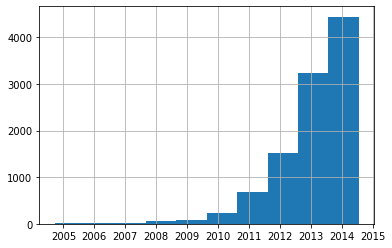

In [ ]:
review_data["reviewTime"].hist()

Looking at ratings, most reviews seem to be very positive.

<AxesSubplot:>

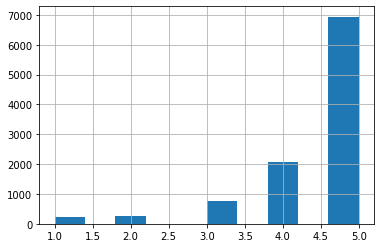

In [ ]:
review_data["overall"].hist()

Since we're not really concerned with the sentiment or ratings, for this problem statement we'll only be focusing on the review content

## What if we just count words?

What are the things being talked about in the reviews?

Let's first try a simple word counter, and see the top 10 words?

In [ ]:
from collections import Counter
def flatten(list_of_lists):
    flat_list = []
    for  l in list_of_lists:
        flat_list.extend(l)
    return flat_list


Let's install NLTK, spacy and wordcloud

In [ ]:
!pip install nltk
!pip install wordcloud
import nltk
nltk.download('all')

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


[nltk_data] Downloading collection 'all'
[nltk_data]    | 
[nltk_data]    | Downloading package abc to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/abc.zip.
[nltk_data]    | Downloading package alpino to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/alpino.zip.
[nltk_data]    | Downloading package averaged_perceptron_tagger to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data]    | Downloading package averaged_perceptron_tagger_ru to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Unzipping
[nltk_data]    |       taggers/averaged_perceptron_tagger_ru.zip.
[nltk_data]    | Downloading package basque_grammars to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Unzipping grammars/basque_grammars.zip.
[nltk_data]    | Downloading package bcp47 to /root/nltk_data...
[nltk_data]    | Downloading package biocreative_ppi to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   U

True

In [ ]:
from nltk.tokenize import word_tokenize
from wordcloud import WordCloud
from matplotlib import pyplot as plt

def wordcloud_plot(counter_all):
    w = WordCloud().generate_from_frequencies(frequencies=dict(counter_all))
    plt.imshow(w)

def tokenize(text):
    tokens = [w for w in word_tokenize(text.lower())]
    return tokens

In [ ]:
counter_all = Counter(flatten(review_data["reviewText"].apply(tokenize).tolist()))
counter_all.most_common(10)

[('.', 47090),
 ('the', 44092),
 (',', 35705),
 ('i', 30997),
 ('a', 27895),
 ('and', 26984),
 ('it', 24119),
 ('to', 23038),
 ('is', 14943),
 ('of', 13588)]

### Let's have a look at word distribution in our data

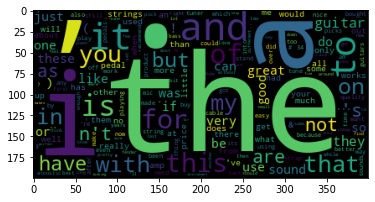

In [ ]:
wordcloud_plot(counter_all)

### The 10 most **common words seem to all be stop words** and/or punctuations.

The wordcloud also doesn't look very useful

## What if we remove stopwords?
Let's try and improve this with a simple stopword and punctuation remover, and using better word tokenization

In [ ]:
from nltk.corpus import stopwords

english_stopwords = set(stopwords.words('english'))

In [ ]:
def tokenize_clean(text):
    tokens = [w for w in word_tokenize(text.lower()) if w not in english_stopwords and w.isalpha()]
    return tokens

In [ ]:
counter_all = Counter(flatten(review_data["reviewText"].apply(tokenize_clean).tolist()))
counter_all.most_common(10)

[('guitar', 5472),
 ('one', 4402),
 ('great', 4026),
 ('like', 3897),
 ('use', 3724),
 ('good', 3720),
 ('sound', 3507),
 ('strings', 3349),
 ('well', 3042),
 ('get', 2657)]

### Let us now look at the updated wordcloud

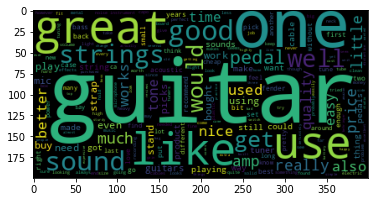

In [ ]:
wordcloud_plot(counter_all)

Much better now, but still **not very informative**, considering we care about **"what"** people are talking about.

### Most of the words seem to be about how someone "liked" something, or something was "good".

The wordcloud also looks much better!

#### The only useful things we got are "guitar" and "strings"...

In [ ]:
!pip install gensim
!pip install spacy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


## Wait, why don't we just filter in "useful" words?


Can we remove these "not useful" words? We know that all these reviews are in English, can we use some English Grammer concepts here?

---
## Understanding spaCy:  What if we extract all Nouns from the reviews?
---



- We can do this using [**spaCy**](https://spacy.io/)
- First, let's install spacy, and the english models for spacy


In [ ]:
!pip install spacy
!python -m spacy download en_core_web_sm

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
/usr/local/lib/python3.8/dist-packages/torch/cuda/__init__.py:497: UserWarning: Can't initialize NVML
  warnings.warn("Can't initialize NVML")
2023-03-07 10:01:14.418286: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-03-07 10:01:16.679897: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-03-07 10:01:16.680046: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could no

Now let's load the english model

In [ ]:
import spacy
nlp = spacy.load("en_core_web_sm")

/usr/local/lib/python3.8/dist-packages/torch/cuda/__init__.py:497: UserWarning: Can't initialize NVML
  warnings.warn("Can't initialize NVML")


#### Let's look at one of the reviews

In [ ]:
review_sample = review_data["reviewText"].iloc[0]
review_sample

"Not much to write about here, but it does exactly what it's supposed to. filters out the pop sounds. now my recordings are much more crisp. it is one of the lowest prices pop filters on amazon so might as well buy it, they honestly work the same despite their pricing,"

In [ ]:
spacy_process_review = nlp(review_sample)
spacy_process_review

Not much to write about here, but it does exactly what it's supposed to. filters out the pop sounds. now my recordings are much more crisp. it is one of the lowest prices pop filters on amazon so might as well buy it, they honestly work the same despite their pricing,

From the first glance, it looks similar, except the quotes (") have dissapeared. In fact, after processing, **spacy does NOT return a string object, but a custom spacy Document object!**

In [ ]:
type(spacy_process_review)

spacy.tokens.doc.Doc

Similarly, **each word in the document isn't a simple string either, but a Token object**! So spacy has done tokenisation and stuff for us already.

Each token object also has a lot of useful properties that we can use.

In [ ]:
spacy_process_review[0], type(spacy_process_review[0])

(Not, spacy.tokens.token.Token)

Here, we can get the part of speech (i.e. grammer classification) of each word. The word "Not" here, is a particle, denoted by "PART". But let's look for all Nouns!

## **How are these Part of Speech (POS) tags generated, though? What is spacy doing?**

- Spacy is using it's english pre-trained model, which was trained using tagged tree-bank data.

- This tree-bank dataset contains the POS tag for every word, and these datasets were labelled manually.

1. Model used could be Probabalistic HMM (Hidden Markov Model), which can be trained using a DP algo called Viterbi Algo
2. Model could also be a sequential neural network like RNN (Recurrent Neural Network), trained using backpropogation


#### Spacy recognises Noun as "NOUN" and proper nouns (names of spceific things like people, cities etc.) as seperate "PROPN"

In [ ]:
spacy_process_review[0].pos_

'PART'

Awesome! Now we can see the POS tags int this review, we can see that is talking about pop-sounds, recording, prices & filters, by just looking at the Nouns

In [ ]:
spacy_process_review

Not much to write about here, but it does exactly what it's supposed to. filters out the pop sounds. now my recordings are much more crisp. it is one of the lowest prices pop filters on amazon so might as well buy it, they honestly work the same despite their pricing,

In [ ]:
for tok in spacy_process_review:
    if tok.pos_ in ["NOUN", "PROPN"]:
        print(tok, tok.pos_)

pop NOUN
sounds NOUN
recordings NOUN
prices NOUN
filters NOUN
amazon NOUN
pricing NOUN


<!-- If we look at the next review, we also see something similar! We can see that this review is talking about screens, pop, filter, aroma, etc. This is definetly much faster than reading the entire review! -->

But we're still missing out on a lot of context, especially like "pop" and "sounds" are actually just parts of ONE thing, "pop sounds".

### It's not just the noun words we need... but entire NOUN PHRASE

## **We can achieve this by using constituency parsing.**

- Constituency parsing uses hand built rules. **These rules are often written usin CFG (Context Free Grammer) and Finite Automoata concepts.**

- The rules could be something simple like "NP -> Noun Noun". This basically means that 2 Nouns together, constitutes a Noun Phrase (NP)

- In reality though, it would look something like this, and be resolved using CFG rules
```
NP -> Noun
NP -> PropN
NP -> Adj [Adp] NP
```

![img](https://cdn.analyticsvidhya.com/wp-content/uploads/2020/07/np5.png)

If you use spacy, though, you don't need to worry about writing your own rules for getting Noun Phrases.

## **Spacy, treats pronouns as nouns as well.**

- While useful in many scenarios, we need to remove these noun chunks.
- Let's exclude all noun chunks which have no NOUN or PROPN.
- Spacy gives the "most expansive", i.e. largest viable noun chunks.
  - This can be very useful in many situation, however ours isn't really one of them.
- Let's also remove the non-noun parts of the noun-phrase, as our use case doesn't really need that.

In [ ]:
for c in spacy_process_review.noun_chunks:
    print(c, [t.pos_ for t in c])

it ['PRON']
exactly what ['ADV', 'PRON']
it ['PRON']
the pop sounds ['DET', 'NOUN', 'NOUN']
my recordings ['PRON', 'NOUN']
it ['PRON']
the lowest prices ['DET', 'ADJ', 'NOUN']
filters ['NOUN']
amazon ['NOUN']
it ['PRON']
they ['PRON']
their pricing ['PRON', 'NOUN']


In [ ]:
noun_checker = lambda x: any()

In [ ]:
for c in spacy_process_review.noun_chunks:
    new_nc = [t.text for t in c if t.pos_ in ["NOUN", "PROPN"]]
    if new_nc:
        print(new_nc)


['pop', 'sounds']
['recordings']
['prices']
['filters']
['amazon']
['pricing']


Looks much better now!

Before we move on, let's run this on all our reviews once, and see the results

In [ ]:
def get_noun_phrases(text):
    doc = nlp(text)
    required_nc = []
    for c in doc.noun_chunks:
        new_nc = [t.text for t in c if t.pos_ in ["NOUN", "PROPN"]]
        if new_nc:
            new_nc_text = " ".join(new_nc)
            required_nc.append(new_nc_text)
    return required_nc

In [ ]:
from tqdm.auto import tqdm
tqdm.pandas()

In [ ]:
review_data["noun_phrases"] = review_data["reviewText"].progress_apply(get_noun_phrases)

  0%|          | 0/10261 [00:00<?, ?it/s]

This looks so much more usable! Now if we run a counter on it again...

In [ ]:
review_data["noun_phrases"]

0        [pop sounds, recordings, prices, filters, amaz...
1        [product, bonus, screens, hint, smell, grape c...
2        [job, device, breath, popping sound, voice, re...
3        [MXL mic, pops, thing, gooseneck, screen, posi...
4                [pop filter, studio filter, vocals, pops]
                               ...                        
10256                                                   []
10257    [Nanoweb strings, while, price, strings, comme...
10258    [strings, past, Elixirs, disconnect, guitar, c...
10259    [Elixir, DEVELOPED, Taylor Guitars, strings, R...
10260    [strings, unwound strings, complaint, strings,...
Name: noun_phrases, Length: 10261, dtype: object

### Now this looks much better!
> It seems like most people are talking about the `guitars, strings, the pricing, how they sound, how much amp the devices have, thier tones etc.`

Much more useful than the previous iterations!

In [ ]:
counter_all = Counter(flatten(review_data["noun_phrases"].tolist()))
counter_all.most_common(10)

[('guitar', 3212),
 ('strings', 2526),
 ('price', 1795),
 ('sound', 1698),
 ('pedal', 1539),
 ('one', 1256),
 ('amp', 1173),
 ('time', 1146),
 ('tone', 1042),
 ('guitars', 984)]

But... these still aren't very actionable.
For example, **we still don't know what are people talking about regarding guitars? What word/words is it related to?**

## **For this, we can use something called as Dependency Parsing.**

In Dependecny Parsing, each SENTENCE is converted to a TREE, where every word is connected to some other words based on "grammatical closeness"

### Dependency trees can be visualized [here](https://explosion.ai/demos/displacy).

Here, the arrows represent a parent-child relationship. Here the is an arrow "love" --> "learning" would imply "love" is the parent of "learning"

Let's take a sample sentence and see it's dependencies.

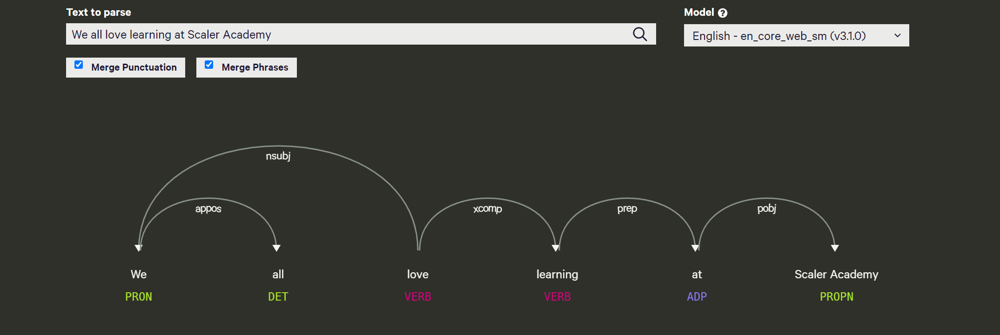

- Here, the word "love" has no arrows pointing towards itself, making "love" the ROOT of the tree, (i.e. it has no parent).
  - The ROOT is almost always the main VERB (action). In this example, "love" is the main action, with "love learning" being the main Verb Phrase.

- There is a connection of "love" --nsubj--> "We"
  - Here, the dependecy type is nsubj. nsubj represents the subject or the thing doing the action or the "who" of the action. i.e. Who does "love learning"? "We" does.

- This means "We" is a child of the word "love".
  - In dependency parsing, every parent child relationship has a unique label, which signifies the type of the relationship. This is called as the "dependency type".



- Similarly, the "learning" --prep--> "at" has the dependency type "prep" which shows "where". The "at" --pobj--> "Scaler Academy" finished the "where" question. i.e. Where does "love learning" happen? "At". "At" where? "At" "Scaler Academy".

BTW all POS tags and Dependency labels can be found at https://spacy.io/models/en#en_core_web_sm-labels

### Now, let's try to just get the parent of all the noun phrases we got, and attach them?

In [ ]:
def get_noun_phrases_parent(text):
    doc = nlp(text)
    required_nc = []
    for c in doc.noun_chunks:
        nc_parent = c.root.head
        new_nc = [t.text for t in c if t.pos_ in ["NOUN", "PROPN"]]
        if new_nc:
            new_nc_text = " ".join(new_nc) + "->" + nc_parent.text
            required_nc.append(new_nc_text)
    return required_nc

In [ ]:
review_data["noun_phrases_parent"] = review_data["reviewText"].progress_apply(get_noun_phrases_parent)

  0%|          | 0/10261 [00:00<?, ?it/s]

In [ ]:
counter_all = Counter(flatten(review_data["noun_phrases_parent"].tolist()))
counter_all.most_common(10)

[('price->for', 583),
 ('years->for', 503),
 ('guitar->on', 400),
 ('thing->is', 347),
 ('strings->are', 278),
 ('pedal->is', 261),
 ('guitar->of', 255),
 ('tune->in', 255),
 ('job->does', 245),
 ('strings->of', 242)]

### Hmm that turned out to not be adding much information for our purpose
- We can try more things, like
  - looking at at the dependency type of the noun phrase
  - looking at their siblings, (i.e. the words that are connected to the parent noun phrase, but not the noun phrase itself).

Also, do notice that the counts are now much lower, earlier "guitar" had occoured nearly 3000 times, but now the most common set is only at 500 times.


## Topic Modelling
---

In [ ]:
from gensim.corpora.dictionary import Dictionary
from gensim.models import LdaModel

### Let's first convert the data into a bag of words document matrix, so we can pass it to the LDAModel.

- For this, we'd have to build, the vocabulary, i.e. set of unique words. We can then use this Vocab to convert each document to bag of words.
- However, genesim's LDA models don't directly deal with strings, they take list of strings, i.e. pre-tokenized documents.
- Let's use the same tokenized and stopword removed, we first used.

In [ ]:
tokenized_clean_reviews = review_data["reviewText"].apply(tokenize_clean)

In [ ]:
tokenized_clean_reviews

0        [much, write, exactly, supposed, filters, pop,...
1        [product, exactly, quite, realized, double, sc...
2        [primary, job, device, block, breath, would, o...
3        [nice, windscreen, protects, mxl, mic, prevent...
4        [pop, filter, great, looks, performs, like, st...
                               ...                        
10256                             [great, expected, thank]
10257    [thinking, trying, nanoweb, strings, bit, put,...
10258    [tried, coated, strings, past, including, elix...
10259    [well, made, elixir, developed, taylor, guitar...
10260    [strings, really, quite, good, would, call, pe...
Name: reviewText, Length: 10261, dtype: object

In [ ]:
vocabulary = Dictionary(tokenized_clean_reviews)
vocabulary

### We can then directly use the `doc2bow` of the vocabulary to convert the document to a BOW

In [ ]:
bag_of_words_documents = [vocabulary.doc2bow(text) for text in tokenized_clean_reviews]
# bag_of_words_documents

Let's train for 10 topics now!

In [ ]:
lda = LdaModel(bag_of_words_documents, num_topics=10, id2word=vocabulary)

And let's see the topics.

### The number in front of each word represents the *contribution* of each word in that topic.

### Looks like the topics are about Mics, Guitars, Guitar Capos, Guitar picks, Tuning, Pedels and Amp etc.

### This definetly helps us answer "What is being talked about in the reviews?"!

In [ ]:
lda.print_topics()

[(0,
  '0.020*"great" + 0.014*"good" + 0.012*"sound" + 0.012*"strings" + 0.011*"quality" + 0.011*"price" + 0.010*"would" + 0.009*"time" + 0.008*"use" + 0.007*"well"'),
 (1,
  '0.013*"guitar" + 0.010*"one" + 0.009*"case" + 0.008*"bag" + 0.008*"tuner" + 0.007*"well" + 0.007*"like" + 0.006*"strings" + 0.006*"use" + 0.006*"fit"'),
 (2,
  '0.011*"amp" + 0.010*"stand" + 0.010*"sound" + 0.009*"use" + 0.008*"like" + 0.008*"one" + 0.007*"would" + 0.007*"great" + 0.007*"get" + 0.006*"also"'),
 (3,
  '0.019*"great" + 0.016*"tone" + 0.013*"good" + 0.012*"really" + 0.012*"amp" + 0.011*"guitar" + 0.010*"one" + 0.008*"time" + 0.008*"well" + 0.007*"sound"'),
 (4,
  '0.032*"strap" + 0.010*"use" + 0.009*"leather" + 0.009*"guitar" + 0.008*"like" + 0.008*"good" + 0.008*"one" + 0.007*"nice" + 0.007*"button" + 0.006*"would"'),
 (5,
  '0.032*"strings" + 0.026*"guitar" + 0.012*"tuner" + 0.011*"tune" + 0.011*"string" + 0.011*"capo" + 0.008*"one" + 0.008*"use" + 0.008*"great" + 0.008*"like"'),
 (6,
  '0.019*"ca

### Conclusion
- Parts Of Speech tagging marks a word in the text as corresponding to a particular part of speech.
- Spacy internally uses Probabilistic HMMs or Sequential Neural Nets to perform POS tagging.
- Constituency parsing & Dependancy trees can be used for topic modeling. However, their performance and capacity are limited.
- Latent Dirichlet Algorithm is a simple, yet powerful algorithm for topic modeling.

# Use case 6 : Classify News Headlines

## How to classify a news headline into a relevant category?

`You are an DL Engineer at BBC.`

**`Problem Statement`:** BBC wants to auto categorize the news into various categories which will also help in recommending the right news articles to it users at a later stage.


`Note:` *BBC - British Broadcasting Corporation*

### Dataset

A sample of 2225 news article and their relavant category.

**Attribute information:**
- filename - name of the file for that news.
- title - the headline of the news
- content - main news content.
- **category** - target variable that describes the type of a news item.


In [ ]:
import pandas as pd
import numpy as np
from IPython.display import Image
from tqdm import tqdm
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import confusion_matrix, accuracy_score
import re
import matplotlib.pyplot as plt

In [ ]:
!gdown 1POmzYEQZgZVqJO3F_cyNcd4QmoNE_mCv

Downloading...
From: https://drive.google.com/uc?id=1POmzYEQZgZVqJO3F_cyNcd4QmoNE_mCv
To: /content/bbc-news-data.csv
100% 5.08M/5.08M [00:00<00:00, 189MB/s]


---
## Reading the dataset
---

In [ ]:
df = pd.read_csv("/content/bbc-news-data.csv", sep="\t")
df

,category,filename,title,content
0,business,001.txt,Ad sales boost Time Warner profit,Quarterly profits at US media giant TimeWarne...
1,business,002.txt,Dollar gains on Greenspan speech,The dollar has hit its highest level against ...
2,business,003.txt,Yukos unit buyer faces loan claim,The owners of embattled Russian oil giant Yuk...
3,business,004.txt,High fuel prices hit BA's profits,British Airways has blamed high fuel prices f...
4,business,005.txt,Pernod takeover talk lifts Domecq,Shares in UK drinks and food firm Allied Dome...
...,...,...,...,...
2220,tech,397.txt,BT program to beat dialler scams,BT is introducing two initiatives to help bea...
2221,tech,398.txt,Spam e-mails tempt net shoppers,Computer users across the world continue to i...
2222,tech,399.txt,Be careful how you code,A new European directive could put software w...
2223,tech,400.txt,US cyber security chief resigns,The man making sure US computer networks are ...


In [ ]:
# Dropping the empty sub-title
print(df.shape)
df = df[((~df.title.isnull()) & (~df.content.isnull()))].reset_index(drop=True)
print(df.shape)

df

(2225, 4)
(2225, 4)


,category,filename,title,content
0,business,001.txt,Ad sales boost Time Warner profit,Quarterly profits at US media giant TimeWarne...
1,business,002.txt,Dollar gains on Greenspan speech,The dollar has hit its highest level against ...
2,business,003.txt,Yukos unit buyer faces loan claim,The owners of embattled Russian oil giant Yuk...
3,business,004.txt,High fuel prices hit BA's profits,British Airways has blamed high fuel prices f...
4,business,005.txt,Pernod takeover talk lifts Domecq,Shares in UK drinks and food firm Allied Dome...
...,...,...,...,...
2220,tech,397.txt,BT program to beat dialler scams,BT is introducing two initiatives to help bea...
2221,tech,398.txt,Spam e-mails tempt net shoppers,Computer users across the world continue to i...
2222,tech,399.txt,Be careful how you code,A new European directive could put software w...
2223,tech,400.txt,US cyber security chief resigns,The man making sure US computer networks are ...


Text(0, 0.5, 'Count')

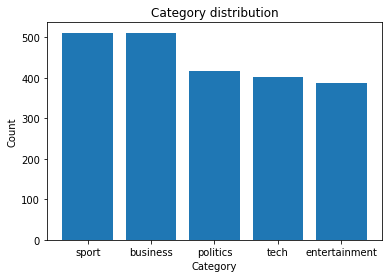

In [ ]:
plt.bar(df.category.value_counts().index, df.category.value_counts().values)
plt.title('Category distribution')
plt.xlabel("Category")
plt.ylabel("Count")

Let's take a look at one of the sample example of how the data looks like

In [ ]:
ind=1807
print(f'Title: {df.title[ind]}')
print(f'Category: {df.category[ind]}')

Title: Federer joins all-time greats
Category: sport


In [ ]:
from tensorflow.keras.preprocessing.se`quence import pad_sequences
from tensorflow.keras.layers import Dense, Embedding, Input, InputLayer, RNN, SimpleRNN, LSTM, GRU, TimeDistributed
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
import tensorflow as tf

import string

import nltk
nltk.download('stopwords')

from nltk.corpus import stopwords
stop_words = stopwords.words('english')

from sklearn.model_selection import train_test_split

import matplotlib.pyplot as plt
import seaborn as sns

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


## Text cleaning

In [ ]:
def data_cleaning(text):

    # Lower the words in the sentence
    cleaned = text.lower()

    # Replace the full stop with a full stop and space
    cleaned = cleaned.replace(".", ". ")

    # Remove the stop words : optional pre-processing step
    tokens = [word for word in cleaned.split() if not word in stop_words]

    # Remove the punctuations
    tokens = [tok.translate(str.maketrans(' ', ' ', string.punctuation)) for tok in tokens]

    # Joining the tokens back to form the sentence
    cleaned = " ".join(tokens)

    # Remove any extra spaces
    cleaned = cleaned.strip()

    return cleaned


In [ ]:
for index, data in tqdm(df.iterrows(), total=df.shape[0]):
    df.loc[index, 'title'] = data_cleaning(data['title'])


100%|██████████| 2225/2225 [00:00<00:00, 6153.12it/s]


## Fixing the sequence length

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


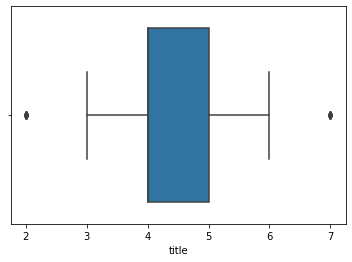

In [ ]:
sns.boxplot(df['title'].str.split(" ").str.len())

As we can see that maximum number of words in the title is 7, we can set the sequence length to be the max words in the longest sentence.

In [ ]:
max_sentence_len = df['title'].str.split(" ").str.len().max()
total_classes = df.category.nunique()

print(f"Maximum sequence length: {max_sentence_len}")
print(f"Total classes: {total_classes}")

Maximum sequence length: 7
Total classes: 5


## Splitting the data to train and test

In [ ]:
np.random.seed(100)
train_X, test_X, train_Y, test_Y = train_test_split(df['title'],
                                                    df['category'],
                                                    test_size=0.2,
                                                    random_state=100)
train_X = train_X.reset_index(drop=True)
test_X = test_X.reset_index(drop=True)
train_Y = train_Y.reset_index(drop=True)
train_Y = train_Y.reset_index(drop=True)

In [ ]:
train_X.shape, train_Y.shape, test_X.shape, test_Y.shape

((1780,), (1780,), (445,), (445,))

## One hot Encode the labels

In [ ]:
train_Y = pd.get_dummies(train_Y).values
test_Y = pd.get_dummies(test_Y).values

In [ ]:
validation = test_Y.argmax(axis=1)

## Tokenize the input text and pad them

In [ ]:
def tokenize_and_pad(inp_text, max_len, tok):

    text_seq = tok.texts_to_sequences(inp_text)
    text_seq = pad_sequences(text_seq, maxlen=max_len, padding='post')

    return text_seq

text_tok = Tokenizer()
text_tok.fit_on_texts(train_X)
train_text_X = tokenize_and_pad(inp_text=train_X, max_len=max_sentence_len, tok=text_tok)
test_text_X = tokenize_and_pad(inp_text=test_X, max_len=max_sentence_len, tok=text_tok)
vocab_size = len(text_tok.word_index)+1

print("Overall text vocab size", vocab_size)

Overall text vocab size 3360


## Choose the latent dimension and embedding dimension

<b>Latent dimension</b>: Dimension of the weight matrix U, V, W
<br>
<b>Embedding dimension</b>: Dimension of the word embeddings at the embedding layer

In [ ]:
latent_dim=50
embedding_dim=100

## Define the RNN model architecture

* The embedding layer with 100 dimension
* A single Vanilla RNN unit with 50 dimensions
* A final output layer with 5 units(5 classes) with the softmax activation function

In [ ]:
seed=56
tf.random.set_seed(seed)
np.random.seed(seed)

model = Sequential()
model.add(Embedding(vocab_size, embedding_dim, trainable=True))
model.add(SimpleRNN(latent_dim, recurrent_dropout=0.2, return_sequences=False, activation='tanh'))
model.add(Dense(total_classes, activation='softmax'))
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, None, 100)         336000    
                                                                 
 simple_rnn (SimpleRNN)      (None, 50)                7550      
                                                                 
 dense (Dense)               (None, 5)                 255       
                                                                 
Total params: 343,805
Trainable params: 343,805
Non-trainable params: 0
_________________________________________________________________


## Model training

* Optimizer: Adam
* Loss: Categorical cross-entrophy since it is a multiclass classification probem
* Early stopping: Used to stop training if validation accuracy does not improve while training to avoid overfitting

In [ ]:
tf.random.set_seed(seed)
np.random.seed(seed)

model.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['acc'])

early_stopping = EarlyStopping(monitor='val_acc',
                               mode='max',
                               verbose=1,
                               patience=5)

model.fit(x=train_text_X, y=train_Y,
          validation_data=(test_text_X, test_Y),
          batch_size=64,
          epochs=10,
          callbacks=[early_stopping])

In [ ]:
seed=56
tf.random.set_seed(seed)
np.random.seed(seed)

model_clipping = Sequential()
model_clipping.add(Embedding(vocab_size, embedding_dim, trainable=True))
model_clipping.add(SimpleRNN(latent_dim, recurrent_dropout=0.2, return_sequences=False, activation='tanh'))
model_clipping.add(Dense(total_classes, activation='softmax'))
model_clipping.summary()

In [ ]:

tf.random.set_seed(seed)
np.random.seed(seed)
# Define a maximum gradient norm threshold
max_norm = 1.0

# Compile the model with a loss function and optimizer
model_clipping.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['acc'])

# Define a callback to clip the gradients during training
class GradientClipping(tf.keras.callbacks.Callback):
    def on_batch_end(self, batch, logs=None):
        grads = self.model_clipping.optimizer.get_gradients(self.model_clipping.total_loss, self.model_clipping.trainable_variables)
        clipped_grads, _ = tf.clip_by_global_norm(grads, max_norm)
        self.model_clipping.optimizer.apply_gradients(zip(clipped_grads, self.model_clipping.trainable_variables))

# Fit the model to the training data
model_clipping.fit(x=train_text_X, y=train_Y,
          validation_data=(test_text_X, test_Y),
          batch_size=64,
          epochs=10, callbacks=[GradientClipping()])






## Save the trained model

In [ ]:
model.save("BCC_classifier.h5")
model_clipping.save("BCC_classifier_clipping.hs")

## Load the saved model

In [ ]:
model = tf.keras.models.load_model("BCC_classifier.h5")

## Make predictions on the test dataset

In [ ]:
prediction = model.predict(test_text_X)
prediction = prediction.argmax(axis=1)
print(f"Accuracy: {accuracy_score(prediction, validation)}")

## Confusion matrix of the prediction and actual

In [ ]:
cm = confusion_matrix(validation, prediction)

# print("")
# plt.figure(figsize=(15,15))
sns.heatmap(cm, annot=True, cmap='Oranges')
plt.xlabel("Prediction")
plt.ylabel("Actual")
plt.title("Confusion Matrix")

# Use case 7

## How inshorts delivers news in less than 60 words

* Inshorts is a news app started in 2013 which delivers news in less than 60 words.
* In this business use case we will look at how we can train a news summarisation model using Recurrent Neural Networks.
* This means that when we pass an input of M words, it outputs N words which is the summary of the News article where N<M.
* In this business case we will try to summarize news which are 40-60 words in less than 30 words.

In [ ]:
# Setup some configuration parameters

config = {'min_text_len':40,
          'max_text_len':60,
          'max_summary_len':30,
          'latent_dim' : 300,
          'embedding_dim' : 200}

---
## Reading the dataset
---

In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

In [ ]:
!gdown 1sui9RXxVsPDa4s2kooQwRGhb8taZhcgD
!gdown 1H3gdo7SLBiWE_GGD6_xcdAp2wJJFcd5L

In [ ]:
from rouge_score import rouge_scorer

summary = pd.read_csv('news_summary.csv', encoding='iso-8859-1')
raw = pd.read_csv('news_summary_more.csv', encoding='iso-8859-1')

raw = raw.rename(columns = {'headlines':'summary'})
summary = summary[['headlines', 'text']].rename(columns={'headlines':'summary'})

# Concatenate the summary and the raw files
df = pd.concat([raw, summary]).reset_index(drop=True)

summary.shape, raw.shape

### Distribution of words before filtering

In [ ]:
fig, ax =plt.subplots(1,2, figsize=(20,2.5))
sns.boxplot(raw.text.str.split().str.len(), ax=ax[0])
ax[0].set_title('text')
sns.boxplot(raw.summary.str.split().str.len(), ax=ax[1])
ax[1].set_title('summary')

fig.show()

### Filter text in the range between 40 and 60 words

In [ ]:
print(f'Before filtering: {raw.shape}')
pre = df.loc[((df['text'].str.split(" ").str.len()>config['min_text_len'])
               &(df['text'].str.split(" ").str.len()<config['max_text_len']))].reset_index(drop=True)
print(f'After filtering: {pre.shape}')

### Distribution of words after filtering

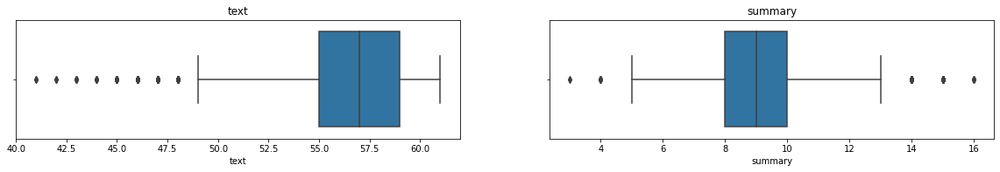

In [ ]:
fig, ax =plt.subplots(1,2, figsize=(20,2.5))
sns.boxplot(pre.text.str.split().str.len(), ax=ax[0])
ax[0].set_title('text')
sns.boxplot(pre.summary.str.split().str.len(), ax=ax[1])
ax[1].set_title('summary')

fig.show()

### Let's look at a sample

In [ ]:
ind = 1
print(f'Text: {pre.text[ind]}')
print()
print(f'Summary: {pre.summary[ind]}')
print()
print(f'Text length: {len(pre.text[ind].split())}')
print(f'Summary length: {len(pre.summary[ind].split())}')


Text: India recorded their lowest ODI total in New Zealand after getting all out for 92 runs in 30.5 overs in the fourth ODI at Hamilton on Thursday. Seven of India's batsmen were dismissed for single-digit scores, while their number ten batsman Yuzvendra Chahal top-scored with 18*(37). India's previous lowest ODI total in New Zealand was 108.

Summary: India get all out for 92, their lowest ODI total in New Zealand

Text length: 56
Summary length: 13


In [ ]:
import nltk
nltk.download('all')

[nltk_data] Downloading collection 'all'
[nltk_data]    | 
[nltk_data]    | Downloading package abc to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/abc.zip.
[nltk_data]    | Downloading package alpino to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/alpino.zip.
[nltk_data]    | Downloading package averaged_perceptron_tagger to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data]    | Downloading package averaged_perceptron_tagger_ru to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Unzipping
[nltk_data]    |       taggers/averaged_perceptron_tagger_ru.zip.
[nltk_data]    | Downloading package basque_grammars to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Unzipping grammars/basque_grammars.zip.
[nltk_data]    | Downloading package biocreative_ppi to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Unzipping corpora/biocreative_ppi.zip.
[nltk_data]    | Downloadin

True

In [ ]:
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.layers import Dense, Embedding, Input, InputLayer, RNN, SimpleRNN, LSTM, Bidirectional, TimeDistributed
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
import tensorflow as tf

import string
from nltk.corpus import stopwords
stop_words = stopwords.words('english')

from sklearn.model_selection import train_test_split

import spacy
from time import time
import numpy as np


## Text preprocessing

In [ ]:
import re

# Remove non-alphabetic characters (Data Cleaning)
def text_strip(sentence):

    sentence = re.sub("(\\t)", " ", str(sentence)).lower()
    sentence = re.sub("(\\r)", " ", str(sentence)).lower()
    sentence = re.sub("(\\n)", " ", str(sentence)).lower()

    # Remove - if it occurs more than one time consecutively
    sentence = re.sub("(--+)", " ", str(sentence)).lower()

    # Remove . if it occurs more than one time consecutively
    sentence = re.sub("(\.\.+)", " ", str(sentence)).lower()

    # Remove the characters - <>()|&©ø"',;?~*!
    sentence = re.sub(r"[<>()|&©ø\[\]\'\",;?~*!]", " ", str(sentence)).lower()

    # Remove \x9* in text
    sentence = re.sub(r"(\\x9\d)", " ", str(sentence)).lower()

    # Replace CM# and CHG# to CM_NUM
    sentence = re.sub("([cC][mM]\d+)|([cC][hH][gG]\d+)", "CM_NUM", str(sentence)).lower()

    # Remove punctuations at the end of a word
    sentence = re.sub("(\.\s+)", " ", str(sentence)).lower()
    sentence = re.sub("(\-\s+)", " ", str(sentence)).lower()
    sentence = re.sub("(\:\s+)", " ", str(sentence)).lower()

    # Remove multiple spaces
    sentence = re.sub("(\s+)", " ", str(sentence)).lower()

    return sentence

## Get the cleaned text and Add start, end tokens

In [ ]:
pre['cleaned_text'] = pre.text.apply(lambda x: text_strip(x))
pre['cleaned_summary'] = pre.summary.apply(lambda x: '_START_ '+ text_strip(x) + ' _END_')
pre['cleaned_summary'] = pre['cleaned_summary'].apply(lambda x: 'sostok ' + x + ' eostok')
pre

,summary,text,cleaned_text,cleaned_summary
0,Rahat Fateh Ali Khan denies getting notice for...,Pakistani singer Rahat Fateh Ali Khan has deni...,pakistani singer rahat fateh ali khan has deni...,sostok _START_ rahat fateh ali khan denies get...
1,"India get all out for 92, their lowest ODI tot...",India recorded their lowest ODI total in New Z...,india recorded their lowest odi total in new z...,sostok _START_ india get all out for 92 their ...
2,Called PM Modi 'sir' 10 times to satisfy his e...,Andhra Pradesh CM N Chandrababu Naidu has said...,andhra pradesh cm n chandrababu naidu has said...,sostok _START_ called pm modi sir 10 times to ...
3,81-yr-old woman conducts physical training in ...,"Isha Ghosh, an 81-year-old member of Bharat Sc...",isha ghosh an 81-year-old member of bharat sco...,sostok _START_ 81-yr-old woman conducts physic...
4,"Karan Johar, Tabu turn showstoppers on opening...",Filmmaker Karan Johar and actress Tabu turned ...,filmmaker karan johar and actress tabu turned ...,sostok _START_ karan johar tabu turn showstopp...
...,...,...,...,...
54567,Prosthetic fingers on sale to rig UP election:...,An investigation by India Today has unmasked a...,an investigation by india today has unmasked a...,sostok _START_ prosthetic fingers on sale to r...
54568,"Kangana, Shahid, Saif starrer 'Rangoon' hits t...","The Kangana Ranaut, Shahid Kapoor and Saif Ali...",the kangana ranaut shahid kapoor and saif ali ...,sostok _START_ kangana shahid saif starrer ran...
54569,Ticket collector bites off senior officer?s no...,A ticket collector on Thursday allegedly bit o...,a ticket collector on thursday allegedly bit o...,sostok _START_ ticket collector bites off seni...
54570,Shouldn't rob their childhood: Aamir on kids r...,"Aamir Khan, while talking about reality shows ...",aamir khan while talking about reality shows o...,sostok _START_ shouldn t rob their childhood a...


In [ ]:
print(pre.shape)
post_pre = pre[((pre.cleaned_text.str.split().str.len()<=config['max_text_len']) &
                (pre.summary.str.split().str.len()<=(config['max_summary_len']+4)))].copy()
post_pre = post_pre.reset_index(drop=True)
print(post_pre.shape)

post_pre = post_pre.drop(['text', 'summary'], axis=1)
post_pre = post_pre.rename(columns = {'cleaned_text':'text',
                                      'cleaned_summary':'summary'})
post_pre

(54572, 4)
(47500, 4)


,text,summary
0,pakistani singer rahat fateh ali khan has deni...,sostok _START_ rahat fateh ali khan denies get...
1,india recorded their lowest odi total in new z...,sostok _START_ india get all out for 92 their ...
2,andhra pradesh cm n chandrababu naidu has said...,sostok _START_ called pm modi sir 10 times to ...
3,isha ghosh an 81-year-old member of bharat sco...,sostok _START_ 81-yr-old woman conducts physic...
4,filmmaker karan johar and actress tabu turned ...,sostok _START_ karan johar tabu turn showstopp...
...,...,...
47495,indian captain virat kohli on friday got out w...,sostok _START_ virat kohli out for a duck for ...
47496,srinivas kunchubhotla 32 an indian engineer wa...,sostok _START_ indian shot dead in us over all...
47497,an investigation by india today has unmasked a...,sostok _START_ prosthetic fingers on sale to r...
47498,a ticket collector on thursday allegedly bit o...,sostok _START_ ticket collector bites off seni...


## Split the train and validation dataset

In [ ]:
x_train, x_valid, y_train, y_valid = train_test_split(np.array(post_pre["text"]),
                                            np.array(post_pre["summary"]),
                                            test_size=0.1,
                                            random_state=0,
                                            shuffle=True
                                           )

x_train.shape, x_valid.shape, y_train.shape, y_valid.shape

((42750,), (4750,), (42750,), (4750,))

In [ ]:
def get_rare_words(text_col):

    # Prepare a tokenizer on testing data
    text_tokenizer = Tokenizer()
    text_tokenizer.fit_on_texts(list(text_col))

    thresh = 5

    cnt = 0
    tot_cnt = 0

    for key, value in text_tokenizer.word_counts.items():
        tot_cnt = tot_cnt + 1
        if value < thresh:
            cnt = cnt + 1

    print("% of rare words in vocabulary:",(cnt / tot_cnt) * 100)

    return cnt, tot_cnt

### Tokenize the train dataset

In [ ]:
x_train_cnt, x_train_tot_cnt = get_rare_words(text_col=x_train)

% of rare words in vocabulary: 64.22363847045192


In [ ]:
# Prepare a tokenizer, again -- by not considering the rare words
x_tokenizer = Tokenizer(num_words=x_train_tot_cnt - x_train_cnt)
# x_tokenizer = Tokenizer(num_words = x_train_tot_cnt)
x_tokenizer.fit_on_texts(list(x_train))

# Convert text sequences to integer sequences
x_tr_seq = x_tokenizer.texts_to_sequences(x_train)
x_val_seq = x_tokenizer.texts_to_sequences(x_valid)

# Pad zero upto maximum length
x_tr = pad_sequences(x_tr_seq,  maxlen=config['max_text_len'], padding='post')
x_val = pad_sequences(x_val_seq, maxlen=config['max_text_len'], padding='post')

# Size of vocabulary (+1 for padding token)
x_voc = x_tokenizer.num_words + 1

print("Size of vocabulary in X = {}".format(x_voc))

Size of vocabulary in X = 20996


### Tokenize the validation dataset

In [ ]:
y_train_cnt, y_train_tot_cnt = get_rare_words(text_col=y_train)

% of rare words in vocabulary: 66.49736426949863


In [ ]:
# Prepare a tokenizer, again -- by not considering the rare words
y_tokenizer = Tokenizer(num_words=y_train_tot_cnt - y_train_cnt)
# y_tokenizer = Tokenizer(num_words=y_train_tot_cnt)
y_tokenizer.fit_on_texts(list(y_train))

# Convert text sequences to integer sequences
y_tr_seq = y_tokenizer.texts_to_sequences(y_train)
y_val_seq = y_tokenizer.texts_to_sequences(y_valid)

# Pad zero upto maximum length
y_tr = pad_sequences(y_tr_seq, maxlen=config['max_summary_len'], padding='post')
y_val = pad_sequences(y_val_seq, maxlen=config['max_summary_len'], padding='post')

# Size of vocabulary (+1 for padding token)
y_voc = y_tokenizer.num_words + 1

print("Size of vocabulary in Y = {}".format(y_voc))

Size of vocabulary in Y = 8708


## Initialize the Encoder and Decoder architecture

In [ ]:
latent_dim = config['latent_dim']
embedding_dim = config['embedding_dim']
max_text_len = config['max_text_len']
max_summary_len = config['max_summary_len']

# Encoder
encoder_inputs = Input(shape=(max_text_len, ))

# Embedding layer
enc_emb = Embedding(x_voc, embedding_dim,
                    trainable=True)(encoder_inputs)

# Encoder LSTM 1
encoder_lstm1 = LSTM(latent_dim, return_sequences=True,
                     return_state=True, dropout=0.4,
                     recurrent_dropout=0.4)
(encoder_output1, state_h1, state_c1) = encoder_lstm1(enc_emb)

# Encoder LSTM 2
encoder_lstm2 = LSTM(latent_dim, return_sequences=True,
                     return_state=True, dropout=0.4,
                     recurrent_dropout=0.4)
(encoder_output2, state_h2, state_c2) = encoder_lstm2(encoder_output1)

# Encoder LSTM 3
encoder_lstm3 = LSTM(latent_dim, return_state=True,
                     return_sequences=True, dropout=0.4,
                     recurrent_dropout=0.4)
(encoder_outputs, state_h, state_c) = encoder_lstm3(encoder_output2)

# Set up the decoder, using encoder_states as the initial state
decoder_inputs = Input(shape=(None, ))

# Embedding layer
dec_emb_layer = Embedding(y_voc, embedding_dim, trainable=True)
dec_emb = dec_emb_layer(decoder_inputs)

# Decoder LSTM
decoder_lstm = LSTM(latent_dim, return_sequences=True,
                    return_state=True, dropout=0.4,
                    recurrent_dropout=0.2)
(decoder_outputs, decoder_fwd_state, decoder_back_state) = \
    decoder_lstm(dec_emb, initial_state=[state_h, state_c])

# Dense layer
decoder_dense = TimeDistributed(Dense(y_voc, activation='softmax'))
decoder_outputs = decoder_dense(decoder_outputs)

# Define the model
model = Model([encoder_inputs, decoder_inputs], decoder_outputs)

model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 60)]         0           []                               
                                                                                                  
 embedding (Embedding)          (None, 60, 200)      4199200     ['input_1[0][0]']                
                                                                                                  
 lstm (LSTM)                    [(None, 60, 300),    601200      ['embedding[0][0]']              
                                 (None, 300),                                                     
                                 (None, 300)]                                                     
                                                                                              

## Compile and train the model

In [ ]:
model.compile(optimizer='Adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

model_name = "./model.h5"

save_model = tf.keras.callbacks.ModelCheckpoint(filepath=model_name,
                                                save_weights_only=True,
                                                save_best_only=True,
                                                verbose=1)

es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=10)

In [ ]:
history = model.fit(
    [x_tr, y_tr[:, :-1]],
    y_tr.reshape(y_tr.shape[0], y_tr.shape[1], 1)[:, 1:],
    epochs=500,
    callbacks=[es, save_model],
    batch_size=1024,
    validation_data=([x_val, y_val[:, :-1]],
                     y_val.reshape(y_val.shape[0], y_val.shape[1], 1)[:, 1:]),
    )

Epoch 1/500
42/42 [==============================] - ETA: 0s - loss: 4.5180 - accuracy: 0.5909
Epoch 1: val_loss improved from inf to 2.78202, saving model to ./model.h5
42/42 [==============================] - 71s 1s/step - loss: 4.5180 - accuracy: 0.5909 - val_loss: 2.7820 - val_accuracy: 0.6204
Epoch 2/500
42/42 [==============================] - ETA: 0s - loss: 2.7255 - accuracy: 0.6229
Epoch 2: val_loss improved from 2.78202 to 2.66276, saving model to ./model.h5
42/42 [==============================] - 68s 2s/step - loss: 2.7255 - accuracy: 0.6229 - val_loss: 2.6628 - val_accuracy: 0.6298
Epoch 3/500
42/42 [==============================] - ETA: 0s - loss: 2.7010 - accuracy: 0.6477
Epoch 3: val_loss improved from 2.66276 to 2.53363, saving model to ./model.h5
42/42 [==============================] - 60s 1s/step - loss: 2.7010 - accuracy: 0.6477 - val_loss: 2.5336 - val_accuracy: 0.6820
Epoch 4/500
42/42 [==============================] - ETA: 0s - loss: 2.5031 - accuracy: 0.6858


## Plot the train and validation loss

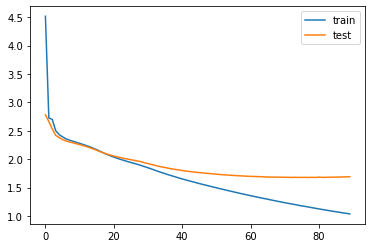

In [ ]:
from matplotlib import pyplot

pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

## Load the saved model

In [ ]:
model.load_weights('./model.h5')

## Reverse encode the index to their tokens

In [ ]:
reverse_source_word_index = x_tokenizer.index_word
reverse_target_word_index = y_tokenizer.index_word
target_word_index = y_tokenizer.word_index

## Create the Decoder inference architecture

In [ ]:
# Inference Models

# Encode the input sequence to get the feature vector
encoder_model = Model(inputs=encoder_inputs, outputs=[encoder_outputs,
                      state_h, state_c])

# Decoder setup

# Below tensors will hold the states of the previous time step
decoder_state_input_h = Input(shape=(latent_dim, ))
decoder_state_input_c = Input(shape=(latent_dim, ))
decoder_hidden_state_input = Input(shape=(max_text_len, latent_dim))

# Get the embeddings of the decoder sequence
dec_emb2 = dec_emb_layer(decoder_inputs)

# To predict the next word in the sequence, set the initial states to the states from the previous time step
(decoder_outputs2, state_h2, state_c2) = decoder_lstm(dec_emb2,
        initial_state=[decoder_state_input_h, decoder_state_input_c])

# A dense softmax layer to generate prob dist. over the target vocabulary
decoder_outputs2 = decoder_dense(decoder_outputs2)

# Final decoder model
decoder_model = Model([decoder_inputs] + [decoder_hidden_state_input,
                      decoder_state_input_h, decoder_state_input_c],
                      [decoder_outputs2] + [state_h2, state_c2])

In [ ]:
def decode_sequence(input_seq):

    # Encode the input as state vectors.
    (e_out, e_h, e_c) = encoder_model.predict(input_seq, verbose=0)

    # Generate empty target sequence of length 1
    target_seq = np.zeros((1, 1))

    # Populate the first word of target sequence with the start word.
    target_seq[0, 0] = target_word_index['sostok']

    stop_condition = False
    decoded_sentence = ''

    while not stop_condition:
        (output_tokens, h, c) = decoder_model.predict([target_seq]
                + [e_out, e_h, e_c], verbose=0)

        # Sample a token
        sampled_token_index = np.argmax(output_tokens[0, -1, :])
        sampled_token = reverse_target_word_index[sampled_token_index]

        if sampled_token != 'eostok':
            decoded_sentence += ' ' + sampled_token

        # Exit condition: either hit max length or find the stop word.
        if sampled_token == 'eostok' or len(decoded_sentence.split()) \
            >= max_summary_len - 1:
            stop_condition = True

        # Update the target sequence (of length 1)
        target_seq = np.zeros((1, 1))
        target_seq[0, 0] = sampled_token_index

        # Update internal states
        (e_h, e_c) = (h, c)

    return decoded_sentence

In [ ]:
# To convert sequence to text
def seq2text(input_seq):
    newString = ''
    for i in input_seq:
        if i != 0:
            newString = newString + reverse_source_word_index[i] + ' '

    return newString

# To convert sequence to summary
def seq2summary(input_seq):
    newString = ''
    for i in input_seq:
        if (i != 0) and (i != target_word_index['sostok']) and (i != target_word_index['eostok']):
            newString = newString + reverse_target_word_index[i] + ' '

    return newString

## Prediction summary

In [ ]:
actual = []
predicted = []
for i in range(0, 50):
    print ('Review:', seq2text(x_tr[i]))

    actual.append(seq2summary(y_tr[i]))
    print ('Original summary:', actual[-1])

    predicted.append(decode_sequence(x_tr[i].reshape(1, config['max_text_len'])))
    print ('Predicted summary:', predicted[-1])
    print()

prediction_df = pd.DataFrame({'Actual':actual, 'Predicted':predicted})
prediction_df.head(10)

Review: actress deepika padukone has denied reports that she is portraying amrita pritam in an upcoming biopic on poet ludhianvi which is being produced by sanjay leela bhansali deepika has currently signed only vishal bhardwaj s next production where she will be the role of gangster khan who was popularly known as sapna didi 
Original summary: start deepika denies starring as amrita in bhansali s film end 
Predicted summary:  start deepika to play in biopic on padmavati row report end

Review: neelima azim while talking about being a single mother and sons shahid kapoor and ishaan khatter said i was a single mother and till today he shahid is taking care of ishaan and me in every way he took our lives forward in mumbai we started living better we had all the and comfort she added 
Original summary: start shahid takes care of ishaan me on being single mom end 
Predicted summary:  start my son taimur is a dream to be a on my burkha end

Review: an etihad airways pilot passed away on wed

,Actual,Predicted
0,start deepika denies starring as amrita in bha...,start deepika to play in biopic on padmavati ...
1,start shahid takes care of ishaan me on being ...,start my son taimur is a dream to be a on my ...
2,start pilot dies on board airways plane mid ai...,start pilot flyers to fly plane with emergenc...
3,start celebrations begin at ram nath kovind s ...,start pm modi to be called by a dictator in u...
4,start guest their heads in protest in mp end,start women wear skirts in protest against end
5,start can t tolerate weinstein like behaviour ...,start i don t know how to be used to stop fac...
6,start gujarat poll panel orders probe in contr...,start ec orders removal of using fake news on...
7,start facebook suspends canadian firm amid dat...,start facebook suspends facebook over fake ne...
8,start iraq s first non arab president passes a...,start iraq s 1st state citizen to be held in ...
9,start us scientists propose new organ in human...,start scientists propose new type of human sy...


---
## Rouge score
---
ROUGE score is a metric for evaluating the quality of summaries by comparing them with reference summaries using different types of word overlap measures. Some of the variants of ROUGE score are:

- ROUGE-N: measures the overlap of n-grams (sequences of n words) between the summaries.
- ROUGE-L: measures the longest matching sequence of words using longest common subsequence (LCS) algorithm.
- ROUGE-S: measures the order of any pair of words in a sentence, allowing for arbitrary gaps.

In [ ]:
r_score = []
rouge_pr = []
rouge_rc = []
rouge_f = []

scorer = rouge_scorer.RougeScorer(['rouge1', 'rougeL'], use_stemmer=True)

for indx, data in prediction_df.iterrows():
    r_score = scorer.score(data.Actual, data.Predicted)
    pr = list(r_score['rouge1'])[0]
    rc = list(r_score['rouge1'])[1]
    fmeas = list(r_score['rouge1'])[2]

    rouge_pr.append(pr)
    rouge_rc.append(rc)
    rouge_f.append(fmeas)

prediction_df['rouge_pr'] = rouge_pr
prediction_df['rouge_rc'] = rouge_rc
prediction_df['rouge_f'] = rouge_f
prediction_df.head(10)

,Actual,Predicted,rouge_pr,rouge_rc,rouge_f
0,start deepika denies starring as amrita in bha...,start deepika to play in biopic on padmavati ...,0.363636,0.363636,0.363636
1,start shahid takes care of ishaan me on being ...,start my son taimur is a dream to be a on my ...,0.285714,0.333333,0.307692
2,start pilot dies on board airways plane mid ai...,start pilot flyers to fly plane with emergenc...,0.400000,0.400000,0.400000
3,start celebrations begin at ram nath kovind s ...,start pm modi to be called by a dictator in u...,0.166667,0.200000,0.181818
4,start guest their heads in protest in mp end,start women wear skirts in protest against end,0.500000,0.444444,0.470588
5,start can t tolerate weinstein like behaviour ...,start i don t know how to be used to stop fac...,0.266667,0.400000,0.320000
6,start gujarat poll panel orders probe in contr...,start ec orders removal of using fake news on...,0.250000,0.272727,0.260870
7,start facebook suspends canadian firm amid dat...,start facebook suspends facebook over fake ne...,0.600000,0.600000,0.600000
8,start iraq s first non arab president passes a...,start iraq s 1st state citizen to be held in ...,0.333333,0.400000,0.363636
9,start us scientists propose new organ in human...,start scientists propose new type of human sy...,0.666667,0.600000,0.631579


# Use case 8 :

## Problem Statement

You are a **Data Scientist** working at a pharmaceutical company (J&J, Pfizer, Glaxo, etc).

Studying adverse drug reactions in patients is central to drug development in healthcare.

The company wants to find relationship between drug and adverse events/ symptoms leveraging the review data.
Your task is to build a mechanism
- to identify the problems (adverse events/side-effects/symptoms etc)
- tag them to the drug name which is causing them

![Screenshot%202022-03-16%20153746.png](https://drive.google.com/uc?id=1f2_TgNaUuqPID3N2B39XD_XPQLkwVbuE)


## Training a NER from  scratch

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import keras

In [ ]:
# Hyperparams if GPU is available
if tf.test.is_gpu_available():
    BATCH_SIZE = 512  # Number of examples used in each iteration
    EPOCHS = 5  # Number of passes through entire dataset
    MAX_LEN = 75  # Max length of review (in words)
    EMBEDDING = 40  # Dimension of word embedding vector
# Hyperparams for CPU training
else:
    BATCH_SIZE = 32
    EPOCHS = 5
    MAX_LEN = 75
    EMBEDDING = 20

Instructions for updating:
Use `tf.config.list_physical_devices('GPU')` instead.


## Reading Data

In [ ]:
!gdown 1ao5aINQqedAWHSXGLpAVzW1iEZj7sZ5_
!gdown 15RuVEDqO592th-44iVEpcGbtvX9RjDWR

Downloading...
From: https://drive.google.com/uc?id=1ao5aINQqedAWHSXGLpAVzW1iEZj7sZ5_
To: /content/ner_dataset.csv
100% 15.2M/15.2M [00:00<00:00, 35.0MB/s]
Downloading...
From: https://drive.google.com/uc?id=15RuVEDqO592th-44iVEpcGbtvX9RjDWR
To: /content/drugsComTrain_raw.csv
100% 1.38M/1.38M [00:00<00:00, 164MB/s]


In [ ]:
data = pd.read_csv("/content/ner_dataset.csv", encoding="latin1")


# Show the first 10 rows
data.head(n=10)

,Sentence #,Word,POS,Tag
0,Sentence: 1,Thousands,NNS,O
1,NaN,of,IN,O
2,NaN,demonstrators,NNS,O
3,NaN,have,VBP,O
4,NaN,marched,VBN,O
5,NaN,through,IN,O
6,NaN,London,NNP,B-geo
7,NaN,to,TO,O
8,NaN,protest,VB,O
9,NaN,the,DT,O


We see in column "Sentence #"  sentence 1 is followed by NaN, so we need to fill the same we whatever the value is in top

In [ ]:
data = data.fillna(method="ffill")
data.head(n=24)

,Sentence #,Word,POS,Tag
0,Sentence: 1,Thousands,NNS,O
1,Sentence: 1,of,IN,O
2,Sentence: 1,demonstrators,NNS,O
3,Sentence: 1,have,VBP,O
4,Sentence: 1,marched,VBN,O
5,Sentence: 1,through,IN,O
6,Sentence: 1,London,NNP,B-geo
7,Sentence: 1,to,TO,O
8,Sentence: 1,protest,VB,O
9,Sentence: 1,the,DT,O


Now, this looks better.

As we see the dataset has 4 columns
- Sentence # (the sentence number)
- Word
- POS
- Tag (the annotation which is manually labelled against each word)

This method of labelling is known as sequence labelling. Let's take a look at some of the numbers./

In [ ]:
data.shape

(1048575, 4)

In [ ]:
print("Number of sentences: ", len(data.groupby(['Sentence #'])))


Number of sentences:  47959


In [ ]:
words = list(set(data["Word"].values))
n_words = len(words)
print("Number of unique words in the dataset: ", n_words)

Number of unique words in the dataset:  35178


The number of words is less than number of sentence. Its becuase we can have same word in different sentences.

In [ ]:
n_tags = len(data.groupby(['Tag']))
print("Number of Labels: ", n_tags)


Number of Labels:  17


In [ ]:
tags = list(set(data["Tag"].values))
print("Tags:", tags)

Tags: ['I-geo', 'I-art', 'I-eve', 'B-eve', 'B-tim', 'O', 'I-org', 'I-gpe', 'B-art', 'I-tim', 'B-nat', 'I-nat', 'B-per', 'B-org', 'I-per', 'B-gpe', 'B-geo']


<b>

- geo = Geographical Entity
- org = Organization
- per = Person
- gpe = Geopolitical Entity
- tim = Time indicator
- art = Artifact
- eve = Event
- nat = Natural Phenomenon
    
</b>

In [ ]:
#let's check the frequency of each tag
data['Tag'].value_counts()

O        887908
B-geo     37644
B-tim     20333
B-org     20143
I-per     17251
B-per     16990
I-org     16784
B-gpe     15870
I-geo      7414
I-tim      6528
B-art       402
B-eve       308
I-art       297
I-eve       253
B-nat       201
I-gpe       198
I-nat        51
Name: Tag, dtype: int64

We can see the <b> GEO (gepgraphic location) tag has the max frequency </b>, followed by time entity.


## Preprocessing

For Preprocessing, we will first put each sentence through a function which will <b> put each of the words along with its POS and Tag together in a tuple</b>. Each sentence will form a list of tuples.

In [ ]:
class SentenceGetter(object):
    """Class to Get the sentence in this format:
    [(Token_1, Part_of_Speech_1, Tag_1), ..., (Token_n, Part_of_Speech_n, Tag_n)]"""
    def __init__(self, data):
        """Args:
            data is the pandas.DataFrame which contains the above dataset"""
        self.n_sent = 1
        self.data = data
        self.empty = False
        agg_func = lambda s: [(w, p, t) for w, p, t in zip(s["Word"].values.tolist(),
                                                           s["POS"].values.tolist(),
                                                           s["Tag"].values.tolist())]
        self.grouped = self.data.groupby("Sentence #").apply(agg_func)
        self.sentences = [s for s in self.grouped]

    def get_next(self):
        """Return one sentence"""
        try:
            s = self.grouped["Sentence: {}".format(self.n_sent)]
            self.n_sent += 1
            return s
        except:
            return None

getter = SentenceGetter(data)
sent = getter.get_next()
print('This is what a sentence looks like:')
print(sent)

This is what a sentence looks like:
[('Thousands', 'NNS', 'O'), ('of', 'IN', 'O'), ('demonstrators', 'NNS', 'O'), ('have', 'VBP', 'O'), ('marched', 'VBN', 'O'), ('through', 'IN', 'O'), ('London', 'NNP', 'B-geo'), ('to', 'TO', 'O'), ('protest', 'VB', 'O'), ('the', 'DT', 'O'), ('war', 'NN', 'O'), ('in', 'IN', 'O'), ('Iraq', 'NNP', 'B-geo'), ('and', 'CC', 'O'), ('demand', 'VB', 'O'), ('the', 'DT', 'O'), ('withdrawal', 'NN', 'O'), ('of', 'IN', 'O'), ('British', 'JJ', 'B-gpe'), ('troops', 'NNS', 'O'), ('from', 'IN', 'O'), ('that', 'DT', 'O'), ('country', 'NN', 'O'), ('.', '.', 'O')]


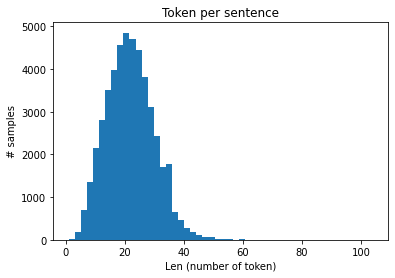

In [ ]:
# Get all the sentences
sentences = getter.sentences
# Plot sentence by lenght
plt.hist([len(s) for s in sentences], bins=50)
plt.title('Token per sentence')
plt.xlabel('Len (number of token)')
plt.ylabel('# samples')
plt.show()

From the histogram, we can see most of the sentences have around <b> 15 to 30 tokens </b>. Tokens can we referred as words ignoring punctuation marks.

- <b>Further PreProcessing:</b>

- We will convert each text word to a corresponding integer ID using the <b> word2idx dictionary</b>. Doing so saves a lot of memory.
- In order to feed the data to out Bi-LSTM-CRF model, we need to ensure that all text should be of the same length.
 - The method sequence.pad_sequences() and variable MAX_LEN are used for this purpose.
 - The text which are shorter than MAX_LEN are padded to get them to the same length, whereas text which are longer than MAX_LEN are truncated.

In [ ]:
import sklearn

# Vocabulary Key:word -> Value:token_index
# The first 2 entries are reserved for PAD and UNK
word2idx = {w: i + 2 for i, w in enumerate(words)}
word2idx["UNK"] = 1 # Unknown words
word2idx["PAD"] = 0 # Padding

# Vocabulary Key:token_index -> Value:word
idx2word = {i: w for w, i in word2idx.items()}

# Vocabulary Key:Label/Tag -> Value:tag_index
# The first entry is reserved for PAD
tag2idx = {t: i+1 for i, t in enumerate(tags)}
tag2idx["PAD"] = 0

# Vocabulary Key:tag_index -> Value:Label/Tag
idx2tag = {i: w for w, i in tag2idx.items()}
print("The word Obama is identified by the index: {}".format(word2idx["Obama"]))
print("The labels B-geo(which defines Geopraphical Enitities) is identified by the index: {}".format(tag2idx["B-geo"]))


The word Obama is identified by the index: 2888
The labels B-geo(which defines Geopraphical Enitities) is identified by the index: 17


In [ ]:
#from keras.preprocessing.sequence import pad_sequences
from keras_preprocessing.sequence import pad_sequences

# Convert each sentence from list of Token to list of word_index
X = [[word2idx[w[0]] for w in s] for s in sentences]

# Padding each sentence to have the same lenght
X = pad_sequences(maxlen=MAX_LEN, sequences=X, padding="post", value=word2idx["PAD"])

# Convert Tag/Label to tag_index
y = [[tag2idx[w[2]] for w in s] for s in sentences]

# Padding each sentence to have the same lenght
y = pad_sequences(maxlen=MAX_LEN, sequences=y, padding="post", value=tag2idx["PAD"])
from keras.utils import to_categorical

# One-Hot encode
y = [to_categorical(i, num_classes=n_tags+1) for i in y]  # n_tags+1(PAD)
from sklearn.model_selection import train_test_split
X_tr, X_te, y_tr, y_te = train_test_split(X, y, test_size=0.1)
X_tr.shape, X_te.shape, np.array(y_tr).shape, np.array(y_te).shape


print('Raw Sample:\n ', ' '.join([w[0] for w in sentences[0]]))
print('\n ' )
print('Raw Label:\n ', ' '.join([w[2] for w in sentences[0]]))
print('\n ' )
print('After processing, sample:\n', X[0])
print('\n ' )
print('After processing, labels:\n', y[0])

Raw Sample:
  Thousands of demonstrators have marched through London to protest the war in Iraq and demand the withdrawal of British troops from that country .

 
Raw Label:
  O O O O O O B-geo O O O O O B-geo O O O O O B-gpe O O O O O

 
After processing, sample:
 [11251 23279 10963  6389   584 12374  7383  7376  7296 15453  4324 26289
 10427 32060  1488 15453 12161 23279 17470 15923 24358  4447   396 24941
     0     0     0     0     0     0     0     0     0     0     0     0
     0     0     0     0     0     0     0     0     0     0     0     0
     0     0     0     0     0     0     0     0     0     0     0     0
     0     0     0     0     0     0     0     0     0     0     0     0
     0     0     0]

 
After processing, labels:
 [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [1. 0. 0. ... 0. 0. 0.]
 [1. 0. 0. ... 0. 0. 0.]
 [1. 0. 0. ... 0. 0. 0.]]


In [ ]:
y_tr = np.array(y_tr)
y_te = np.array(y_te)

## Model Building - Bi-LSTM + CRF

In [ ]:
!pip install tensorflow_addons

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 54.6 MB/s eta 0:00:00


In [ ]:
from keras.models import Model
from tensorflow.keras.layers import Input
from tensorflow_addons.utils.types import FloatTensorLike, TensorLike

# LSTM components
from keras.layers import LSTM, Embedding, Dense, TimeDistributed, Dropout, Bidirectional

# CRF layer
from tensorflow_addons.layers import CRF

# Sigmoid focal cross entropy loss. works well with highly unbalanced input data
from tensorflow_addons.losses import SigmoidFocalCrossEntropy
from tensorflow_addons.optimizers import AdamW


def build_model(max_len = 75, input_dim = 35180, embedding_dim = 200):
  # Model definition
  input = Input(shape=(max_len,))

  # Get embeddings
  embeddings = Embedding(input_dim=input_dim,
                      output_dim=embedding_dim,
                      input_length=max_len, mask_zero=True,
                    )(input)

  # variational biLSTM
  output_sequences = Bidirectional(LSTM(units=50, return_sequences=True))(embeddings)

  # Stacking
  output_sequences = Bidirectional(LSTM(units=50, return_sequences=True))(output_sequences)

  # Adding more non-linearity
  dense_out = TimeDistributed(Dense(25, activation="relu"))(output_sequences)

  # CRF layer
  crf = CRF(18, name='crf')
  predicted_sequence, potentials, sequence_length, crf_kernel = crf(dense_out)

  model = Model(input, potentials)
  model.compile(
      optimizer=AdamW(weight_decay=0.001),
      loss= SigmoidFocalCrossEntropy()) # Sigmoid focal cross entropy loss

  return model

model = build_model()

# Checkpointing
save_model = tf.keras.callbacks.ModelCheckpoint(filepath='twitter_ner_crf.h5',
  monitor='val_loss',
  save_weights_only=True,
  save_best_only=True,
  verbose=1
)

# Early stopping
es = tf.keras.callbacks.EarlyStopping(monitor='val_loss', verbose=1, patience=10)

callbacks = [save_model, es]

model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 75)]              0         
                                                                 
 embedding (Embedding)       (None, 75, 200)           7036000   
                                                                 
 bidirectional (Bidirectiona  (None, 75, 100)          100400    
 l)                                                              
                                                                 
 bidirectional_1 (Bidirectio  (None, 75, 100)          60400     
 nal)                                                            
                                                                 
 time_distributed (TimeDistr  (None, 75, 25)           2525      
 ibuted)                                                         
                                                             

## What are potentials?
- Potentials are outputs of feature functions in a CRF model.
- In a linear chain CRF, they can be further divided into transition and emission potentials.
- These potentials are then processed by a CRF kernel and sequences are generated using algorithms like [viterbi decoding](https://en.wikipedia.org/wiki/Viterbi_decoder)
- A simple implementation of a CRF kernel can be found [here](https://pytorch.org/tutorials/beginner/nlp/advanced_tutorial.html#advanced-making-dynamic-decisions-and-the-bi-lstm-crf). Implementation of CRF kernel by tensorflow can be found on their [github](https://github.com/tensorflow/addons/blob/v0.17.0/tensorflow_addons/layers/crf.py)

In [ ]:
model.fit(X_tr, y_tr, validation_data = (X_te, y_te), shuffle = True)

1349/1349 [==============================] - 76s 35ms/step - loss: 0.1349 - val_loss: 0.0305


Now, let's again go back to our original ask.
- We need to find relation between drug name and problems it is causing.

### But there are <b> 2 obstacles </b> :
- But we <b>don't have any entity</b> tags which talk either about <b>drug name</b> or <b> side effects/problems/diseases </b>.
- We <b> need a lot of annotated data from a specific domain </b> (in this case BioMedical data)

### How do we tackle it?

- The answer is we use a pre-trained domain specific NER. There are domain specific NERs such as banking, e-commerce, manufacturing, bio-medical NER.  

- Before that, let's check the dataset which has review data from a pharma company.

In [ ]:
raw_df=pd.read_csv('/content/drugsComTrain_raw.csv', encoding='iso-8859-1')
raw_df.head()

,uniqueID,drugName,condition,review,rating,date,usefulCount
0,206461.0,Valsartan,Left Ventricular Dysfunction,"""It has no side effect, I take it in combinati...",9.0,20-May-12,27.0
1,95260.0,Guanfacine,ADHD,"""My son is halfway through his fourth week of ...",8.0,27-Apr-10,192.0
2,92703.0,Lybrel,Birth Control,"""I used to take another oral contraceptive, wh...",5.0,14-Dec-09,17.0
3,138000.0,Ortho Evra,Birth Control,"""This is my first time using any form of birth...",8.0,03-Nov-15,10.0
4,35696.0,Buprenorphine / naloxone,Opiate Dependence,"""Suboxone has completely turned my life around...",9.0,27-Nov-16,37.0


We can see, the data has these important columns:
<b>
1. drugName
2. condition
3. review
</b>
Let's take a look at one of review, and understand how a <b> SME would have labelled it manually. </b>

In [ ]:
print('Review Number:',raw_df['uniqueID'][0])
print('Drug Name:',raw_df['drugName'][0])
print('Review:',raw_df['review'][0])

Review Number: 206461.0
Drug Name: Valsartan
Review: "It has no side effect, I take it in combination of Bystolic 5 Mg and Fish Oil"


And we see, for review number 206461, there were <b> no side-effects or problem </b> being caused by the drug Valsartan. Let's take a look at another example.

In [ ]:
print('Review Number:',raw_df['uniqueID'][15])
print('Drug Name:',raw_df['drugName'][15])
print('Review:',raw_df['review'][15])

Review Number: 81890.0
Drug Name: Liraglutide
Review: "I have been taking Saxenda since July 2016.  I had severe nausea for about a month once I got up to the 2.6 dosage.  It has since subsided and the only side effect I notice now is the dry mouth.  I make sure to drink  2.5 litres of water a day (about 10 glasses).  This helps with the weight loss as well as the constipation.  I have been reducing my dose to find a comfortable spot where I am still losing weight but don&#039;t feel like I am over medicating.  For me, 1.8 is working very well.  I also feel wearing a Fitbit has really helped.  I can track my food, water, exercise and steps - it keeps me moving more.  When this started I could barely walk the length of myself without getting winded - I have lost 58 lbs so far."


<b> Liraglutide </b> is a molecule used to treat type 2 diabetes and chronic weight management. Now, we can see there are some side-effects attached to it
- <b> dry mouth </b>
- <b>nausea </b>

So, as we get closer to the ask. We need to map Liraglutide with dry mouth and nausea.

<b>But, how? </b>

Let's check what are the tools we have in hand. But before that, let's take a look at how a word cloud on this review column would look like:

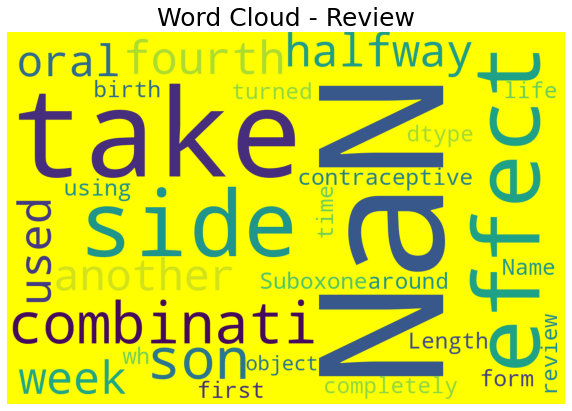

In [ ]:
# let's see the words cloud for the reviews

# most popular drugs

from wordcloud import WordCloud
from wordcloud import STOPWORDS

stopwords = set(STOPWORDS)

wordcloud = WordCloud(background_color = 'yellow', stopwords = stopwords, width = 1200, height = 800).generate(str(raw_df['review']))

plt.rcParams['figure.figsize'] = (10, 15)
plt.title('Word Cloud - Review', fontsize = 25)
print(wordcloud)
plt.axis('off')
plt.imshow(wordcloud)
plt.show()

Not much information, is inferred from the word cloud.

- We need a model which is pre-trained on Bio-Medical data and would be able to identify drug names and side-effects/symptoms and disease name. So here comes, stanza

## Bio-Medical NER - Stanza

At a high level, Stanza currently provides packages that support <b> Universal Dependencies (UD)-compatible syntactic analysis </b> and named entity recognition (NER) from both English biomedical literature and clinical note text. Officially offered packages include:

- 2 UD-compatible biomedical syntactic analysis pipelines, trained with human-annotated treebanks;
- 1 UD-compatible clinical syntactic analysis pipeline, trained with silver data;


![Screenshot%202022-03-16%20184002.png](https://drive.google.com/uc?id=1FDU5qfDpm9w0EYqVmqymqy9LtabhBeJy)
- 8 accurate biomedical NER models augmented with contextualized representations;
- 2 clinical NER models, including one specialized in radiology reports.



![Screenshot%202022-03-16%20183750.png](https://drive.google.com/uc?id=15Omc0QfQzI9wer54ncHhtP8bGWzw1jBh)

The 16 entity types in the BioNLP13CG model include, some of which are:
- ORGAN
- ORGANISM
- PROBLEM
- TREATMENT
- DISEASE
- CHEMICAL

<B> Let's import stanza </b>

In [ ]:
!pip install stanza

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 691.3/691.3 KB 27.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 240.9/240.9 KB 18.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for emoji: filename=emoji-2.2.0-py3-none-any.whl size=234926 sha256=3cd2df92b15ac39a9b4886271d957b2803dc4b7c26d25fe59ca720c1c7adb029
  Stored in directory: /root/.cache/pip/wheels/86/62/9e/a6b27a681abcde69970dbc0326ff51955f3beac72f15696984
Successfully built emoji


In [ ]:
import stanza
stanza.download('en', package='mimic',processors={'ner':'i2b2'})
stanza.download('en', package='mimic',processors={'ner':'bc5cdr'})

INFO:stanza:Downloading these customized packages for language: en (English)...
| Processor       | Package |
-----------------------------
| tokenize        | mimic   |
| pos             | mimic   |
| lemma           | mimic   |
| depparse        | mimic   |
| ner             | i2b2    |
| forward_charlm  | mimic   |
| pretrain        | mimic   |
| backward_charlm | mimic   |



INFO:stanza:Finished downloading models and saved to /root/stanza_resources.


INFO:stanza:Downloading these customized packages for language: en (English)...
| Processor       | Package |
-----------------------------
| tokenize        | mimic   |
| pos             | mimic   |
| lemma           | mimic   |
| depparse        | mimic   |
| ner             | bc5cdr  |
| pretrain        | craft   |
| forward_charlm  | pubmed  |
| pretrain        | mimic   |
| backward_charlm | pubmed  |
| forward_charlm  | mimic   |
| backward_charlm | mimic   |

INFO:stanza:File exists: /root/stanza_resources/en/tokenize/mimic.pt
INFO:stanza:File exists: /root/stanza_resources/en/pos/mimic.pt
INFO:stanza:File exists: /root/stanza_resources/en/lemma/mimic.pt
INFO:stanza:File exists: /root/stanza_resources/en/depparse/mimic.pt


INFO:stanza:File exists: /root/stanza_resources/en/pretrain/mimic.pt


INFO:stanza:File exists: /root/stanza_resources/en/forward_charlm/mimic.pt
INFO:stanza:File exists: /root/stanza_resources/en/backward_charlm/mimic.pt
INFO:stanza:Finished downloading models and saved to /root/stanza_resources.


Because, within the data we already have drug name, we need PROBLEM and DISEASE entity identification only, we are downloading only two NER models
<b>
1. i2b2
2. bc5cdr
</b>

So, let us create two pipeline with these

In [ ]:
nlp1 = stanza.Pipeline('en', package='mimic', processors={'ner':'i2b2'})
nlp2= stanza.Pipeline('en', package='mimic', processors={'ner':'bc5cdr'})

INFO:stanza:Checking for updates to resources.json in case models have been updated.  Note: this behavior can be turned off with download_method=None or download_method=DownloadMethod.REUSE_RESOURCES


INFO:stanza:Loading these models for language: en (English):
| Processor | Package |
-----------------------
| tokenize  | mimic   |
| pos       | mimic   |
| lemma     | mimic   |
| depparse  | mimic   |
| ner       | i2b2    |

INFO:stanza:Use device: gpu
INFO:stanza:Loading: tokenize
INFO:stanza:Loading: pos
INFO:stanza:Loading: lemma
INFO:stanza:Loading: depparse
INFO:stanza:Loading: ner
INFO:stanza:Done loading processors!
INFO:stanza:Checking for updates to resources.json in case models have been updated.  Note: this behavior can be turned off with download_method=None or download_method=DownloadMethod.REUSE_RESOURCES


INFO:stanza:Loading these models for language: en (English):
| Processor | Package |
-----------------------
| tokenize  | mimic   |
| pos       | mimic   |
| lemma     | mimic   |
| depparse  | mimic   |
| ner       | bc5cdr  |

INFO:stanza:Use device: gpu
INFO:stanza:Loading: tokenize
INFO:stanza:Loading: pos
INFO:stanza:Loading: lemma
INFO:stanza:Loading: depparse
INFO:stanza:Loading: ner
INFO:stanza:Done loading processors!


In [ ]:
#Let's check a sample sentence with i2b2
doc = nlp1("This is my first time using any form of birth control. I&#039;m glad I went with the patch, I have been on it for 8 months. At first It decreased my libido but that subsided. The only downside is that it made my periods longer (5-6 days to be exact) I used to only have periods for 3-4 days max also made my cramps intense for the first two days of my period, I never had cramps before using birth control. Other than that in happy with the patch")
doc.entities

[{
   "text": "birth control",
   "type": "TREATMENT",
   "start_char": 40,
   "end_char": 53
 }, {
   "text": "the patch",
   "type": "TREATMENT",
   "start_char": 81,
   "end_char": 90
 }, {
   "text": "my cramps",
   "type": "PROBLEM",
   "start_char": 305,
   "end_char": 314
 }, {
   "text": "cramps",
   "type": "PROBLEM",
   "start_char": 372,
   "end_char": 378
 }, {
   "text": "birth control",
   "type": "TREATMENT",
   "start_char": 392,
   "end_char": 405
 }, {
   "text": "the patch",
   "type": "TREATMENT",
   "start_char": 437,
   "end_char": 446
 }]

So if we see what is being detected through NER,
<b>
- cramps (problem)
- birth control (treatment)
- patch (treatment)
</b>

![Screenshot%202022-03-16%20190006.png](https://drive.google.com/uc?id=1dJUVi6MUdnct0miPjSNSA1iRLHHLGJT0)

Let's do the same with <b> bc5cdr</b>

In [ ]:
#Let's check a sample sentence with i2b2
doc = nlp2("This is my first time using any form of birth control. I&#039;m glad I went with the patch, I have been on it for 8 months. At first It decreased my libido but that subsided. The only downside is that it made my periods longer (5-6 days to be exact) I used to only have periods for 3-4 days max also made my cramps intense for the first two days of my period, I never had cramps before using birth control. Other than that in happy with the patch")
doc.entities

[{
   "text": "cramps",
   "type": "DISEASE",
   "start_char": 308,
   "end_char": 314
 }, {
   "text": "cramps",
   "type": "DISEASE",
   "start_char": 372,
   "end_char": 378
 }]

![Screenshot%202022-03-25%20145818.png](https://drive.google.com/uc?id=1PsXq6HjerNVOAUAZW0lBQioNfpz74Jxl)

We see almost the same results, just the name of the entities differ. We will choose bc5cdr, as of now.

In [ ]:
#slicing the first 50 rows, keeping the time factor in mind

df = raw_df.head(50)
df['Side-Effects']=''

for i, row in df.iterrows():
    doc=nlp2(row["review"])
    doc_entity=doc.entities
    #print(doc_entity)
    ae=[]

    for token in doc_entity:
        #print(token.type)
        if token.type=="DISEASE":
            ae.append(token.text)
            #print(ae)

    df.at[i,'Side-Effects']=ae


<ipython-input-30-dac5c8bdb0ff>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Side-Effects']=''


In [ ]:
df.head(10)

,uniqueID,drugName,condition,review,rating,date,usefulCount,Side-Effects
0,206461.0,Valsartan,Left Ventricular Dysfunction,"""It has no side effect, I take it in combinati...",9.0,20-May-12,27.0,[]
1,95260.0,Guanfacine,ADHD,"""My son is halfway through his fourth week of ...",8.0,27-Apr-10,192.0,[]
2,92703.0,Lybrel,Birth Control,"""I used to take another oral contraceptive, wh...",5.0,14-Dec-09,17.0,[]
3,138000.0,Ortho Evra,Birth Control,"""This is my first time using any form of birth...",8.0,03-Nov-15,10.0,"[cramps, cramps]"
4,35696.0,Buprenorphine / naloxone,Opiate Dependence,"""Suboxone has completely turned my life around...",9.0,27-Nov-16,37.0,[constipation]
5,155963.0,Cialis,Benign Prostatic Hyperplasia,"""2nd day on 5mg started to work with rock hard...",2.0,28-Nov-15,43.0,[headache]
6,165907.0,Levonorgestrel,Emergency Contraception,"""He pulled out, but he cummed a bit in me. I t...",1.0,07-Mar-17,5.0,[]
7,102654.0,Aripiprazole,Bipolar Disorde,"""Abilify changed my life. There is hope. I was...",10.0,14-Mar-15,32.0,"[depression, depressed, Bi-polar disorder]"
8,74811.0,Keppra,Epilepsy,""" I Ve had nothing but problems with the Kepp...",1.0,09-Aug-16,11.0,[]
9,48928.0,Ethinyl estradiol / levonorgestrel,Birth Control,"""I had been on the pill for many years. When m...",8.0,08-Dec-16,1.0,"[acne, acne, depression, weight gain, depressed]"


We can see, the Disease column have picked <b> a lot of symptoms/side-effects </b>. Now it's time to put them together.

In [ ]:
#keep only the relevant cols and the rows with non-empty side-effects
cols_rel=['drugName','Side-Effects']
df_rel= df.loc[:,cols_rel]
df_rel=df_rel[df_rel["Side-Effects"].astype(bool)]
df_rel.head()

,drugName,Side-Effects
3,Ortho Evra,"[cramps, cramps]"
4,Buprenorphine / naloxone,[constipation]
5,Cialis,[headache]
7,Aripiprazole,"[depression, depressed, Bi-polar disorder]"
9,Ethinyl estradiol / levonorgestrel,"[acne, acne, depression, weight gain, depressed]"


In [ ]:
#  create a list to host each problem with the drugname
list=[]
for i,row in df_rel.iterrows():
    for ele in enumerate(row['Side-Effects']):
        #print(row['drugName'],ele[1])
        list.append((row['drugName'],ele[1]))



In [ ]:
#convert the list into a dataframe
df_drug_problem = pd.DataFrame(list,columns = ['drugName', 'Side-Effects'])
df_drug_problem.head(10)

,drugName,Side-Effects
0,Ortho Evra,cramps
1,Ortho Evra,cramps
2,Buprenorphine / naloxone,constipation
3,Cialis,headache
4,Aripiprazole,depression
5,Aripiprazole,depressed
6,Aripiprazole,Bi-polar disorder
7,Ethinyl estradiol / levonorgestrel,acne
8,Ethinyl estradiol / levonorgestrel,acne
9,Ethinyl estradiol / levonorgestrel,depression


In [ ]:
#but we see some duplicates
df_drug_problem.drop_duplicates(subset=None,keep='first',inplace=False)

,drugName,Side-Effects
0,Ortho Evra,cramps
2,Buprenorphine / naloxone,constipation
3,Cialis,headache
4,Aripiprazole,depression
5,Aripiprazole,depressed
...,...,...
105,Tamsulosin,Memory problems
106,Tamsulosin,runny nose
107,Tamsulosin,weakness
108,Tamsulosin,tiredness


In [ ]:
df_drug_problem['drugName'].value_counts()

Lamotrigine                           8
Trazodone                             8
Tamsulosin                            7
Dulcolax                              6
Amitriptyline                         6
Ethinyl estradiol / levonorgestrel    5
Ledipasvir / sofosbuvir               5
Dextromethorphan                      5
Azithromycin                          4
Toradol                               4
Pentasa                               4
Liraglutide                           4
Atripla                               3
Trimethoprim                          3
Sertraline                            3
Contrave                              3
Topiramate                            3
Aripiprazole                          3
Imitrex                               3
Fluconazole                           2
Trilafon                              2
MoviPrep                              2
Ortho Evra                            2
Daytrana                              2
L-methylfolate                        2


So we see the top 5 drugName with the highest number of side-effects are :
<b>
- Trazodone                             
- Lamotrigine                           
- Tamsulosin                            
- Amitriptyline                         
- Dulcolax                              
</b>

# Use case 9 : Aspect based sentiment analysis


In [ ]:
%pip install tensorflow_addons
%pip install lit-nlp
%pip install rouge-score
%pip install shap

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 591.0/591.0 kB 10.1 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.3/12.3 MB 45.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 118.9/118.9 kB 9.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.9/77.9 kB 7.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.2/88.2 kB 6.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 61.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for ml-collections: filename=ml_collections-0.1.1-py3-none-any.whl size=94524 sha256=e70fa0da135c24420635411464d050a96f9c75b604dd98dc4beb8da1b49aab43
  Stored in directory: /root/.c

In [ ]:
import pandas as pd
import numpy as np
import string
import re
import random
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
from gensim.models import word2vec, FastText
import gensim.downloader
from sklearn.decomposition import PCA
import tensorflow_addons as tfa

/usr/local/lib/python3.9/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


## **Problem Statement**

- You are a data scientist in travel agency company.

- Your company is trying to figure out the sentiment of people about the  Hotel and Restaurant listed on their website on the basis of entity present in the review itself.
-  so that they could rank the hotel and restaurant accordingly on their landing page.

- And they wanted to train you a ML model to solve the problem.

## **So, What kind of problem is it?**
- so, first thing it is clear that, it is a  sentiment analysis task.
-  but sentiment is based on entity present in the review itself.
- so we have two input :
  - First, is `review text`,
  - and Second, is an `entity text` on which we want sentiment analysis.

- This type of task is categorized as `Aspect based Sentiment Analysis` in ML.



### **what is 'aspect' in ML?**
- the way in which a problem, idea, etc., may be considered  

- like your goal is to do classification based on some aspect. see below examples.

```
INPUT = {'text': 'food is delicious but price is high',
             'aspect':'food',
              
   }

   OUTPUT = {'aspect_Sentiment' : 'Positive'
                }

```
     



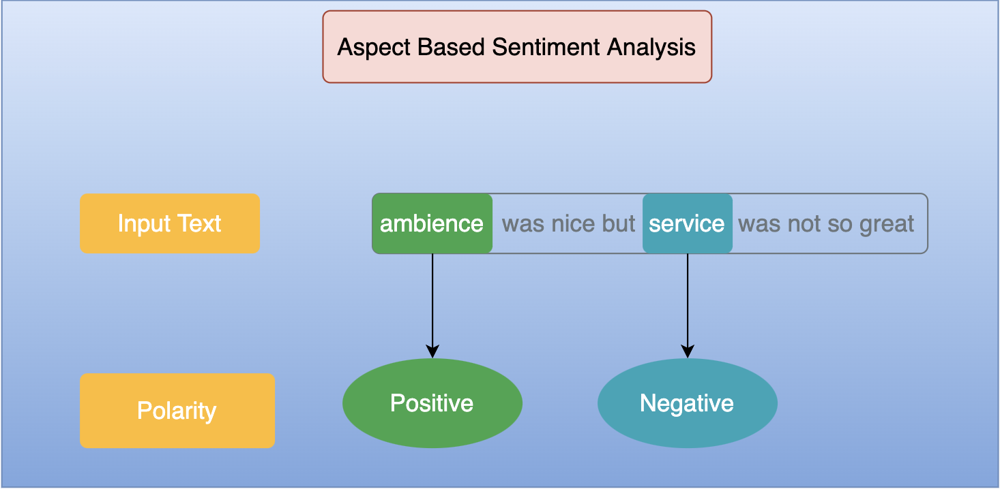

In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import TextVectorization
import gensim.downloader as api
from tensorflow.keras.layers import Embedding
import numpy as np

tf.random.set_seed(123)

## **DOWNLOAD THE DATASET**

In [ ]:
# Downloasd dataset

!gdown https://drive.google.com/file/d/1DNgciEZTQWuo_wq4qMGIV8z3VC1Onjjv/view?usp=share_link --fuzzy
!gdown https://drive.google.com/file/d/1ePfUhb2XeicnybAMu0y2w3BhiWm4XY8t/view?usp=share_link --fuzzy
!gdown https://drive.google.com/file/d/1FRn6Gn3ijmCWfhUI6QkGm4g4LeQ7Veg0/view?usp=share_link --fuzzy
!gdown https://drive.google.com/file/d/1Fw3yivW_PSH-C5T_4-9bWshxPHxvxtAi/view?usp=share_link --fuzzy
!gdown https://drive.google.com/file/d/1F9r26d7emj43EG6kcMfvOsu1rI8yxR4d/view?usp=share_link --fuzzy
!gdown https://drive.google.com/file/d/1zSYr8akNxtCCR_TxVIFrel1k254k-vin/view?usp=share_link --fuzzy
!gdown https://drive.google.com/file/d/1zSYr8akNxtCCR_TxVIFrel1k254k-vin/view?usp=share_link --fuzzy
!gdown https://drive.google.com/file/d/1zSYr8akNxtCCR_TxVIFrel1k254k-vin/view?usp=share_link --fuzzy
!gdown https://drive.google.com/file/d/1I0vjwcnwfaMZdwhS-oJjqUoihl9NxZ1g/view?usp=share_link --fuzzy
!gdown https://drive.google.com/file/d/1tX9mZBStZGCQmOhgaCu-tSdlXqQU77ou/view?usp=share_link --fuzzy
!gdown https://drive.google.com/file/d/1-GNcBpiB3Y0RzbJLawxL31IjkTBtpUz2/view?usp=share_link --fuzzy

## **DATA LOADING**

In [ ]:
def load_mams_data(path):
  df = pd.read_csv(path)
  df = df[['text', 'term', 'polarity']]
  return df

def load_laptop_data(path):
  text_ds = []
  term_ds = []
  polarity_ds = []
  with open(path, 'r') as f:
    data = f.read().splitlines()

  terms = []
  polarities = []
  text = ""
  term = ""
  polarity = ""
  for row in data[2:]:
    # We are on new text column
    if len(row) == 1:
      if term != "":
        terms.append(term)
        polarities.append(polarity)
      for i in range(len(terms)):
        text_ds.append(text.strip())
        term_ds.append(terms[i].strip())
        polarity_ds.append(polarities[i])

      text = ""
      term = ""
      polarity = ""
      terms = []
      polarities = []

    else:
      token, label = row.rsplit(',', 1)
      text += " " + token

      if label == 'T-POS':
        label = 'positive'
      elif label == 'T-NEG':
        label = 'negative'
      elif label == 'T-NEU':
        label = 'neutral'
      else:
        if term != "":
          terms.append(term)
          polarities.append(polarity)
        term = ""
        polarity = ""
        continue

      if polarity == label:
        term += " " + token

      else:
        if term != "":
          terms.append(term)
          polarities.append(polarity)

        polarity = label
        term = token

  df = pd.DataFrame()
  df['text'] = text_ds
  df['term'] = term_ds
  df['polarity'] = polarity_ds
  return df

In [ ]:
import pandas as pd
# laptop dataset
laptop_train, laptop_test, laptop_valid = list(map(load_laptop_data, ['laptop_train.csv', 'laptop_test.csv', 'laptop_dev.csv']))

# restaurant dataset
rest_train, rest_test, rest_valid = list(map(load_laptop_data, ['rest16_train.csv', 'rest16_test.csv', 'rest16_dev.csv']))

# mams dataset
mams_train, mams_test, mams_valid = list(map(load_mams_data, ['mams_train.csv', 'mams_test.csv', 'mams_val.csv']))

# dataset combined, shuffled
train_data = pd.concat([laptop_train, rest_train, mams_train, laptop_test, rest_test, mams_test]).sample(frac = 1).reset_index(drop = True)
valid_data = pd.concat([laptop_valid, rest_valid, mams_valid]).sample(frac = 1).reset_index(drop = True)

In [ ]:
print('*'*30,'data ', '*'*30)
train_data.head()

In [ ]:
print('*'*30,'data uniqueness', '*'*30)
train_data.nunique()

In [ ]:
print('*'*30,'Sentiment labels', '*'*30)
train_data['polarity'].value_counts()

## Sampling train data to contain equal values of polarities

In [ ]:
train_data = train_data[train_data['polarity'] != 'neutral']

In [ ]:
valid_data = valid_data[valid_data['polarity'] != 'neutral']

In [ ]:
# data processing, encoding labels, and lower casing the sentence text and aspect text

pol2idx = { 'positive' : 1, 'negative' : 0}
for data in [train_data, valid_data]:
  data['polarity'] = data['polarity'].apply(lambda x:pol2idx[x])
  data['text'] = data['text'].apply(lambda x: x.lower())
  data['term'] = data['term'].apply(lambda x: str(x).lower()).astype('str')

  data = data.drop_duplicates(["text", "term", "polarity"])

train_data.head()

## **Embedding Model Initialization**
- using Word2Vec as [Word2Vec typically performs better than fasttext for semantic tasks](https://github.com/RaRe-Technologies/gensim/blob/develop/docs/notebooks/Word2Vec_FastText_Comparison.ipynb)

In [ ]:
# load word embeddings from gensim api

word2vec = api.load("word2vec-google-news-300")

In [ ]:
embedding_dim = 300

In [ ]:
tokenizer = tf.keras.preprocessing.text.Tokenizer(lower=True)
tokenizer.fit_on_texts(train_data['text'])

In [ ]:
import gc
num_tokens = len(tokenizer.word_index) + 1
hits = 0
misses = 0


# Prepare embedding matrix
embedding_matrix = np.zeros((num_tokens, embedding_dim))
for word, i in tokenizer.word_index.items():
    embedding_vector = None
    try:
      embedding_vector = word2vec[word]
    except Exception :
      pass

    if embedding_vector is not None:
        # Words not found in embedding index will be all-zeros.
        # This includes the representation for "padding" and "OOV"
        embedding_matrix[i] = embedding_vector
        hits += 1
    else:
        misses += 1

del word2vec
gc.collect()
print("Converted %d words (%d misses)" % (hits, misses))

## **Train and Val set Preparartion**

In [ ]:
def tokenize_and_pad_text(text, seq_len):
  tokens = tokenizer.texts_to_sequences([text])
  padded_tokens = tf.keras.preprocessing.sequence.pad_sequences(tokens, maxlen=seq_len)
  return padded_tokens[0]

In [ ]:
def prepare_and_tokenize_dataset(dataset):
  all_texts = []
  all_terms = []
  all_polarities = []
  for idx, row in dataset.iterrows():
    all_texts.append(tokenize_and_pad_text(row['text'], 128))
    all_terms.append(tokenize_and_pad_text(row['term'], 4))
    all_polarities.append(row['polarity'])

  all_texts = tf.constant(all_texts)
  all_terms = tf.constant(all_terms)
  all_polarities = tf.constant(all_polarities)

  return (all_texts, all_terms, all_polarities)

train_texts, train_terms, train_polarities = prepare_and_tokenize_dataset(train_data)
valid_texts, valid_terms, valid_polarities = prepare_and_tokenize_dataset(valid_data)

## Here's our training data, padded to the right

In [ ]:
print("*"*64)
print("Review text", train_texts[0])
print("*"*64)
print("Aspect text", train_terms[0])
print("*"*64)
print("Polarity", train_polarities[0])
print("*"*64)

## **ATTENTION LAYER IMPLEMENTATION**

In [ ]:
# Attention Mechanisms Implementation in Keras

class Attention(tf.keras.layers.Layer):
  def __init__(self, units):
    super(Attention, self).__init__(name='attention')
    self.units = units
    self.supports_masking = True
    self.K = tf.keras.layers.Dense(self.units)
    self.Q = tf.keras.layers.Dense(self.units)
    self.V = tf.keras.layers.Dense(1)

    self.debug = False

  def get_config(self):

    config = super().get_config().copy()
    config.update({'units': self.units, })
    return config

  def compute_mask(self, keys, keys_mask):
    """
    Output will be values of shape (batch_size, keys_seq_len)
    So, it's mask will be keys_mask
    """
    return keys_mask


  def apply_mask_to_scores(self, scores, keys_mask, queries_mask):


    keys_mask = tf.cast(keys_mask, dtype = 'float32')
    queries_mask = tf.cast(queries_mask, dtype = 'float32')

    keys_mask = tf.expand_dims(keys_mask, axis = -1)
    queries_mask = tf.expand_dims(queries_mask, axis = -2)
    scores_mask = keys_mask * queries_mask

    # Ignoring masked scores
    if self.debug:
        print(scores_mask)

    # Normalizing scores
    scores, _ = tf.linalg.normalize(scores)

    return scores * scores_mask

  def call(self, keys, keys_mask, queries, queries_mask):
    """
    keys: Tensor of shape (batch_size, 128, embed_dim): Review embeddings
    queries: Tensor of shape (batch_size, 4, embed_dim): Aspect embeddings
    """

    queries = self.Q(queries)
    keys = self.K(keys)
    values = self.V(keys)

    queries = tf.transpose(queries, (0, 2, 1))

    score = tf.matmul(keys, queries)

    # Masking
    score = self.apply_mask_to_scores(score, keys_mask, queries_mask)
    score = score[:, :, -1] # Only considering last query token

    # attention_weights shape == (batch_size, max_length, 4)
    attention_weights = tf.nn.softmax(score, axis = 1)
    attention_weights = tf.expand_dims(attention_weights, axis = -1)

    # context_vector shape after sum == (batch_size, hidden_size)
    context_vector = attention_weights * values

    context_vector = context_vector[:, :, -1]
    attention_weights = attention_weights[:, :, -1]
    return context_vector, attention_weights

## **MODEL ARCHITECTURE**

In [ ]:
class AttnModel(tf.keras.Model):
  def __init__(self, review_input_Shape, aspect_input_shape, num_aspects = 30):
    super().__init__()
    self.num_aspects = num_aspects

    self.embedding_layer = Embedding(
      num_tokens,
      embedding_dim,
      embeddings_initializer=tf.keras.initializers.Constant(embedding_matrix), # Initialize with word2vec embeddings
      name = 'embedding_layer',
      mask_zero=True
    )

    self.review_gru = tf.keras.layers.GRU(256, return_sequences = True)

    self.aspect_gru = tf.keras.layers.GRU(256, return_sequences = True)

    self.attn = Attention(256)

    self.feedforward = tf.keras.layers.Dense(64, activation = "relu")

    self.classifier = tf.keras.layers.Dense(1, activation="sigmoid")

    self.past_attn_weights = None # For visualization

    self.loss_fn = tf.keras.losses.BinaryCrossentropy()

    self.acc_metric = tf.keras.metrics.BinaryAccuracy()


  def call(self, inputs, training = None):
    try:
        review_inputs, aspect_inputs, polarities = inputs
    except ValueError:
        review_inputs, aspect_inputs = inputs
        polarities = None

    review_embeddings = self.embedding_layer(review_inputs)
    review_mask = self.embedding_layer.compute_mask(review_inputs)

    review_embeddings = self.review_gru(review_embeddings, mask = review_mask)

    aspect_embeddings = self.embedding_layer(aspect_inputs)
    aspect_mask = self.embedding_layer.compute_mask(aspect_inputs)

    aspect_embeddings = self.aspect_gru(aspect_embeddings, mask = aspect_mask)

    values, self.past_attn_weights = self.attn(review_embeddings, review_mask, aspect_embeddings, aspect_mask)

    outputs = self.feedforward(values)
    outputs = self.classifier(outputs)

    if polarities is not None:
        loss = self.loss_fn(polarities, outputs)
        self.add_loss(loss)
        self.add_metric(self.acc_metric(polarities, outputs))
    else:
        return outputs

In [ ]:
model = AttnModel(128, 4)

## **MODEL Compiling**

In [ ]:
learning_rate = tf.keras.optimizers.schedules.PolynomialDecay(1e-2, 236, 1e-4)

model.compile(
    optimizer=tf.optimizers.Adam(learning_rate)
)

save_model = tf.keras.callbacks.ModelCheckpoint(filepath='aspect_based_sa.h5',
  monitor='val_binary_accuracy',
  mode='max',
  save_weights_only=True,
  save_best_only=True,
  verbose=1
)

es = tf.keras.callbacks.EarlyStopping(monitor='val_binary_accuracy', mode='max', verbose=1, patience=4)

callbacks = [save_model, es]

## **TRAINING**

In [ ]:
history = model.fit(
  x = [train_texts, train_terms, train_polarities],
  batch_size=32,
  epochs=5,
  validation_data=([valid_texts, valid_terms, valid_polarities], None),
  callbacks=callbacks,
)

Epoch 1/5
339/339 [==============================] - ETA: 0s - loss: 0.4893 - binary_accuracy: 0.7582
Epoch 1: val_binary_accuracy improved from -inf to 0.80904, saving model to aspect_based_sa.h5
339/339 [==============================] - 170s 455ms/step - loss: 0.4893 - binary_accuracy: 0.7582 - val_loss: 0.4290 - val_binary_accuracy: 0.8090
Epoch 2/5
339/339 [==============================] - ETA: 0s - loss: 0.3462 - binary_accuracy: 0.8477
Epoch 2: val_binary_accuracy did not improve from 0.80904
339/339 [==============================] - 123s 362ms/step - loss: 0.3462 - binary_accuracy: 0.8477 - val_loss: 0.4303 - val_binary_accuracy: 0.8081
Epoch 3/5
339/339 [==============================] - ETA: 0s - loss: 0.3325 - binary_accuracy: 0.8535
Epoch 3: val_binary_accuracy did not improve from 0.80904
339/339 [==============================] - 118s 348ms/step - loss: 0.3325 - binary_accuracy: 0.8535 - val_loss: 0.4321 - val_binary_accuracy: 0.8017
Epoch 4/5
339/339 [=================

## Plot the train and validation accuracies

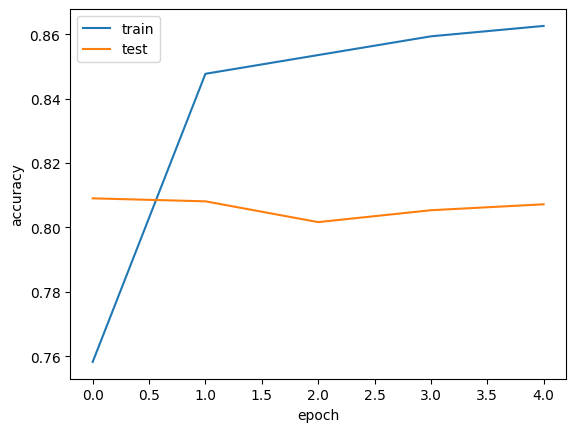

In [ ]:
from matplotlib import pyplot

pyplot.plot(history.history['binary_accuracy'], label='train')
pyplot.plot(history.history['val_binary_accuracy'], label='test')
pyplot.xlabel("epoch")
pyplot.ylabel("accuracy")
pyplot.legend()
pyplot.show()

## **Inferencing**

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

label_map = {
    0:'Negative',
    1: 'Positive'
}
def predict_aspect(model, review_text, aspect_text):
  review_tokens = tokenizer.texts_to_sequences([review_text])
  review_tokens = tf.keras.preprocessing.sequence.pad_sequences(review_tokens, maxlen=128)

  aspect_tokens = tokenizer.texts_to_sequences([[aspect_text]])
  aspect_tokens = tf.keras.preprocessing.sequence.pad_sequences(aspect_tokens, maxlen=4)
  preds = model([review_tokens, aspect_tokens])
  neg_prob = preds[0].numpy().item()
  probs = [neg_prob, 1 - neg_prob]
  attn_weights = model.past_attn_weights
  attn_weights = tf.reshape(attn_weights, (128, 1)).numpy()
  attn_weights = attn_weights[-len(review_text.split()):]

  return probs, attn_weights

def print_aspect(probs, attn_weights, review_text, aspect_text):
  print('Review text : ', review_text)
  print('*'*32,f'aspect-term : {aspect_text}', '*'*32)

  predicted_aspect = label_map[np.argmax(probs)]
  print("*"*32, "Predicted Aspect", "*"*32)
  print("*"*32, predicted_aspect, "*"*32)
  plt.figure(figsize=(10.5, 7.5))
  query_df = pd.DataFrame(attn_weights, index = review_text.split(), columns = [aspect_text])
  ax = sns.heatmap(query_df, annot=True, cmap=sns.light_palette("blue", as_cmap=True, ), linewidths=1, ).set_title('predicted')
  plt.show()
  print("\n"*4)

Review text :  The atmosphere of the place was so enchanting and captivating that it made me feel relaxed and happy.
******************************** aspect-term : atmosphere ********************************
******************************** Predicted Aspect ********************************
******************************** Negative ********************************


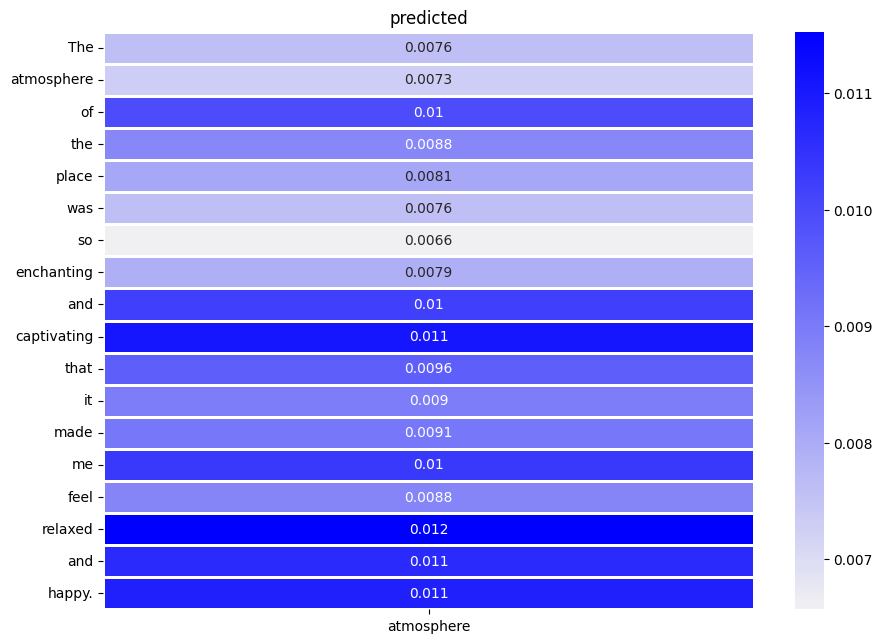






Review text :  that service was the worst thing I had ever experienced
******************************** aspect-term : service ********************************
******************************** Predicted Aspect ********************************
******************************** Positive ********************************


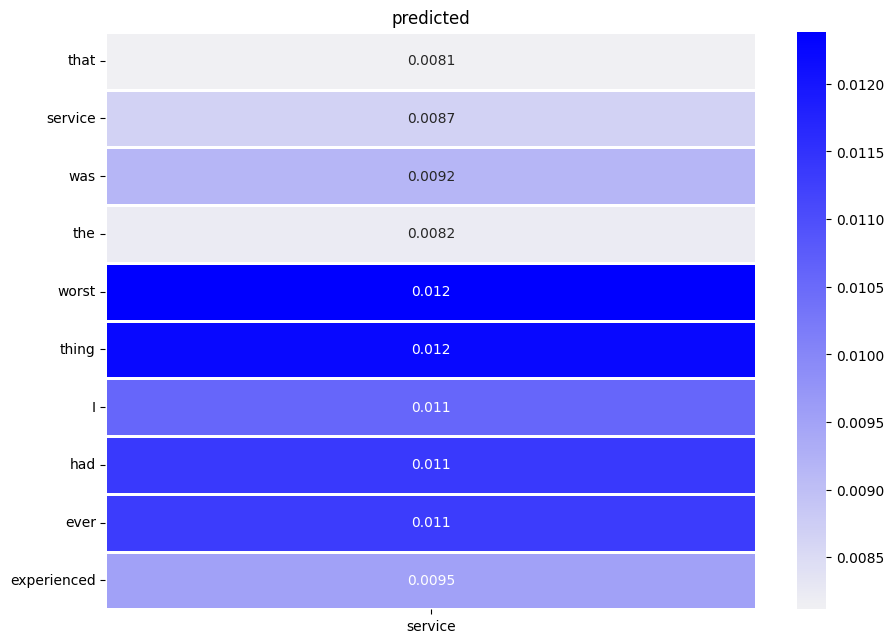

In [ ]:
# load the most accurate model, following val_acc curve
inp_str = 'The atmosphere of the place was so enchanting and captivating that it made me feel relaxed and happy.'

print_aspect(*predict_aspect(model, inp_str, 'atmosphere'), inp_str, 'atmosphere')

inp_str = 'that service was the worst thing I had ever experienced'
print_aspect(*predict_aspect(model, inp_str, 'service'), inp_str, 'service')

## **Attention Plot Analysis**

- For aspect term "Service" in above example.
- word `worst` is activated
- which cause negative sentiment prediction

-------------------------------------------------------------------
- For aspect term "ambience" in above example.
- words `captivating` and `happy` are activated
- which cause positive sentiment prediction.


## Other ways of interpreting language models: LIT Interpretability Tool

In [ ]:
from lit_nlp import notebook

In [ ]:
notebook.is_colab = True

In [ ]:
from lit_nlp.api.dataset import Dataset
from lit_nlp.api.model import Model
from lit_nlp.api import types as lit_types

In [ ]:
class LITModel(Model):
  """Wrapper for a Natural Language Inference model."""

  NLI_LABELS = ['negative', 'neutral', 'positive']

  def __init__(self, model):
    # Load the model into memory so we're ready for interactive use.
    self._model = model

  def predict_minibatch(self, inputs):

    outputs = []
    for input in inputs:
      review_text = input['review_text']
      aspect_text = input['aspect_text']

      probs, attn_weights = predict_aspect(self._model, review_text, aspect_text)
      outputs.append({
          'probs': probs,
      })

    return outputs


  def input_spec(self):
    """Describe the inputs to the model."""
    return {
        'review_text': lit_types.TextSegment(),
        'aspect_text': lit_types.TextSegment(),
    }

  def output_spec(self):
    """Describe the model outputs."""
    return {
      # The 'parent' keyword tells LIT where to look for gold labels when computing metrics.
      'probs': lit_types.MulticlassPreds(vocab = ['Positive', 'Negative'])
    }

In [ ]:
lit_model = LITModel(model)

In [ ]:
class LITDataset(Dataset):
  def __init__(self, dataset):
    self._examples = [{
      'review_text': row['text'],
      'aspect_text': row['term']
    } for _, row in dataset.iterrows()]

  def spec(self):
    return {
      'review_text': lit_types.TextSegment(),
      'aspect_text': lit_types.TextSegment(),
    }

In [ ]:
lit_dataset = LITDataset(train_data.sample(n = 50))

In [ ]:
widget = notebook.LitWidget({'model': lit_model}, {'ds': lit_dataset})

  0%|          | 0/50 [00:00<?, ?it/s]

In [ ]:
widget.render(height = 600)

<IPython.core.display.Javascript object>

## LIT Tool: Why Should we use it?

- The [Learning Interpretability Tool (LIT)](https://pair-code.github.io/lit/) is an open-source platform for visualization and understanding of NLP models.

- As you can see, we can use LIT tool to explore our trained data model. Here, we use it to have a look at the distribution of predicted sentiments by the model

# Use case 10

In [ ]:
import pandas as pd
import numpy as np
import string
import re
import random
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
from gensim.models import word2vec, FastText
import gensim.downloader
from sklearn.decomposition import PCA

#device = torch.device('cude' if torch.cuda.is_available() else "cpu")



`You are a data scientist in Amazon Alexa`.
- Amazon wants to increase its footprints and sell of alexa in European Market.
- it  wants to add translator feature to Alexa.
- Teams wants to translate any english sentence to French
- They wanted you to train Machine learning model, which translate english to french.




## Install dependencies

In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')

In [ ]:
!pip install -U datasets sacrebleu transformers[sentencepiece] --force install

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached datasets-2.8.0-py3-none-any.whl (452 kB)
  Using cached sacrebleu-2.3.1-py3-none-any.whl (118 kB)
  Using cached transformers-4.25.1-py3-none-any.whl (5.8 MB)
  Using cached install-1.3.5-py3-none-any.whl (3.2 kB)
  Using cached fsspec-2022.11.0-py3-none-any.whl (139 kB)
  Using cached packaging-22.0-py3-none-any.whl (42 kB)
  Using cached responses-0.18.0-py3-none-any.whl (38 kB)
  Using cached pyarrow-10.0.1-cp38-cp38-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (36.0 MB)
  Using cached PyYAML-6.0-cp38-cp38-manylinux_2_5_x86_64.manylinux1_x86_64.manylinux_2_12_x86_64.manylinux2010_x86_64.whl (701 kB)
  Using cached xxhash-3.1.0-cp38-cp38-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (212 kB)
  Using cached tqdm-4.64.1-py2.py3-none-any.whl (78 kB)
  Using cached huggingface_hub-0.11.1-py3-none-any.whl (182 kB)
  Using cached aiohttp-3.8.3-cp38-cp38-manylinux_2_17_x86_64

## **Load Dataset**

In [ ]:
from datasets import load_dataset, load_metric
from transformers import pipeline

# Load dataset
raw_datasets = load_dataset("kde4", lang1="en", lang2="fr")

TypeError: ignored

In [ ]:
print(f"Size of Labelled pair Data   : {raw_datasets['train'].num_rows}")

## **Train and test Split**


In [ ]:
split_datasets = raw_datasets["train"].train_test_split(train_size=0.9, seed=20)

#rename the "test" key to "validation"

split_datasets["validation"] = split_datasets.pop("test")


In [ ]:
#let’s take a look at one element of the dataset

split_datasets["train"][10:18:2]["translation"]

In [ ]:
#let’s take a look at one element of the dataset

split_datasets["validation"][10]["translation"]

## **Load pre-trained Model**

In [ ]:
#Model Name
model_checkpoint = "Helsinki-NLP/opus-mt-en-fr"

#Load Model
translator = pipeline("translation", model=model_checkpoint)

## **Lets See translation from pretrained_model**

In [ ]:
tmp_data = split_datasets["train"][172]["translation"]
tmp_translation = translator(tmp_data['en'])

print(f"Original English Text  :  `{tmp_data['en']}`")
print(tmp_translation)
print(f"Original French Text :  `{tmp_data['fr']}`")

## **Load Tokenizers**

In [ ]:
from transformers import AutoTokenizer

model_checkpoint = "Helsinki-NLP/opus-mt-en-fr"
tokenizer = AutoTokenizer.from_pretrained(model_checkpoint, return_tensors="tf")

In [ ]:
print("preprocessing one sample looks like this \n")

en_sentence = split_datasets["train"][1]["translation"]["en"]
fr_sentence = split_datasets["train"][1]["translation"]["fr"]


#as_target_tokenizer() will set the tokenizer in the output language.
inputs = tokenizer(en_sentence)
with tokenizer.as_target_tokenizer():
    targets = tokenizer(fr_sentence)


wrong_targets = tokenizer(fr_sentence)
print(tokenizer.convert_ids_to_tokens(wrong_targets["input_ids"]))
print(tokenizer.convert_ids_to_tokens(targets["input_ids"]))

## **Preprocessing**
- formatting data which transformers library understand.

In [ ]:
max_input_length = 128
max_target_length = 128


def preprocess_function(examples):
    inputs = [ex["en"] for ex in examples["translation"]]
    targets = [ex["fr"] for ex in examples["translation"]]
    model_inputs = tokenizer(inputs, max_length=max_input_length, truncation=True)

    # Set up the tokenizer for targets
    with tokenizer.as_target_tokenizer():
        labels = tokenizer(targets, max_length=max_target_length, truncation=True)

    model_inputs["labels"] = labels["input_ids"]
    return model_inputs

In [ ]:
split_datasets["train"].column_names

In [ ]:
tokenized_datasets = split_datasets.map(
    preprocess_function,
    batched=True,
    remove_columns=split_datasets["train"].column_names,
)

## **Model Initliazation**

- `DataCollatorForSeq2Seq` pads following to the maximum length encountered in the labels.:
  - Input IDs,
  - attention mask,  
  - decoder_input_ids,
  - labels
  


In [ ]:
from transformers import DataCollatorForSeq2Seq
from transformers import TFAutoModelForSeq2SeqLM, Seq2SeqTrainingArguments, Seq2SeqTrainer

model = TFAutoModelForSeq2SeqLM.from_pretrained(model_checkpoint, from_pt=True)

data_collator = DataCollatorForSeq2Seq(tokenizer=tokenizer, model=model, return_tensors="tf")

In [ ]:
# Lets see content of data_collator

batch = data_collator([tokenized_datasets["train"][i] for i in range(1, 3)])
batch.keys()

In [ ]:
# Lsts see how decoder input is mapped to id
batch["decoder_input_ids"]

In [ ]:
tf_train_dataset = tokenized_datasets["train"].to_tf_dataset(
    columns=["input_ids", "attention_mask", "labels"],
    collate_fn=data_collator,
    shuffle=True,
    batch_size=32,
)
tf_eval_dataset = tokenized_datasets["validation"].to_tf_dataset(
    columns=["input_ids", "attention_mask", "labels"],
    collate_fn=data_collator,
    shuffle=False,
    batch_size=16,
)

## **Model Compilation**
- Define optimizer
- learning rate
- number of epochs


In [ ]:
from transformers import create_optimizer
import tensorflow as tf

# The number of training steps is the number of samples in the dataset, divided by the batch size then multiplied
# by the total number of epochs. Note that the tf_train_dataset here is a batched tf.data.Dataset,
# not the original Hugging Face Dataset, so its len() is already num_samples // batch_size.
num_epochs = 3
num_train_steps = len(tf_train_dataset) * num_epochs

optimizer, schedule = create_optimizer(
    init_lr=5e-5,
    num_warmup_steps=0,
    num_train_steps=num_train_steps,
    weight_decay_rate=0.01,
)
model.compile(optimizer=optimizer)

## **Model Training**

In [ ]:
model.fit(
    tf_train_dataset,
    validation_data=tf_eval_dataset,
    epochs=num_epochs,
)
model.save_pretrained('/content/drive/MyDrive/scalar-en-to-fr')

## **Model Inferencing**

In [ ]:

model = TFAutoModelForSeq2SeqLM.from_pretrained('/content/drive/MyDrive/scalar-en-to-fr')

pipe = pipeline(task='translation',  # replace with whatever task you have
                model=model,
                tokenizer=tokenizer)


In [ ]:
pipe('Unable to import %1 using the OFX importer plugin. This file is not the correct format.')

## **How to measure Translation quality?**

### **BLUE Score**

- BLEU is a metric to quantify effectiveness of an Machine Translation (MT).
- It stands for BiLingual Evaluation Understudy
- It solves the problem of different human translation references by different annotators when comparing to machine generated translation.

In [ ]:
from datasets import load_metric

metric = load_metric("sacrebleu")

In [ ]:
import numpy as np
def compute_metrics(model):
    all_preds = []
    all_labels = []

    # Genearte sample dataset into tf_datset format from validation data
    sampled_dataset = tokenized_datasets["validation"].shuffle().select(range(200))
    tf_generate_dataset = sampled_dataset.to_tf_dataset(
        columns=["input_ids", "attention_mask", "labels"],
        collate_fn=data_collator,
        shuffle=False,
        batch_size=4,
    )

    #Generate traslation
    for batch in tf_generate_dataset:

        # predictions
        predictions = model.generate(
            input_ids=batch["input_ids"], attention_mask=batch["attention_mask"]
        )

        decoded_preds = tokenizer.batch_decode(predictions, skip_special_tokens=True)
        labels = batch["labels"].numpy()

        # removing padding pad_id = -100
        labels = np.where(labels != -100, labels, tokenizer.pad_token_id)

        # Ids To text
        decoded_labels = tokenizer.batch_decode(labels, skip_special_tokens=True)
        decoded_preds = [pred.strip() for pred in decoded_preds]
        decoded_labels = [[label.strip()] for label in decoded_labels]
        all_preds.extend(decoded_preds)
        all_labels.extend(decoded_labels)

    result = metric.compute(predictions=all_preds, references=all_labels)
    return {"bleu": result["score"]}

In [ ]:
print(compute_metrics(model))

## **[PROBLEM] Get Gist from News Agency Interviews.**

*   You are a data scientist working in Intenation News Agency company.
*   And News Agency generally interview lot of people like politicians, bussinessman, lawyers and sportsman.
*   Since, thousands of interview happen daily across the globe
*   you have the job to get gist from each interview transcript.






## Code Implemenation



*   Load pretrained-model using Transformers
*   Get the gist of your input



In [ ]:
#pip install transformers

In [ ]:

from transformers import pipeline

summarizer = pipeline("summarization", model="lidiya/bart-large-xsum-samsum")
conversation = '''
TIME: I wanted to begin in the news. Iran overnight said it was considering enriching uranium at
      levels that would violate the 2015 nuclear agreement.
      You’ve been very clear that you won’t let Iran get a nuclear weapon.

TRUMP: Yeah, I think they’d be making a big mistake doing that.

TIME: Are you considering more military action?

TRUMP: I wouldn’t say that. I can’t say that at all. It would be inappropriate. But they would be making a big mistake if they enriched.

TIME: Are they calling your bluff on this or how do you see it?

TRUMP: Time will tell. Only time will tell.

TIME: I mean in your campaign, you promised to get the U.S. out of unnecessary foreign wars. With your —

TRUMP: That’s true. Well I have.
'''
summarizer(conversation)[0]['summary_text']

# Use case 11

In [ ]:
%load_ext tensorboard

In [ ]:
%pip install tensorflow==2.9.1
%pip install transformers

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 511.7/511.7 MB 3.1 MB/s eta 0:00:00
  Attempting uninstall: tensorflow
    Found existing installation: tensorflow 2.9.2
    Uninstalling tensorflow-2.9.2:
      Successfully uninstalled tensorflow-2.9.2
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import pandas as pd
import numpy as np
from IPython.display import Image
from tqdm import tqdm
from nltk.tokenize import sent_tokenize
import re
from sklearn.model_selection import train_test_split
import tensorflow as tf

import seaborn as sns
import matplotlib.pyplot as plt

## Business Case

* You are a Data scientist working in a Medical Research publication company.
* As 100s of articles are published every single day, the organizers wants to identify which diseases are being spoke in the article.
* Manually reading the articles and identifying the disease is a laborious process.
* As a data scientist you are asked, if you can train a machine Learning model to automatically  identify the diseases mentioned in the corpus with the limited training data available

In [ ]:
from transformers import TFBertForTokenClassification
from transformers import BertTokenizer
from tensorflow.keras.layers import Input, Dropout, Dense
from tensorflow.keras import Model
from tensorflow.keras.optimizers import Adam

---
## Reading the training dataset & Exploratory Data Analysis
---

In [ ]:
!gdown 1cYbdeIWENeNLeFyovNUpVrGCns1OdR_z
!gdown 1bSt1p9beLkH15kGKHjY3BK5jqmuLKNRn
!gdown 1A4pa0O1o4q2a2Iq8-yud5dwH3yOwDz4Q

Downloading...
From: https://drive.google.com/uc?id=1cYbdeIWENeNLeFyovNUpVrGCns1OdR_z
To: /content/NCBI_corpus_development.txt
100% 165k/165k [00:00<00:00, 86.8MB/s]
Downloading...
From: https://drive.google.com/uc?id=1bSt1p9beLkH15kGKHjY3BK5jqmuLKNRn
To: /content/NCBI_corpus_testing.txt
100% 174k/174k [00:00<00:00, 67.0MB/s]
Downloading...
From: https://drive.google.com/uc?id=1A4pa0O1o4q2a2Iq8-yud5dwH3yOwDz4Q
To: /content/NCBI_corpus_training.txt
100% 960k/960k [00:00<00:00, 37.0MB/s]


In [ ]:
train_path = "NCBI_corpus_training.txt"
dev_path = "NCBI_corpus_development.txt"
test_path = "NCBI_corpus_testing.txt"

train_set = pd.read_csv(train_path,
                        sep="\t",
                        error_bad_lines=False,
                       header=None)

dev_set = pd.read_csv(dev_path,
                        sep="\t",
                        error_bad_lines=False,
                       header=None)

test_set = pd.read_csv(test_path,
                        sep="\t",
                        error_bad_lines=False,
                       header=None)

df = pd.concat([train_set, dev_set, test_set]).reset_index(drop=True)
df

/usr/local/lib/python3.8/dist-packages/IPython/core/interactiveshell.py:3326: FutureWarning: The error_bad_lines argument has been deprecated and will be removed in a future version.


  exec(code_obj, self.user_global_ns, self.user_ns)
b'Skipping line 15: expected 3 fields, saw 4\nSkipping line 578: expected 3 fields, saw 4\n'


,0,1,2
0,10021369,"Identification of APC2, a homologue of the <ca...","The <category=""Modifier"">adenomatous polyposis..."
1,10051005,A common MSH2 mutation in English and North Am...,"The frequency , origin , and phenotypic expres..."
2,10051007,"Age of onset in <category=""SpecificDisease"">Hu...","Age of onset ( AO ) of <category=""SpecificDise..."
3,100562,"<category=""SpecificDisease"">Familial deficienc...",The serum of a 29-year old woman with a recent...
4,10064668,"Increased incidence of <category=""DiseaseClass...",OBJECTIVE Previous reports have suggested an ...
...,...,...,...
786,9949197,Distribution of emerin and lamins in the heart...,Emerin is a nuclear membrane protein which is ...
787,9949209,"Genetic mapping of the <category=""Modifier"">co...","Abnormal <category=""SpecificDisease"">hepatic c..."
788,9950360,"Molecular analysis of the <category=""Modifier""...",BACKGROUND / AIMS The development of <categor...
789,9973276,"<category=""SpecificDisease"">Inherited colorect...",Germ-line and somatic truncating mutations of ...


## Pre-processing
* The data is split into two columns as 1 and 2. We will combine both into a single column "all_text

In [ ]:
def combine_text(data):
    data = data.rename(columns = {0:'id', 1:'text_1', 2:'text_2'})
    data['all_text'] = data['text_1'] + " " + data['text_2']
    data = data.drop(['text_1', 'text_2'], axis=1)
    data['all_text'] = data.all_text.str.replace('"', "")

    return data

final_set = combine_text(data=df)
final_set

,id,all_text
0,10021369,"Identification of APC2, a homologue of the <ca..."
1,10051005,A common MSH2 mutation in English and North Am...
2,10051007,Age of onset in <category=SpecificDisease>Hunt...
3,100562,<category=SpecificDisease>Familial deficiency ...
4,10064668,Increased incidence of <category=DiseaseClass>...
...,...,...
786,9949197,Distribution of emerin and lamins in the heart...
787,9949209,Genetic mapping of the <category=Modifier>copp...
788,9950360,Molecular analysis of the <category=Modifier>A...
789,9973276,<category=SpecificDisease>Inherited colorectal...


## Word count distribution

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


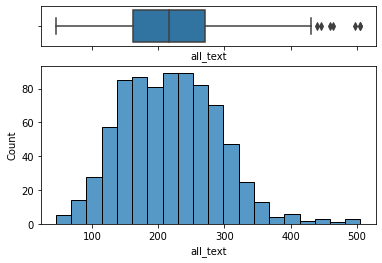

In [ ]:
word_count = final_set.all_text.str.split().str.len()

f, (ax_box, ax_hist) = plt.subplots(2, sharex=True, gridspec_kw={"height_ratios": (.20, .80)})

# assigning a graph to each ax
sns.boxplot(word_count, ax=ax_box)
sns.histplot(word_count, ax=ax_hist)

### Let's quickly look at 1 sample data

In [ ]:
final_set.all_text[2]

'Age of onset in <category=SpecificDisease>Huntington disease</category> : sex specific influence of apolipoprotein E genotype and normal CAG repeat length . Age of onset ( AO ) of <category=SpecificDisease>Huntington disease</category> ( <category=SpecificDisease>HD</category>) is known to be correlated with the length of an expanded CAG repeat in the <category=Modifier>HD</category> gene . Apolipoprotein E ( APOE ) genotype , in turn , is known to influence AO in <category=SpecificDisease>Alzheimer disease</category> , rendering the APOE gene a likely candidate to affect AO in other <category=DiseaseClass>neurological diseases</category> too . We therefore determined APOE genotype and normal CAG repeat length in the <category=Modifier>HD</category> gene for 138 <category=Modifier>HD</category> patients who were previously analysed with respect to CAG repeat length . Genotyping for APOE was performed blind to clinical information . In addition to highlighting the effect of the normal 

* The dataset contains 4 categories of entities like
    1. Modifier,
    2. SpecificDisease,
    3. DiseaseClass
    4. CompositeMention.
* But in this usecase we will only train a model to identify the <b>SpecificDisease</b>

## More Pre-processing

* The labels are mentioned in between the < category= >   < / category> tags
* We will extract the entities between <category=SpecificDisease> < / category> as labels.
* Once the labels are extracted, we will replace all the tags with spaces.

In [ ]:
def extract_disease_labels(string):

    pattern = "<category=SpecificDisease>(.*?)</category>"
    label = re.findall(pattern, string)
    label = np.unique(label).tolist()

    return label

def replace_tags(string):
    sub_list = ['<category=Modifier>',
                '<category=SpecificDisease>',
                '<category=DiseaseClass>',
                '<category=CompositeMention>',
                '</category>']
    for sub in sub_list:
        string = string.replace(sub, "")

    return string

final_set['label'] = final_set.all_text.apply(lambda x: extract_disease_labels(x))
final_set['train_text'] = final_set.all_text.apply(lambda x: replace_tags(x))
final_set

,id,all_text,label,train_text
0,10021369,"Identification of APC2, a homologue of the <ca...",[cancer],"Identification of APC2, a homologue of the ade..."
1,10051005,A common MSH2 mutation in English and North Am...,"[HNPCC, colorectal cancer, endometrial cancer,...",A common MSH2 mutation in English and North Am...
2,10051007,Age of onset in <category=SpecificDisease>Hunt...,"[Alzheimer disease, HD, Huntington disease]",Age of onset in Huntington disease : sex speci...
3,100562,<category=SpecificDisease>Familial deficiency ...,"[C7 deficiency, Complete absence of C7, Famili...",Familial deficiency of the seventh component o...
4,10064668,Increased incidence of <category=DiseaseClass>...,"[CHH, basal cell carcinoma, cartilage-hair hyp...",Increased incidence of cancer in patients with...
...,...,...,...,...
786,9949197,Distribution of emerin and lamins in the heart...,"[EDMD, Emery-Dreifuss muscular dystrophy]",Distribution of emerin and lamins in the heart...
787,9949209,Genetic mapping of the <category=Modifier>copp...,"[CT, WD, Wilson disease, copper overload, copp...",Genetic mapping of the copper toxicosis locus ...
788,9950360,Molecular analysis of the <category=Modifier>A...,"[FAP, colorectal cancer, familial adenomatous ...",Molecular analysis of the APC gene in 205 fami...
789,9973276,<category=SpecificDisease>Inherited colorectal...,"[Inherited colorectal polyposis, adenomatous p...",Inherited colorectal polyposis and cancer risk...


In [ ]:
ind = 1

print('Before preprocessing:')
print()
print(final_set.all_text[ind])
print()
print('After preprocessing')
print()
print(final_set.train_text[ind])
print()
print('Labels:')
print(final_set.label[ind])


Before preprocessing:

A common MSH2 mutation in English and North American <category=Modifier>HNPCC</category> families: origin, phenotypic expression, and sex specific differences in <category=SpecificDisease>colorectal cancer</category> . The frequency , origin , and phenotypic expression of a germline MSH2 gene mutation previously identified in seven kindreds with <category=SpecificDisease>hereditary non-polyposis cancer syndrome</category> (<category=SpecificDisease>HNPCC</category>) was investigated . The mutation ( A-- > T at nt943 + 3 ) disrupts the 3 splice site of exon 5 leading to the deletion of this exon from MSH2 mRNA and represents the only frequent MSH2 mutation so far reported . Although this mutation was initially detected in four of 33 <category=Modifier>colorectal cancer</category> families analysed from eastern England , more extensive analysis has reduced the frequency to four of 52 ( 8 % ) English <category=Modifier>HNPCC</category> kindreds analysed . In contras

In [ ]:
final_set['total_words'] = final_set.train_text.apply(lambda x : len(x.split()))
final_set

,id,all_text,label,train_text,total_words
0,10021369,"Identification of APC2, a homologue of the <ca...",[cancer],"Identification of APC2, a homologue of the ade...",190
1,10051005,A common MSH2 mutation in English and North Am...,"[HNPCC, colorectal cancer, endometrial cancer,...",A common MSH2 mutation in English and North Am...,439
2,10051007,Age of onset in <category=SpecificDisease>Hunt...,"[Alzheimer disease, HD, Huntington disease]",Age of onset in Huntington disease : sex speci...,206
3,100562,<category=SpecificDisease>Familial deficiency ...,"[C7 deficiency, Complete absence of C7, Famili...",Familial deficiency of the seventh component o...,221
4,10064668,Increased incidence of <category=DiseaseClass>...,"[CHH, basal cell carcinoma, cartilage-hair hyp...",Increased incidence of cancer in patients with...,230
...,...,...,...,...,...
786,9949197,Distribution of emerin and lamins in the heart...,"[EDMD, Emery-Dreifuss muscular dystrophy]",Distribution of emerin and lamins in the heart...,322
787,9949209,Genetic mapping of the <category=Modifier>copp...,"[CT, WD, Wilson disease, copper overload, copp...",Genetic mapping of the copper toxicosis locus ...,258
788,9950360,Molecular analysis of the <category=Modifier>A...,"[FAP, colorectal cancer, familial adenomatous ...",Molecular analysis of the APC gene in 205 fami...,253
789,9973276,<category=SpecificDisease>Inherited colorectal...,"[Inherited colorectal polyposis, adenomatous p...",Inherited colorectal polyposis and cancer risk...,272


### Defining the configuration dictionary

In [ ]:
config = {
          'MAX_LEN': 512,
          'tokenizer':BertTokenizer.from_pretrained('bert-base-uncased', do_lower_case=True),
          'batch_size':8,
          'model_name':'NER_model.h5'
         }

## Bert for Token classification
* To solve this business case of identifying the disease entities from text we will use the Token classification method HuggingFace's Transformer library
---
# What is Token classification?
---
* Each word in a sentence is split into list of words/token.
* Label the disease tokens as 1 and others as 0.
* Train the BERT model to classify each word if it's a disease.
* Since we are classifying each words in the sentence it is called Token classification

Let's look at a simple example
<br>
<b>Train sentence:</b> "The intersex differences in colorectal cancer risks have implications"


<b>Tokens:</b> ["The", "intersex", "differences", "in", "colorectal", "cancer", "risks", "have", "implications"]
<br>
<b>Token ids:</b> [1996, 6970, 3366, 2595, 5966, 1999, 3609, 22471, 2389, 4456, 10831, 2031, 13494]

<b>Label entity</b>: "colorectal cancer"
<br>
<b>Train label:</b> [O, O, O, O, B, B, O, O, O]
<br>
<b>Label:</b> [0, 0, 0, 0, 1, 1, 0, 0, 0]

- Label positions are denoted as B. However when we have to pass it to the model we will have to convert them into numerical representation

- We will convert them as follows: {'O': 0 , 'B': 1, 'P': 2}

- Similarly the input train sentence will be converted to their respective token id

- Here P means padding which is appended to our train and label when the total word count in the sentence is not equal to the mentioned MAX_LEN in config

---
## Preparing Training Data
---

In [ ]:
def clean_text(txt):
    '''
    This is text cleaning function
    '''
    return re.sub('[^A-Za-z0-9]+', ' ', str(txt).lower())


def sentence_BO_labels(sentence, labels_list):
    '''
    This function labels the training data
    '''
    matched_kwords = []
    matched_token = []
    un_matched_kwords = []
    label = []

    # Since there are many sentences which are more than 512 words,
    # Let's make the max length to be 128 words per sentence.

    sent_tokens = sent_tokenize(sentence)

    for tok in sent_tokens:
        tok = clean_text(tok)

        tok_split = config['tokenizer'].tokenize(tok)

        z = np.array(['O'] * len(tok_split)) # Create final label == len(tokens) of each sentence
        matched_keywords = 0 # Initially no kword matched

        for kword in labels_list:
            if kword in tok: #This is to first check if the keyword is in the text and then go ahead
                kword_split = config['tokenizer'].tokenize(kword)
                for i in range(len(tok_split)):
                    if tok_split[i: (i + len(kword_split))] == kword_split:
                        matched_keywords += 1

                        if (len(kword_split) == 1):
                            z[i] = 'B'
                        else:
                            z[i] = 'B'
                            z[(i+1) : (i+len(kword_split))] = 'B'

                        if matched_keywords > 1:
                            label[-1] = (z.tolist())
                            matched_token[-1] = tok
                            matched_kwords[-1].append(kword)
                        else:
                            label.append(z.tolist())
                            matched_token.append(tok)
                            matched_kwords.append([kword])
                    else:
                        un_matched_kwords.append(kword)

    return matched_token, matched_kwords, label, un_matched_kwords

In [ ]:
def labelling(dataset):
    id_list_ = []
    sentences_ = []
    key_ = []
    labels_ = []
    un_mat = []
    un_matched_reviews = 0

    for i, data in tqdm(dataset.iterrows(), total=dataset.shape[0]):
        Id = data['id']
        sentence = data['train_text']
        label_list = data['label']

        s, k, l, unmatched = sentence_BO_labels(sentence=sentence, labels_list=label_list)

        if len(s) == 0:
            un_matched_reviews += 1
            un_mat.append(unmatched)
        else:
            sentences_.append(s)
            key_.append(k)
            labels_.append(l)
            id_list_.append([Id]*len(l))

    print("Total unmatched keywords:", un_matched_reviews)
    sentences = [item for sublist in sentences_ for item in sublist]
    final_labels = [item for sublist in labels_ for item in sublist]
    keywords = [item for sublist in key_ for item in sublist]
    Id_list = [item for sublist in id_list_ for item in sublist]

    return sentences, final_labels, keywords, Id_list

### Pad the shorter sentences

In [ ]:
tags_2_idx = {'O': 0 , 'B': 1, 'P': 2} # 'P' means padding.

def pad_seq_label(sentence, labels):

    padded_tok_sent = []
    padded_sent_ids = []
    padded_tok_type_id = []
    padded_att_mask = []
    padded_labels = []

    for (sent, label) in tqdm(zip(sentence, labels), total=len(labels)):

        tok_sent = config['tokenizer'].tokenize(sent)
        tok_sent_len = len(tok_sent)
        pad_len = config['MAX_LEN'] - tok_sent_len

        # Forming the inputs
        sent_ids = config['tokenizer'].convert_tokens_to_ids(tok_sent)
        sent_tok_type_id = [0] * tok_sent_len
        sent_att_mask = [1] * tok_sent_len

        # Padding
        tok_sent = tok_sent + (['<pad>']*pad_len)
        sent_ids = sent_ids + [0]*pad_len
        sent_tok_type_id = sent_tok_type_id + [0]*pad_len
        sent_att_mask = sent_att_mask + [0]*pad_len
        label = label + (['P']*pad_len)
        label = list(map(tags_2_idx.get, label))

        # Appending all the inputs
        padded_tok_sent.append(tok_sent)
        padded_sent_ids.append(sent_ids)
        padded_tok_type_id.append(sent_tok_type_id)
        padded_att_mask.append(sent_att_mask)
        padded_labels.append(label)

    return padded_tok_sent, padded_sent_ids, padded_tok_type_id, padded_att_mask, padded_labels


## Install NLTK

In [ ]:
import nltk
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [ ]:
train_sentences, train_labels, train_keywords, train_Id_list = labelling(dataset = final_set)

print("")
print(f" train sentences: {len(train_sentences)}, train label: {len(train_labels)}, train keywords: {len(train_keywords)}, train_id list: {len(train_Id_list)}")

train_tok_sent, train_sent_ids, train_tok_type_id, train_att_mask, train_labels = pad_seq_label(sentence=train_sentences, labels=train_labels)

100%|██████████| 791/791 [00:09<00:00, 84.12it/s] 


Total unmatched keywords: 301

 train sentences: 1410, train label: 1410, train keywords: 1410, train_id list: 1410


100%|██████████| 1410/1410 [00:00<00:00, 1437.89it/s]


### Let's look at a sample of the sentence_id, tok_id, attention_mask_id

In [ ]:
ind = 10
print("Sentence")
print(train_sentences[ind])
print()
print("Tokenized sentence")
print(train_tok_sent[ind])
print()
print("Sentence Id")
print(train_sent_ids[ind])
print()
print("Token Type id")
print(train_tok_type_id[ind])
print()
print("Token att mask id")
print(train_att_mask[ind])
print()
print("Label")
print(train_labels[ind])

Sentence
complete absence of c7 was also found in one sibling who had the clinical syndrome of meningococcal meningitis and arthritis as a child and in this siblings clinically well eight year old son 

Tokenized sentence
['complete', 'absence', 'of', 'c', '##7', 'was', 'also', 'found', 'in', 'one', 'sibling', 'who', 'had', 'the', 'clinical', 'syndrome', 'of', 'men', '##ing', '##oco', '##cca', '##l', 'men', '##ing', '##itis', 'and', 'arthritis', 'as', 'a', 'child', 'and', 'in', 'this', 'siblings', 'clinical', '##ly', 'well', 'eight', 'year', 'old', 'son', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>', '<pad>

### Why are the Token Type Ids all labelled as 0?
* Token type ids are used to identify the 2 sentences when we are training a next sentence classification or QnA task where tokens in sentence A is 0 and tokens in sentence B is 1.
* Since we are working on Token classification we can leave all the values to be 0. Sometime the token type id is also skipped when not training task involving 2 sentence relationship

### Token Attention Mask Id
* All the tokens from the sentence are marked as 1 and the padded tokens are marked as 0.
* The reason is we want the attention heads to pay attention only to the token in the sentences and not the padded tokens.

In [ ]:
df = pd.DataFrame({'id':train_Id_list,
                   'sentences':train_sentences,
                   'keywords': train_keywords,
                   'sentences_tok':train_tok_sent,
                   'sentences_id': train_sent_ids,
                   'sentences_tok_type_id': train_tok_type_id,
                   'sentences_att_mask': train_att_mask,
                   'labels': train_labels})
df

,id,sentences,keywords,sentences_tok,sentences_id,sentences_tok_type_id,sentences_att_mask,labels
0,10021369,apc and apc2 may therefore have comparable fun...,[cancer],"[ap, ##c, and, ap, ##c, ##2, may, therefore, h...","[9706, 2278, 1998, 9706, 2278, 2475, 2089, 356...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, ..."
1,10051005,a common msh2 mutation in english and north am...,[colorectal cancer],"[a, common, ms, ##h, ##2, mutation, in, englis...","[1037, 2691, 5796, 2232, 2475, 16221, 1999, 23...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
2,10051005,although this mutation was initially detected ...,[colorectal cancer],"[although, this, mutation, was, initially, det...","[2348, 2023, 16221, 2001, 3322, 11156, 1999, 2...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, ..."
3,10051005,to investigate the origin of this mutation in ...,[colorectal cancer],"[to, investigate, the, origin, of, this, mutat...","[2000, 8556, 1996, 4761, 1997, 2023, 16221, 19...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...","[0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, ..."
4,10051005,for both sexes combined the penetrances at age...,[colorectal cancer],"[for, both, sexes, combined, the, pen, ##et, #...","[2005, 2119, 21024, 4117, 1996, 7279, 3388, 21...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
...,...,...,...,...,...,...,...,...
1405,9973276,we conclude that the apc i1307k variant leads ...,[colorectal cancer],"[we, conclude, that, the, ap, ##c, i, ##13, ##...","[2057, 16519, 2008, 1996, 9706, 2278, 1045, 17...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
1406,9973276,the estimated relative risk for carriers may j...,[colorectal cancer],"[the, estimated, relative, risk, for, carriers...","[1996, 4358, 5816, 3891, 2005, 11363, 2089, 16...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
1407,9988281,these reagents detect a 220 kd protein localiz...,[breast malignancies],"[these, re, ##age, ##nts, detect, a, 220, k, #...","[2122, 2128, 4270, 7666, 11487, 1037, 10545, 1...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
1408,9988281,immunohistochemical staining of human breast s...,[ductal carcinomas],"[im, ##mun, ##oh, ##isto, ##chemical, stain, #...","[10047, 23041, 11631, 20483, 15869, 21101, 207...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."


## Splitting the data into train and validation

In [ ]:
train_df, valid_df = train_test_split(df, test_size=0.2, random_state=100)

train_df, valid_df = train_df.reset_index(drop=True), valid_df.reset_index(drop=True)

train_df.shape, valid_df.shape

((1128, 8), (282, 8))

In [ ]:
train_sent_id = np.array(train_df.sentences_id.tolist())
train_tok_type_id = np.array(train_df.sentences_tok_type_id.tolist())
train_att_mask = np.array(train_df.sentences_att_mask.tolist())
train_label = np.array(train_df.labels.tolist())

valid_sent_id = np.array(valid_df.sentences_id.tolist())
valid_tok_type_id = np.array(valid_df.sentences_tok_type_id.tolist())
valid_att_mask = np.array(valid_df.sentences_att_mask.tolist())
valid_label = np.array(valid_df.labels.tolist())

print(train_sent_id.shape, train_tok_type_id.shape, train_att_mask.shape ,train_label.shape)
print(valid_sent_id.shape, valid_tok_type_id.shape, valid_att_mask.shape ,valid_label.shape)


(1128, 512) (1128, 512) (1128, 512) (1128, 512)
(282, 512) (282, 512) (282, 512) (282, 512)


---
## How will we train our model?
---
* We use the Bert-base-uncased pretrained model with the help of BertForTokenClassification class
* On top of the pretrained architecture we have added a 3 output neuron Dense layer with SoftMax

Do you want to guess why 3 Neurons on the output?

In [ ]:
encoder = TFBertForTokenClassification.from_pretrained("bert-base-uncased", output_hidden_states=True)

# NER Model
input_ids = Input(shape=(config['MAX_LEN'],), dtype=tf.int32)
token_type_ids = Input(shape=(config['MAX_LEN'],), dtype=tf.int32)
attention_mask = Input(shape=(config['MAX_LEN'],), dtype=tf.int32)

embedding = encoder(input_ids,
                    token_type_ids=token_type_ids,
                    attention_mask=attention_mask
                   )[0]
output_logits = Dense(len(tags_2_idx), activation='softmax')(embedding)

model = Model(inputs=[input_ids, token_type_ids, attention_mask],
              outputs=[output_logits]
             )
optimizer = Adam(learning_rate=3e-5)
loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True)

model.compile(optimizer=optimizer, loss=loss, metrics=['accuracy'])

All model checkpoint layers were used when initializing TFBertForTokenClassification.

Some layers of TFBertForTokenClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 512)]        0           []                               
                                                                                                  
 input_3 (InputLayer)           [(None, 512)]        0           []                               
                                                                                                  
 input_2 (InputLayer)           [(None, 512)]        0           []                               
                                                                                                  
 tf_bert_for_token_classificati  TFTokenClassifierOu  108893186  ['input_1[0][0]',                
 on (TFBertForTokenClassificati  tput(loss=None, log              'input_3[0][0]',            

In [ ]:
%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

In [ ]:
import datetime

log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1, profile_batch = 5)
model_name = "./model_512d_{epoch:03d}.h5"

save_model = tf.keras.callbacks.ModelCheckpoint(filepath=model_name,
                                                save_weights_only=True,
                                                save_best_only=True,
                                                verbose=1)

history = model.fit([train_sent_id,
                     train_tok_type_id,
                     train_att_mask],
                    train_label,
                    epochs=5,
                    validation_data=([valid_sent_id,
                                      valid_tok_type_id,
                                      valid_att_mask],
                                     valid_label),
                    batch_size=config['batch_size'],
                    callbacks=[save_model, tensorboard_callback]
                   )

Epoch 1/5


/usr/local/lib/python3.8/dist-packages/tensorflow/python/util/dispatch.py:1082: UserWarning: "`sparse_categorical_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  return dispatch_target(*args, **kwargs)


141/141 [==============================] - ETA: 0s - loss: 0.1983 - accuracy: 0.9661
Epoch 1: val_loss improved from inf to 0.06708, saving model to ./model_512d_001.h5
141/141 [==============================] - 185s 1s/step - loss: 0.1983 - accuracy: 0.9661 - val_loss: 0.0671 - val_accuracy: 0.9896
Epoch 2/5
141/141 [==============================] - ETA: 0s - loss: 0.0595 - accuracy: 0.9925
Epoch 2: val_loss improved from 0.06708 to 0.04097, saving model to ./model_512d_002.h5
141/141 [==============================] - 174s 1s/step - loss: 0.0595 - accuracy: 0.9925 - val_loss: 0.0410 - val_accuracy: 0.9966
Epoch 3/5
141/141 [==============================] - ETA: 0s - loss: 0.0381 - accuracy: 0.9967
Epoch 3: val_loss improved from 0.04097 to 0.02959, saving model to ./model_512d_003.h5
141/141 [==============================] - 167s 1s/step - loss: 0.0381 - accuracy: 0.9967 - val_loss: 0.0296 - val_accuracy: 0.9970
Epoch 4/5
141/141 [==============================] - ETA: 0s - loss: 

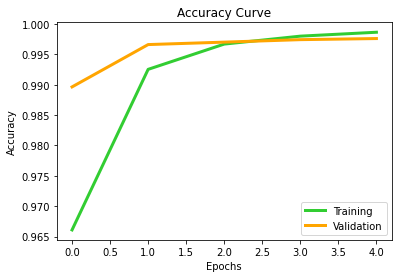

In [ ]:
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.title("Accuracy Curve")
plt.plot(history.history['accuracy'],linewidth=3,color='limegreen')
plt.plot(history.history['val_accuracy'],linewidth=3,color='orange')  # Plot the chart
plt.legend(["Training", "Validation"], loc ="lower right")

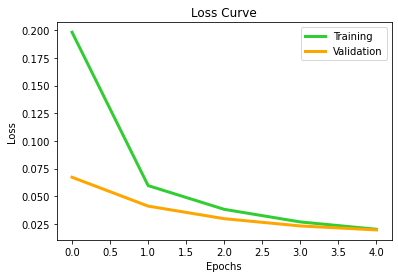

In [ ]:
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Loss Curve")
plt.plot(history.history['loss'],linewidth=3,color='limegreen')
plt.plot(history.history['val_loss'],linewidth=3,color='orange')  # Plot the chart
plt.legend(["Training", "Validation"], loc ="upper right")

### Get the Prediction

* The prediction for each input will be of shape (Num_inputs, Max_len, total output)
* The output axis is the probabilities of the token belonging to 0, 1 or 2.
    * 0 - Non disease token
    * 1 - Disease token
    * 2 - Padded token
* We take the argmax along the axis=2, which results in a shape of (Num_inputs, Max_len)
* Let's look at a sample prediction output


In [ ]:
# Load the trained model
model.load_weights('./model_512d_004.h5')

In [ ]:
validation_predictions = model.predict([valid_sent_id,
                                        valid_tok_type_id,
                                        valid_att_mask])
validation_predictions_prob = validation_predictions.argmax(axis=2)

print(validation_predictions.shape)

9/9 [==============================] - 15s 1s/step
(282, 512, 3)


In [ ]:
validation_predictions_prob[0]

array([0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,

### Let's get the disease tokens/phrase
* Now that we have the prediction for each sentence from the validation,we will have to get the corresponding tokens
* As we saw above the predictions are either 0, 1 or 2. So all predictions corresponding to 1 are the predicted keywords
* Given a input sentence we map the corresponding position of prediction==1 which is the Disease class we are interested in.
* Let's look at a example

Input sentence: 'the risk of colorectal cancer was significantly higher, for females there was a high risk of endometrial cancer'
<br>
token sentence: ['the', 'risk', 'of', 'color', '##ect', '##al', 'cancer', 'was', 'significantly', 'higher', ',', 'for', 'females', 'there', 'was', 'a', 'high', 'risk', 'of', 'end', '##ome', '##tri', '##al', 'cancer', '< PAD >'......'< PAD >']
<br>
Prediction: [0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 2......2]
<br>
$\;\;\;\;\;\;\;\;\;\;\;\;$ => [['color', '##ect', '##al', 'cancer'], ['end', '##ome', '##tri', '##al', 'cancer']]
<br>
$\;\;\;\;\;\;\;\;\;\;\;\;$ => "colorectal cancer"

In [ ]:
def get_predicted_entities(all_prediction, sub_sentence):

    final_kwords = []
    for i, prediction in enumerate(all_prediction):
        tkns = sub_sentence[i]
        kword = ''
        kword_list = []

        for k, j in enumerate(prediction):
            if (len(prediction)>1):
                if (j==1) & (k==0):
                    # If it's the first word in the first position
                    begin = tkns[k]
                    kword = begin
                elif (j==1) & (k>=1) & (prediction[k-1]==0):
                    # Begin word is in the middle of the sentence
                    begin = tkns[k]
                    previous = tkns[k-1]

                    if begin.startswith('##'):
                        kword = previous + begin[2:]
                    else:
                        kword = begin

                    if k == (len(prediction) - 1):
                        kword_list.append(kword.rstrip().lstrip())
                elif (j==1) & (k>=1) & (prediction[k-1]!=0):
                    # Intermediate word of the same keyword
                    inter = tkns[k]

                    if inter.startswith('##'):
                        kword = kword + "" + inter[2:]
                    else:
                        kword = kword + " " + inter


                    if k == (len(prediction) - 1):
                        kword_list.append(kword.rstrip().lstrip())
                elif (j==0) & (k>=1) & (prediction[k-1] !=0):
                    # End of a keywords but not end of sentence.
                    kword_list.append(kword.rstrip().lstrip())
                    kword = ''
                    inter = ''
            else:
                if (j!=0):
                    begin = tkns[k]
                    kword = begin
                    kword_list.append(kword.rstrip().lstrip())

        final_kwords.append(kword_list)
    return final_kwords

In [ ]:
validation_predictions= get_predicted_entities(all_prediction = validation_predictions_prob,
                                               sub_sentence = valid_df.sentences_tok.values)
valid_df['prediction'] = validation_predictions
valid_df.head(10)

,id,sentences,keywords,sentences_tok,sentences_id,sentences_tok_type_id,sentences_att_mask,labels,prediction
0,10807385,conclusions although brca associated hereditar...,"[hereditary ovarian cancers, ovarian cancers]","[conclusions, although, br, ##ca, associated, ...","[15306, 2348, 7987, 3540, 3378, 14800, 1051, 1...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...","[0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, ...","[hereditary ovarian cancers, sporadic cancers,..."
1,1717985,piebaldism in this family thus appears to be t...,[piebaldism],"[pie, ##baldi, ##sm, in, this, family, thus, a...","[11345, 28807, 6491, 1999, 2023, 2155, 2947, 3...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...","[1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",[piebaldi]
2,2055114,the human gene for histidase histidine ammonia...,[histidinemia],"[the, human, gene, for, his, ##ti, ##das, ##e,...","[1996, 2529, 4962, 2005, 2010, 3775, 8883, 206...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",[histidinemia]
3,9425239,the genetic basis of myotonic dystrophy dm is ...,[myotonic dystrophy],"[the, genetic, basis, of, my, ##oton, ##ic, d,...","[1996, 7403, 3978, 1997, 2026, 25862, 2594, 10...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...","[0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, ...",[myotonic dystrophy]
4,7939630,the brca1 region is also subject to allelic lo...,[sporadic breast and ovarian cancers],"[the, br, ##ca, ##1, region, is, also, subject...","[1996, 7987, 3540, 2487, 2555, 2003, 2036, 339...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, ...",[ovarian cancers]
5,2055114,the localization of histidase to mouse chromos...,[histidinemia],"[the, local, ##ization, of, his, ##ti, ##das, ...","[1996, 2334, 3989, 1997, 2010, 3775, 8883, 206...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",[histidinemia]
6,1302003,aberrant splicing of the chm gene is a signifi...,[choroideremia],"[abe, ##rran, ##t, sp, ##lic, ##ing, of, the, ...","[14863, 28327, 2102, 11867, 10415, 2075, 1997,...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",[]
7,7761412,lowe syndrome also known as oculocerebrorenal ...,[oculocerebrorenal syndrome],"[lowe, syndrome, also, known, as, o, ##cu, ##l...","[14086, 8715, 2036, 2124, 2004, 1051, 10841, 4...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...","[0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, ...",[oculocerebrorenal syndrome]
8,1978564,a genetic linkage map of six polymorphic dna m...,[familial adenomatous polyposis],"[a, genetic, link, ##age, map, of, six, poly, ...","[1037, 7403, 4957, 4270, 4949, 1997, 2416, 265...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",[familial adenomatous polyposis]
9,9931324,here we present four novel pax6 missense mutat...,"[aniridia, congenital nystagmus, displaced pup...","[here, we, present, four, novel, pa, ##x, ##6,...","[2182, 2057, 2556, 2176, 3117, 6643, 2595, 257...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[ectopia pupillae displaced pupils, congenital..."
